# TFT SIMPLE MODELS
This notebook presents the code corresponding to the training of the TFT model without covariates from Darts. Two models have been trained, one with MinMax scaling and the other with Standard scaling.

After training, both models are evaluated using their respective test sets, and the MinMax model is also evaluated with the specific test set.

In [4]:
# We install darts
!pip install u8darts[torch] --quiet

In [5]:
from google.colab import drive
drive.mount('/content/drive')

# Necessary imports
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.models import TFTModel
from darts.dataprocessing.transformers import Scaler
import torch
from darts.utils.likelihood_models import QuantileRegression
from darts import concatenate, metrics

# We can ignore Darts library warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
import joblib

# Load the saved data
loaded_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_train_standard.pkl')

# We extract the components
scaled_train_series = loaded_data['train']        # dict of TimeSeries objects
scaled_val_series = loaded_data['validation']     # dict of TimeSeries objects
scalers = loaded_data['scalers']                  # dict of Scaler objects

# We sort by meter IDs
meter_ids = sorted(scaled_train_series.keys())

# We build aligned lists
train_series_scaled = [scaled_train_series[meter_id] for meter_id in meter_ids]
val_series_scaled = [scaled_val_series[meter_id] for meter_id in meter_ids]

print(f"Loaded {len(train_series_scaled)} time series for training.")
print(f"Loaded {len(val_series_scaled)} time series for validation.")

Loaded 908 time series for training.
Loaded 908 time series for validation.


In [ ]:
quantiles = [0.05, 0.5, 0.95]

from pytorch_lightning.callbacks import EarlyStopping

early_stopping_callback = EarlyStopping(
    monitor="val_loss",
    patience=10,
    mode="min",
    verbose=True
)

tft_model = TFTModel(
    input_chunk_length=60,
    output_chunk_length=7,
    n_epochs=20,
    likelihood=QuantileRegression(quantiles=quantiles),
    add_relative_index=True,
    save_checkpoints=True,
    model_name="tft_water_model",
    pl_trainer_kwargs={
        "accelerator": "gpu",
        "devices": 1,
        "callbacks": [early_stopping_callback]
    }
)

In [ ]:
tft_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
   | Name                              | Type                             | Params | Mode 
------------------------------------------------------------------------------------------------
0  | train_metrics                     | MetricCollection                 | 0      | train
1  | val_metrics                       | MetricCollection                 | 0      | train
2  | input_embeddings                  | _MultiEmbedding                  | 0      | train
3  | static_covariates_vsn             | _VariableSelectionNetwork        | 0      | train
4  | encoder_vsn                       | _VariableSelectionNetwork      

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.478


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.023 >= min_delta = 0.0. New best score: 0.455


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.024 >= min_delta = 0.0. New best score: 0.431


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.008 >= min_delta = 0.0. New best score: 0.423


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0. New best score: 0.423


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0. New best score: 0.422


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.002 >= min_delta = 0.0. New best score: 0.420
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


TFTModel(output_chunk_shift=0, hidden_size=16, lstm_layers=1, num_attention_heads=4, full_attention=False, feed_forward=GatedResidualNetwork, dropout=0.1, hidden_continuous_size=8, categorical_embedding_sizes=None, add_relative_index=True, loss_fn=None, likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95], prior_strength=1.0), norm_type=LayerNorm, use_static_covariates=True, input_chunk_length=60, output_chunk_length=7, n_epochs=20, save_checkpoints=True, model_name=tft_water_model, pl_trainer_kwargs={'accelerator': 'gpu', 'devices': 1, 'callbacks': [<pytorch_lightning.callbacks.early_stopping.EarlyStopping object at 0x7bb94632f650>]})

In [ ]:
!mkdir -p "/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/TFT_standard_checkpoint/"
!cp -r /content/darts_logs/tft_water_model "/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/TFT_standard_checkpoint/"


In [ ]:
tft_model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/TFT_model_standard.pkl")

In [ ]:
# Load model from saved checkpoint
tft_model = TFTModel.load_from_checkpoint("tft_water_model")

# Resume training
tft_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/darts_logs/tft_water_model/checkpoints exists and is not empty.
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at /content/darts_logs/tft_water_model/checkpoints/best-epoch=9-val_loss=0.06.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
   | Name                              | Type                             | Params | Mode 
------------------------------------------------------------------------------------------------
0  | train_criterion                   | MSELoss                          | 0    

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0. New best score: 0.063


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0. New best score: 0.063


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0. New best score: 0.063


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


TFTModel(output_chunk_shift=0, hidden_size=16, lstm_layers=1, num_attention_heads=4, full_attention=False, feed_forward=GatedResidualNetwork, dropout=0.1, hidden_continuous_size=8, categorical_embedding_sizes=None, add_relative_index=True, loss_fn=None, likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95], prior_strength=1.0), norm_type=LayerNorm, use_static_covariates=True, input_chunk_length=60, output_chunk_length=7, n_epochs=20, save_checkpoints=True, model_name=tft_water_model, pl_trainer_kwargs={'accelerator': 'gpu', 'devices': 1, 'callbacks': [<pytorch_lightning.callbacks.early_stopping.EarlyStopping object at 0x7f25483e9390>]})

In [ ]:
# Let's load the model
from darts.models import TFTModel

# Load the trained GRU model
tft_model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/TFT_model.pkl")

In [ ]:
# Let's train more epochs, because we ran out of GPU
tft_model.n_epochs = 15  # new number of epochs for this round
tft_model.force_reset = False  # prevent reinitialization
tft_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

In [ ]:
tft_model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/TFT_model.pkl")

In [7]:
###################################### TRAINING DONE, NOW WE WILL TEST THE MODELS #################################

# We start with the Min Max 0-1 Scaling

In [10]:
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [11]:
# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.928571  20.057301


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9  0.892857  31.092031


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  4.021616


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  2.472487


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  3.267746


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width
0       0.9  0.357143  2.150315


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.003125


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903006_Barcelona:
    Interval  Coverage    Width
0       0.9  0.767857  2.80788


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.834071


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.974622


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903048_Barcelona:
    Interval  Coverage    Width
0       0.9  0.982143  6.32576


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  4.188273


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  1.018588


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903081_Barcelona:
    Interval  Coverage    Width
0       0.9  0.839286  2.33054


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.535714  5.652462


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  4.329956


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.928571  25.453115


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  6.231265


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801906002_Barcelona:
    Interval  Coverage    Width
0       0.9     0.875  2.89702


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  6.973963


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801906041_Barcelona:
    Interval  Coverage      Width
0       0.9  0.982143  10.123962


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width
0       0.9       1.0  4.612458


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  2.794332


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  2.242823


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  9.007113


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  4.362916


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9      0.75  9.511467


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.178571  6.074444


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907115_Barcelona:
    Interval  Coverage      Width
0       0.9  0.964286  19.959977


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  4.017574


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  2.782607


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  0.817527


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  2.690371


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908049_Barcelona:
    Interval  Coverage    Width
0       0.9  0.928571  15.1613


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  1.247947


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  5.340699


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.553571  9.095901


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9  0.142857  3.516018


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width
0       0.9  0.982143  9.502961


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  6.199533


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910054_Barcelona:
    Interval  Coverage    Width
0       0.9  0.660714  2.03691


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.678571  1.165482


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9  0.589286  1.142331


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width
0       0.9  0.589286  0.922605


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  0.804829


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.928571  7.36696


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  4.886789


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.660714  6.226475


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  2.745513


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  5.105358


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.910714  14.625683


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  9.089554


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  5.318851


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.706951


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.021713


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  7.557761


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  6.008296


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  2.649741


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  3.017163


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  2.116415


In [12]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8393
Mean Width: 5.8443


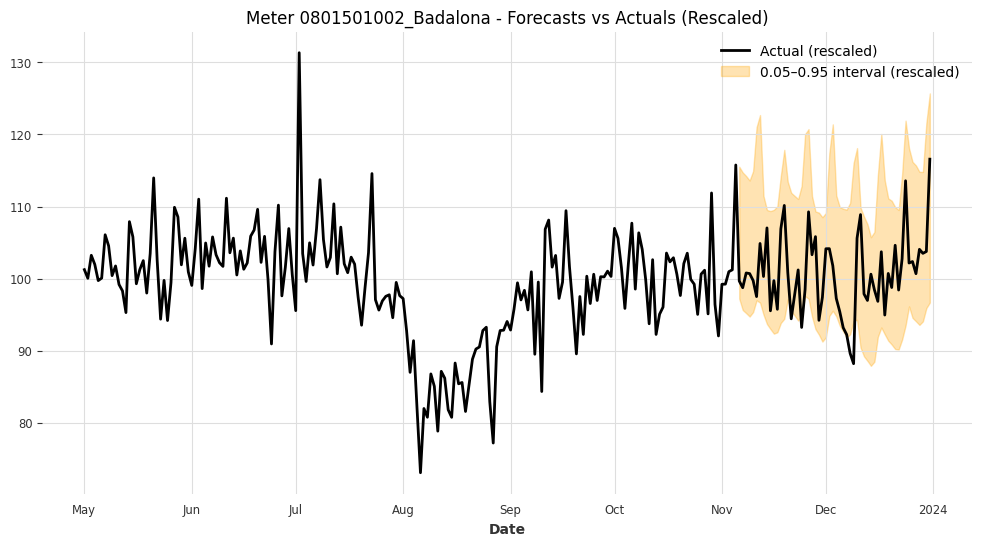

Meter 0801501002_Badalona - Coverage: 0.9286, Mean Interval Width (rescaled): 20.0573



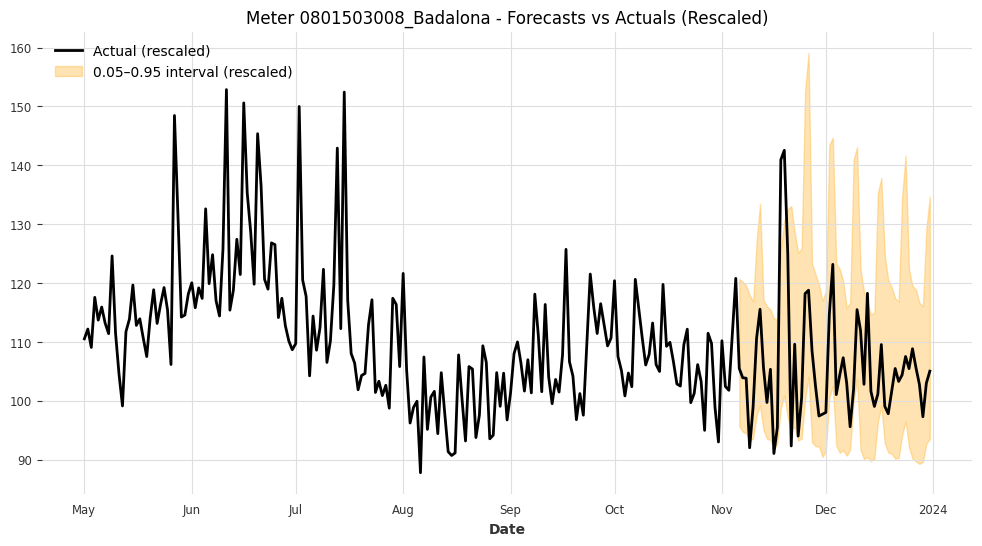

Meter 0801503008_Badalona - Coverage: 0.8929, Mean Interval Width (rescaled): 31.0920



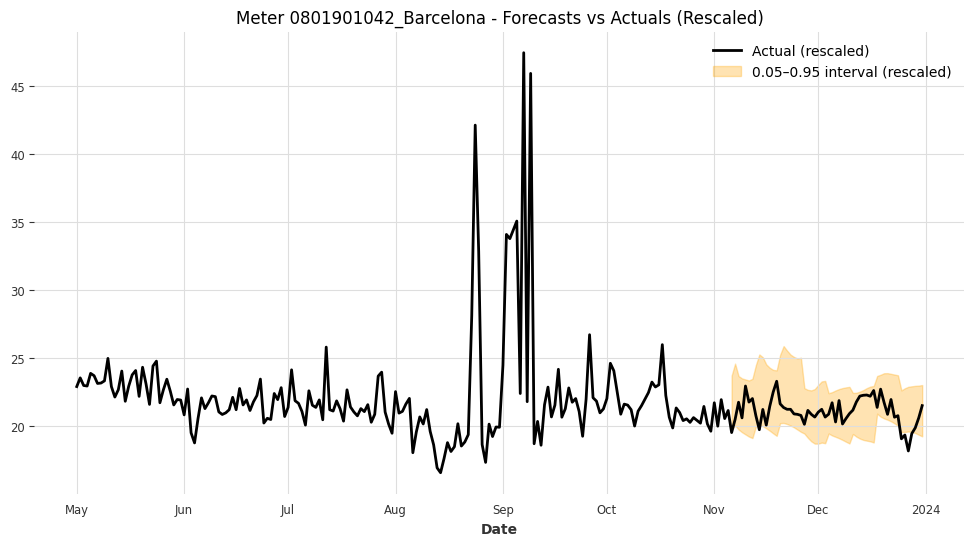

Meter 0801901042_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 4.0216



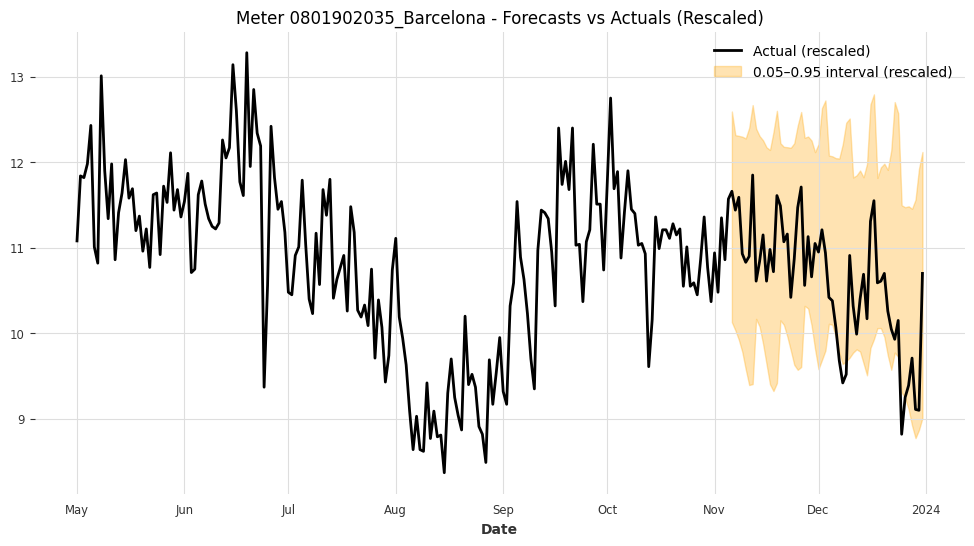

Meter 0801902035_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 2.4725



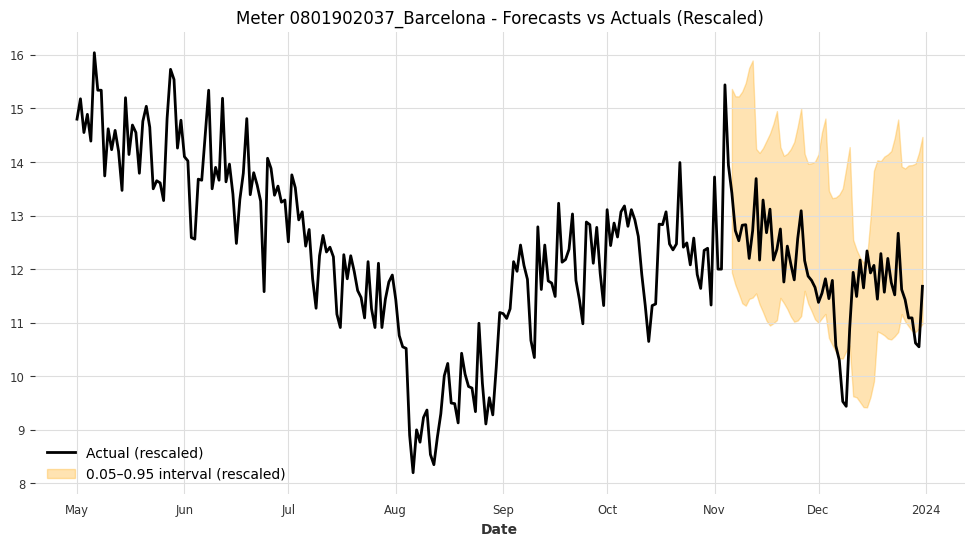

Meter 0801902037_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.2677



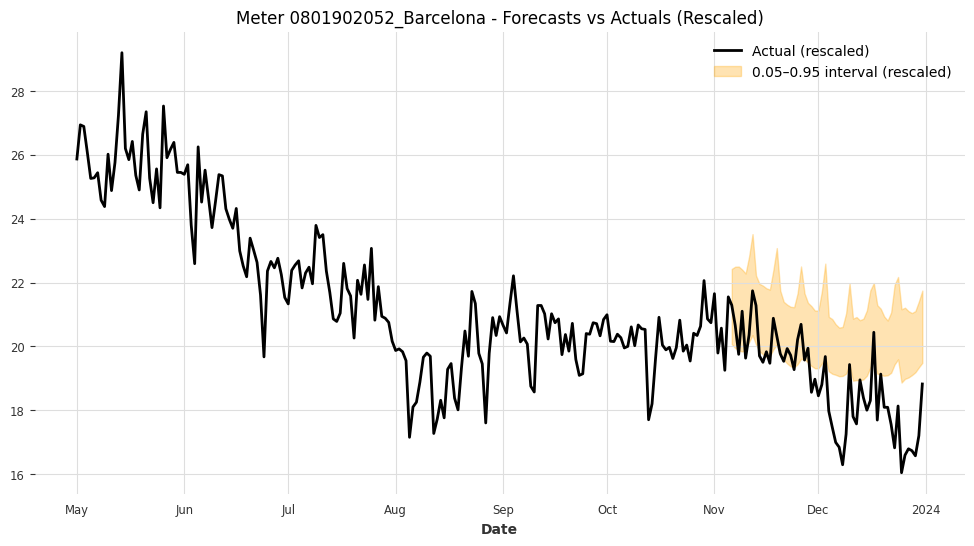

Meter 0801902052_Barcelona - Coverage: 0.3571, Mean Interval Width (rescaled): 2.1503



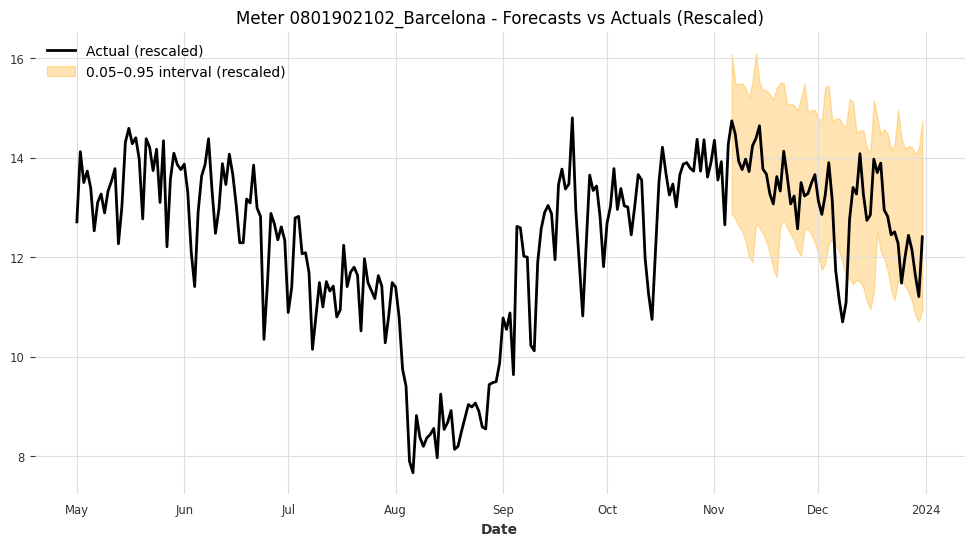

Meter 0801902102_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.0031



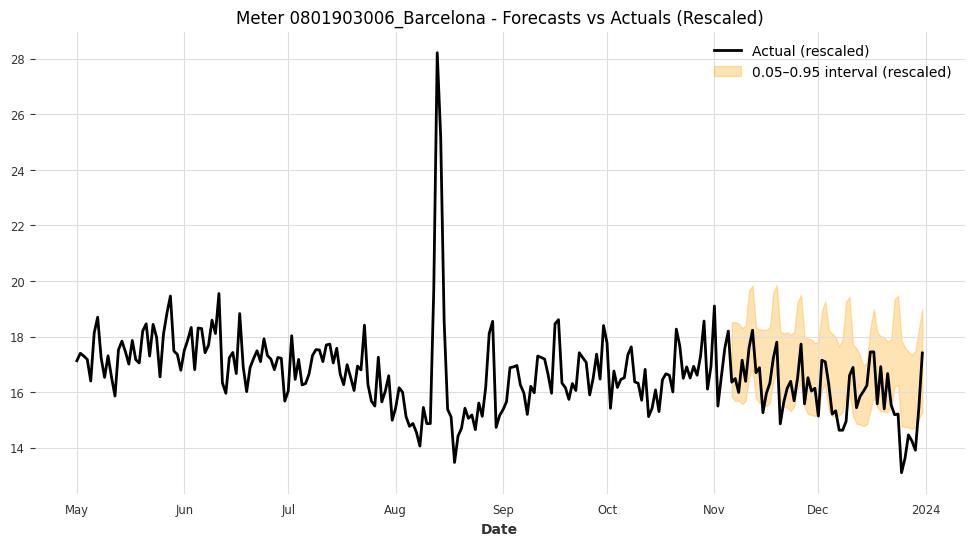

Meter 0801903006_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 2.8079



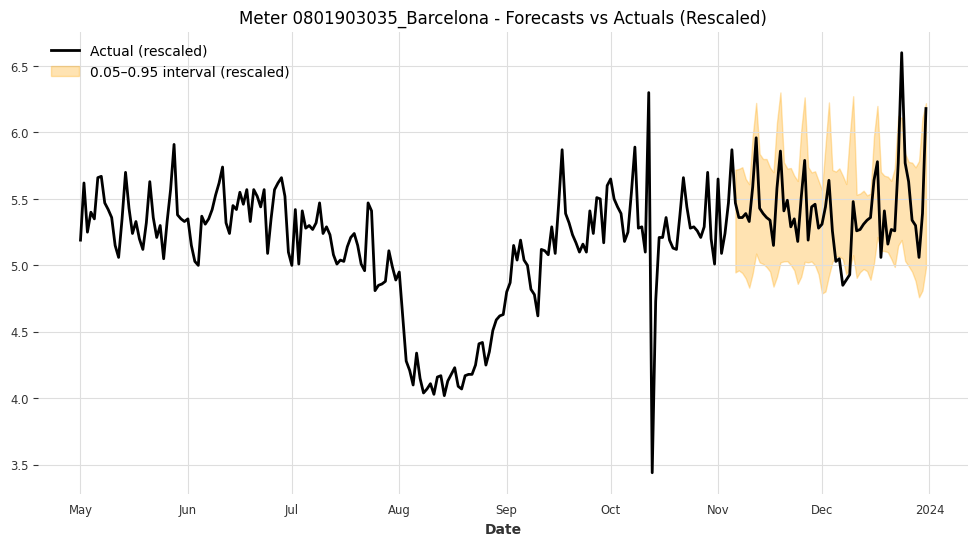

Meter 0801903035_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.8341



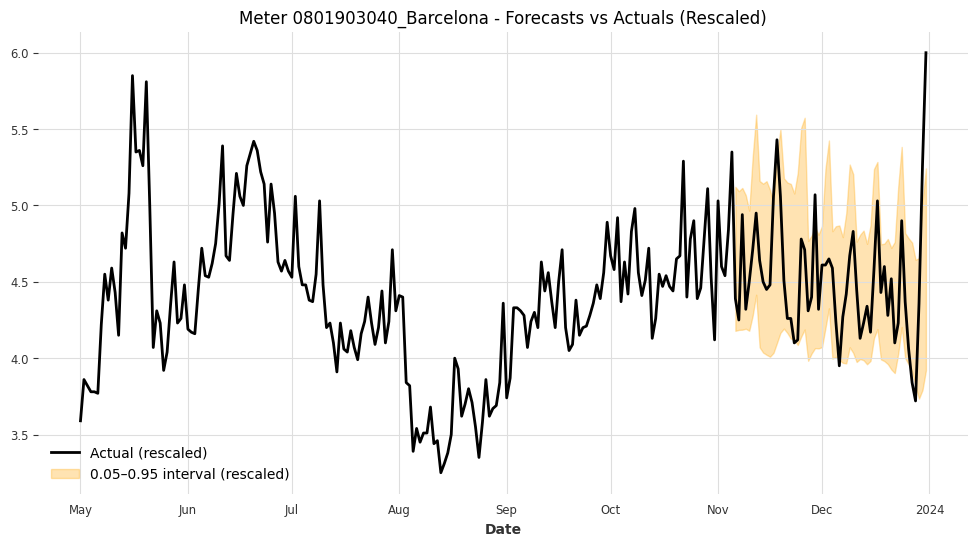

Meter 0801903040_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.9746



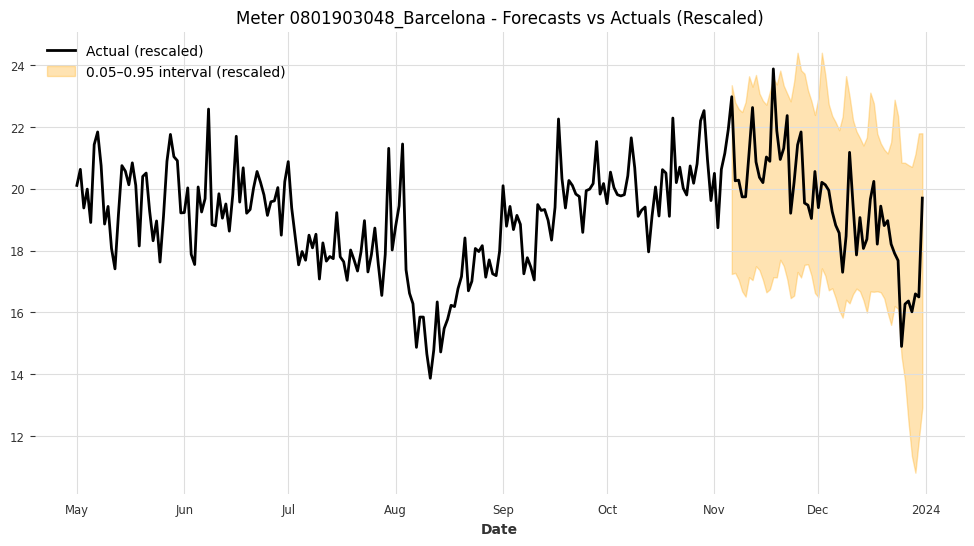

Meter 0801903048_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 6.3258



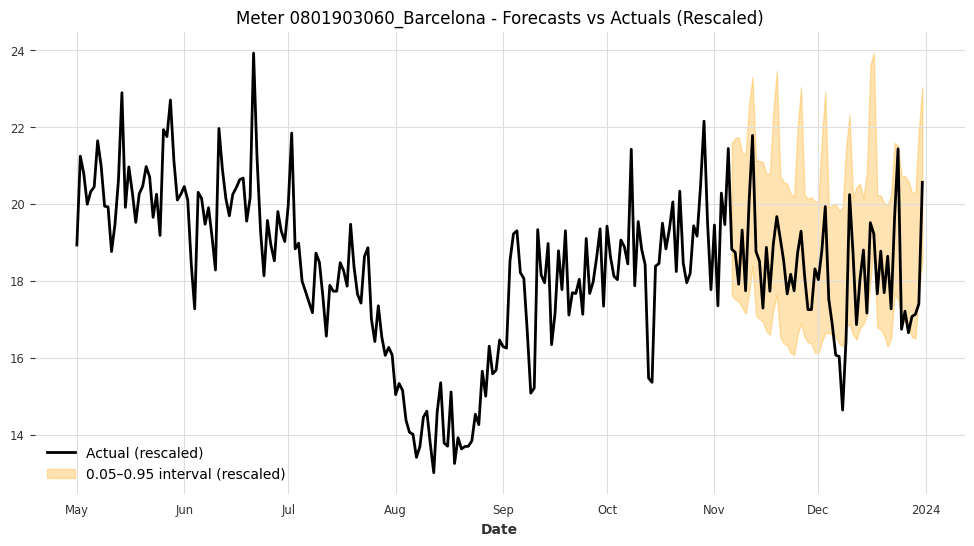

Meter 0801903060_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 4.1883



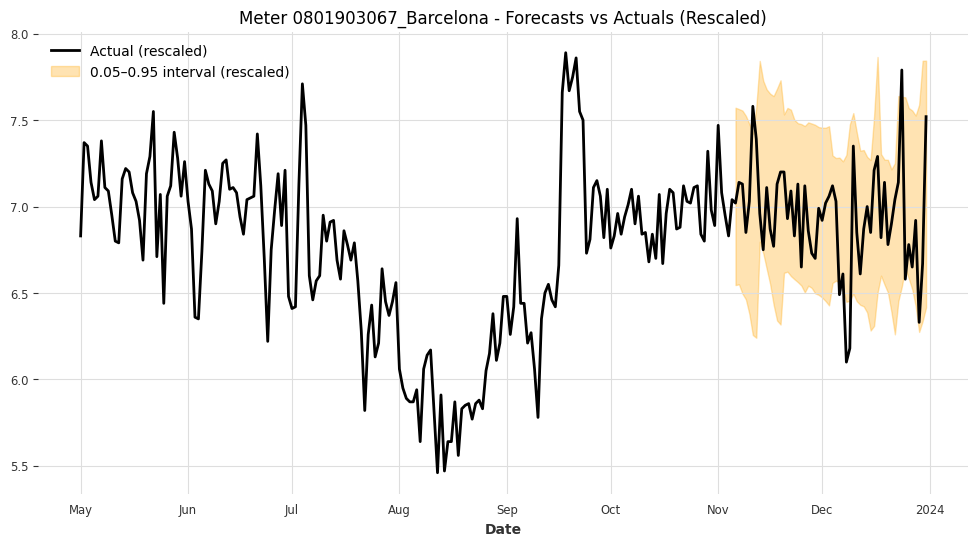

Meter 0801903067_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 1.0186



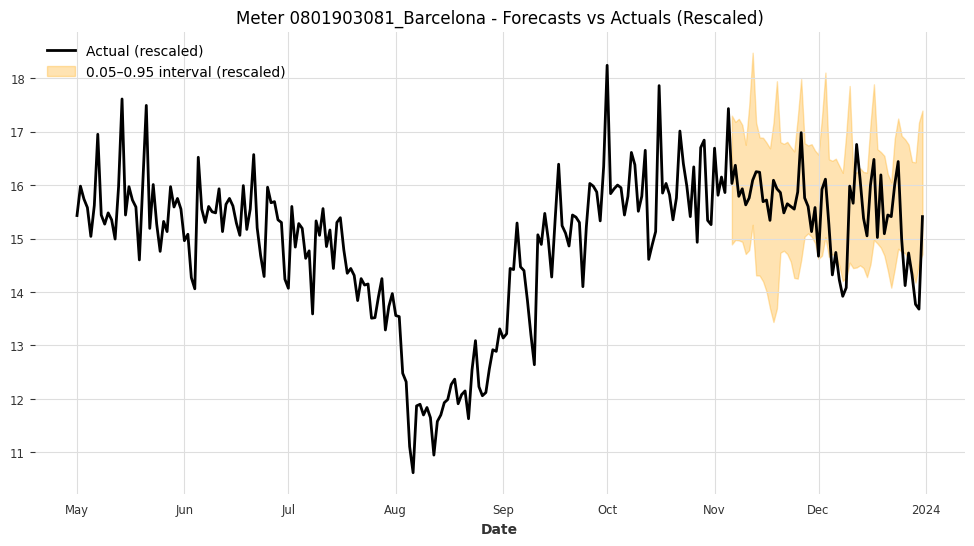

Meter 0801903081_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.3305



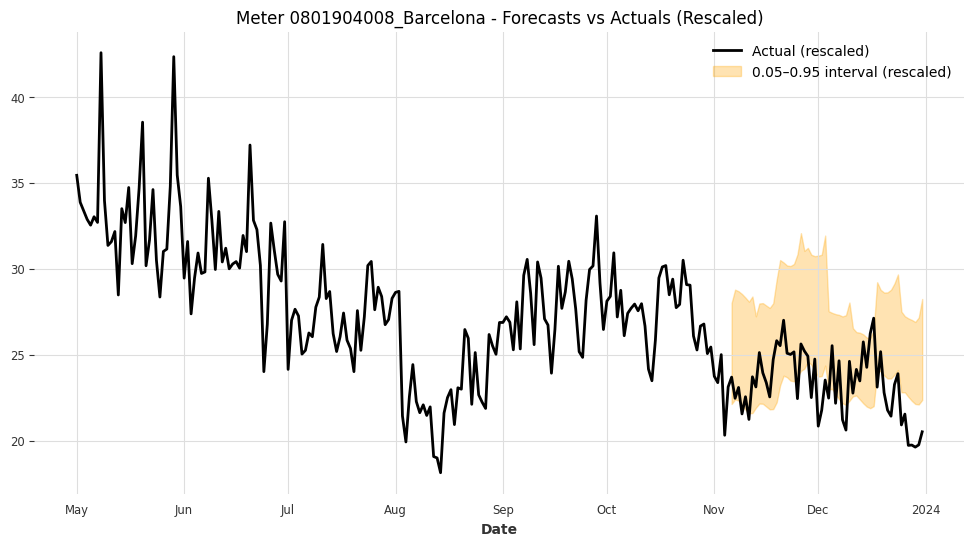

Meter 0801904008_Barcelona - Coverage: 0.5357, Mean Interval Width (rescaled): 5.6525



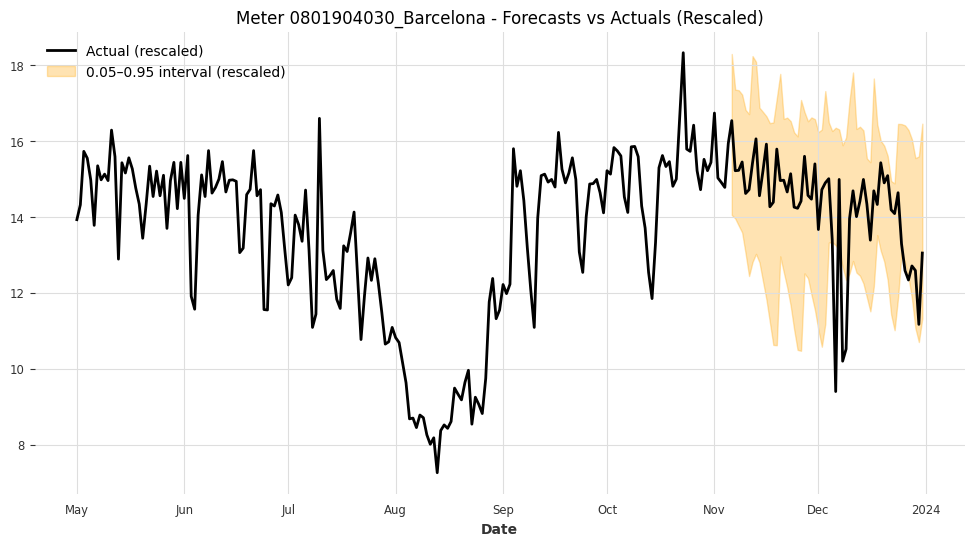

Meter 0801904030_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 4.3300



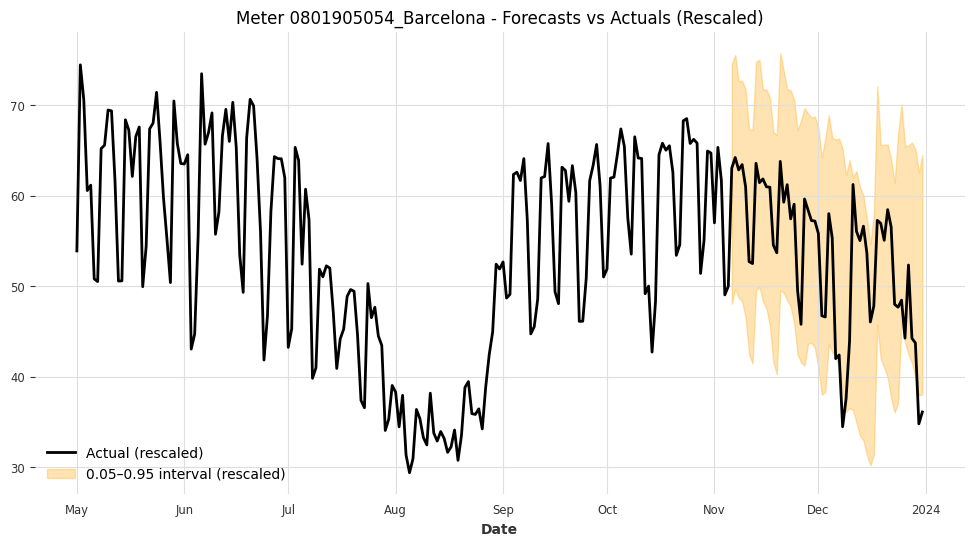

Meter 0801905054_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 25.4531



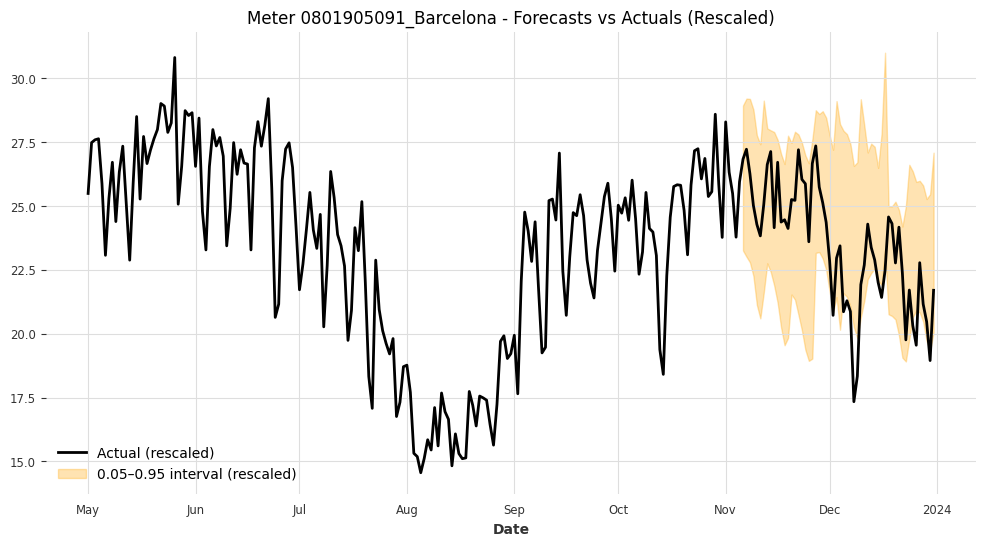

Meter 0801905091_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 6.2313



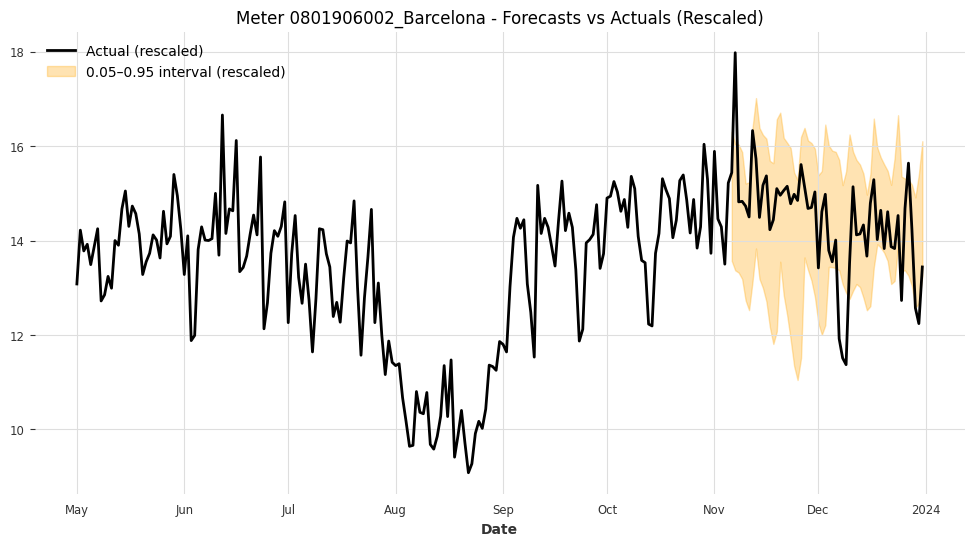

Meter 0801906002_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 2.8970



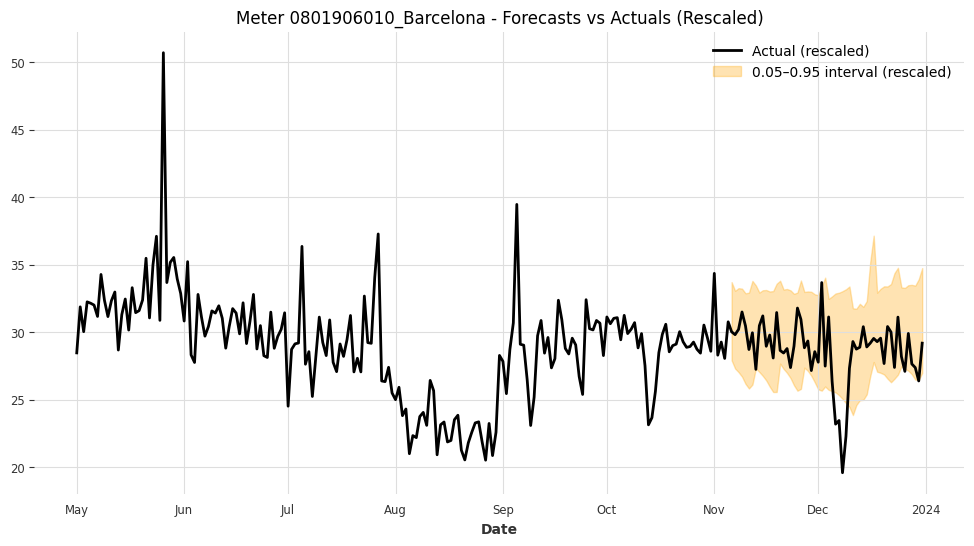

Meter 0801906010_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 6.9740



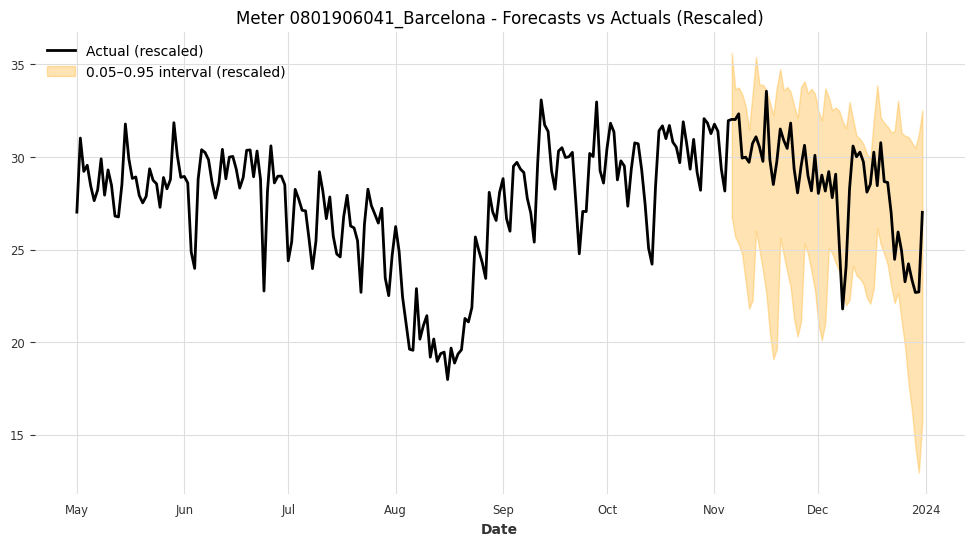

Meter 0801906041_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 10.1240



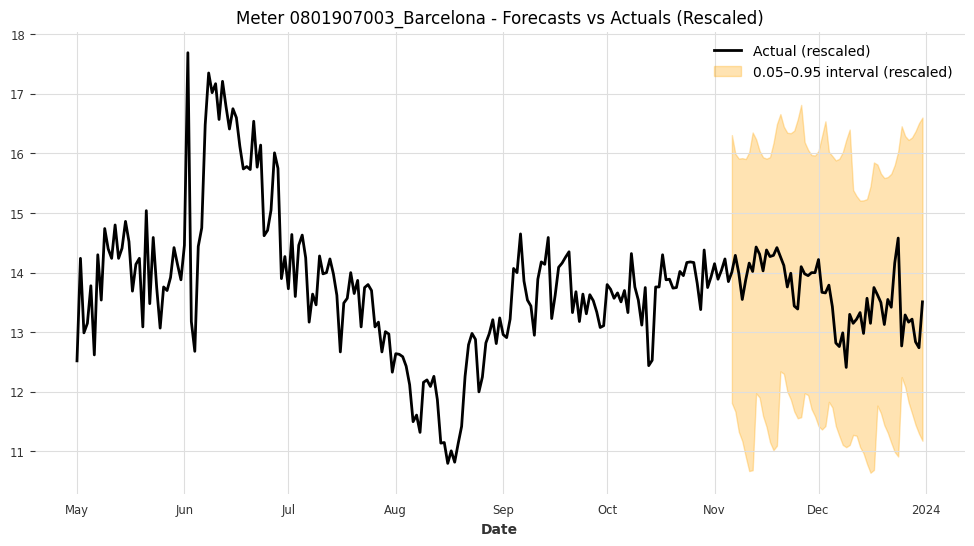

Meter 0801907003_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 4.6125



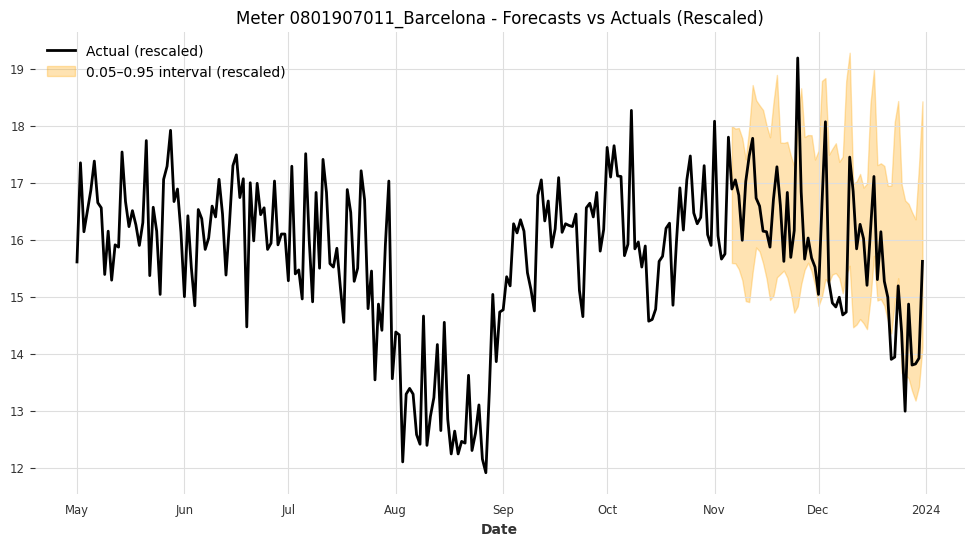

Meter 0801907011_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.7943



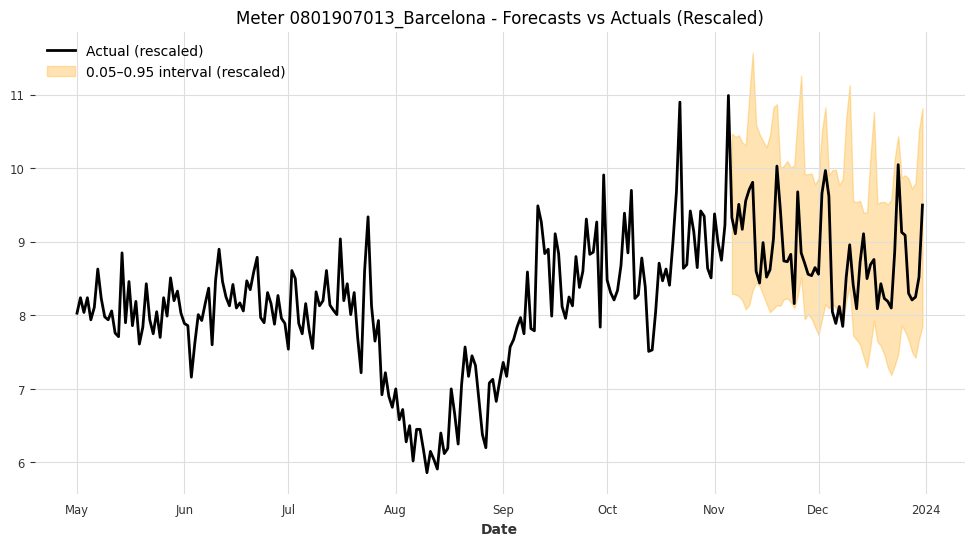

Meter 0801907013_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 2.2428



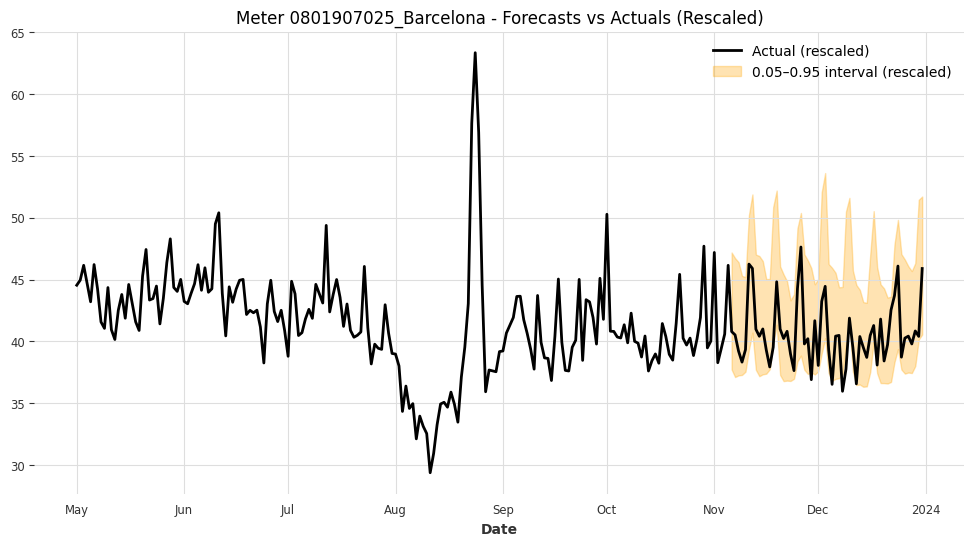

Meter 0801907025_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 9.0071



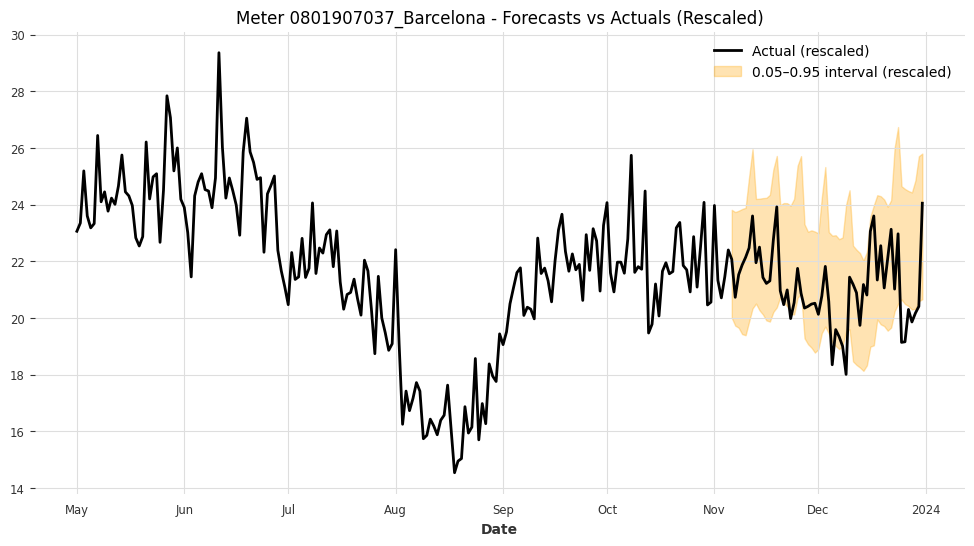

Meter 0801907037_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 4.3629



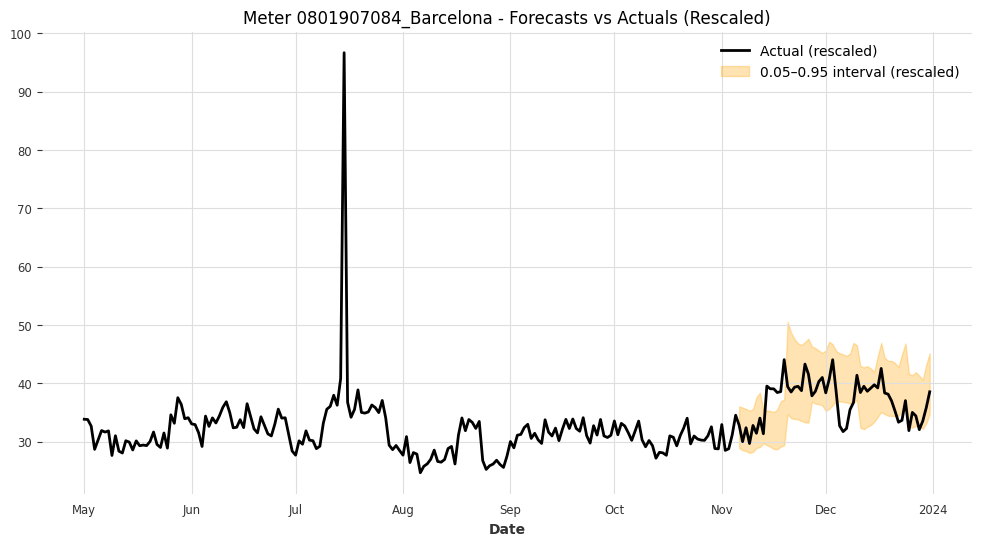

Meter 0801907084_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 9.5115



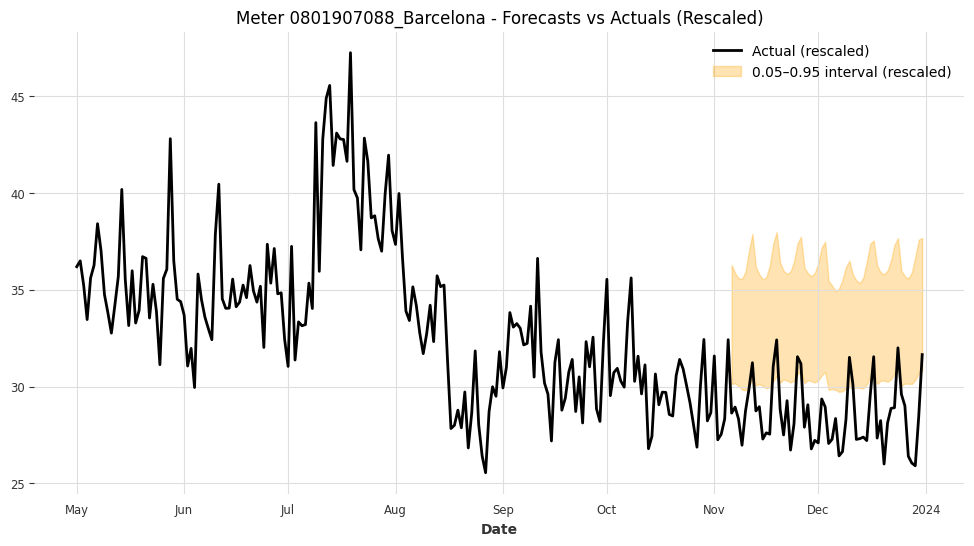

Meter 0801907088_Barcelona - Coverage: 0.1786, Mean Interval Width (rescaled): 6.0744



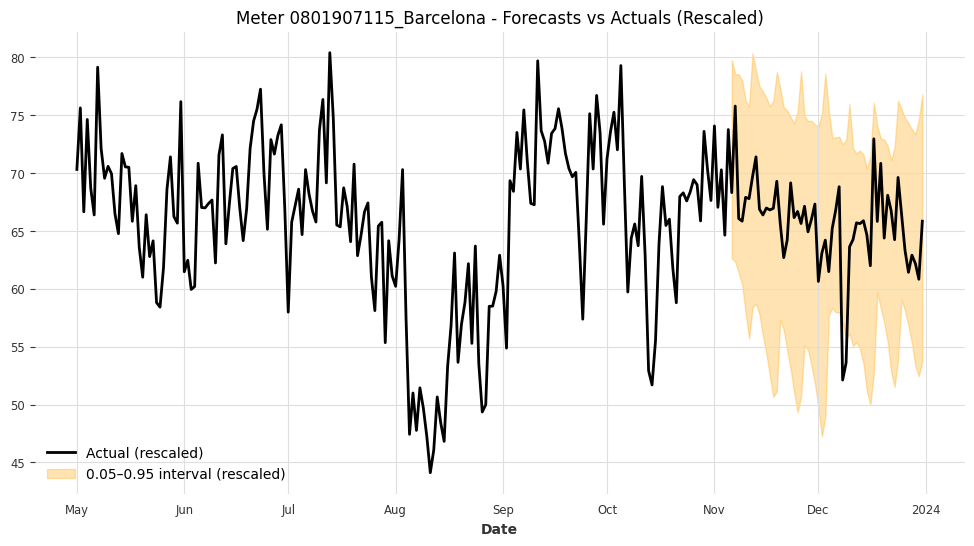

Meter 0801907115_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 19.9600



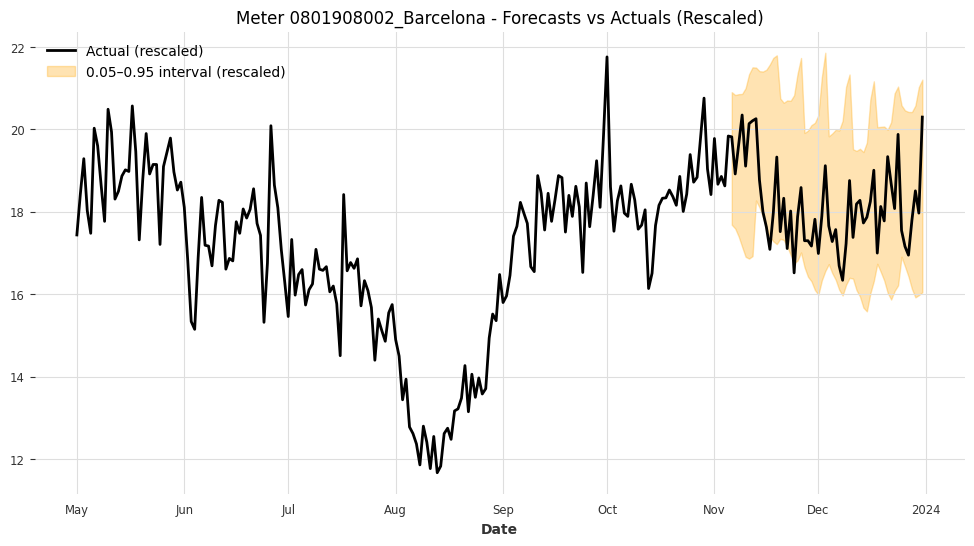

Meter 0801908002_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 4.0176



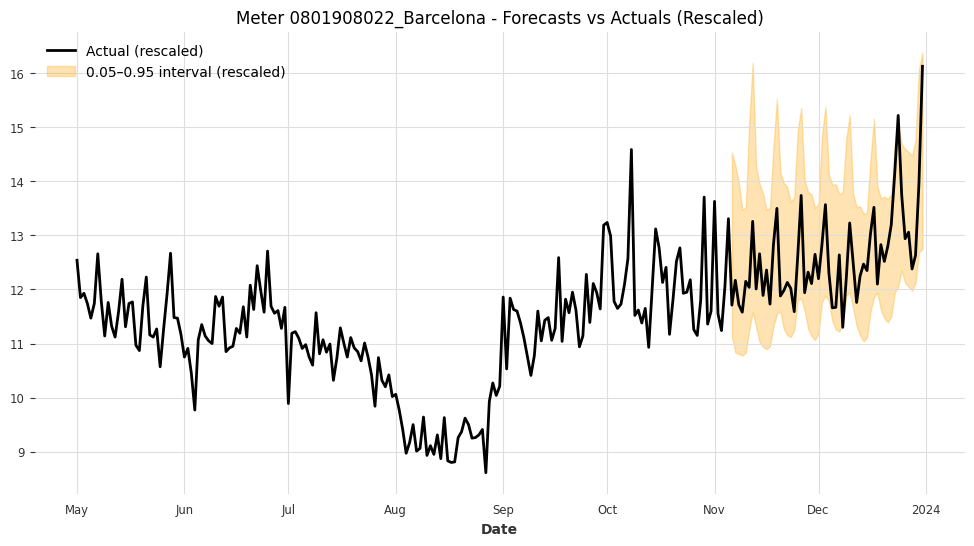

Meter 0801908022_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 2.7826



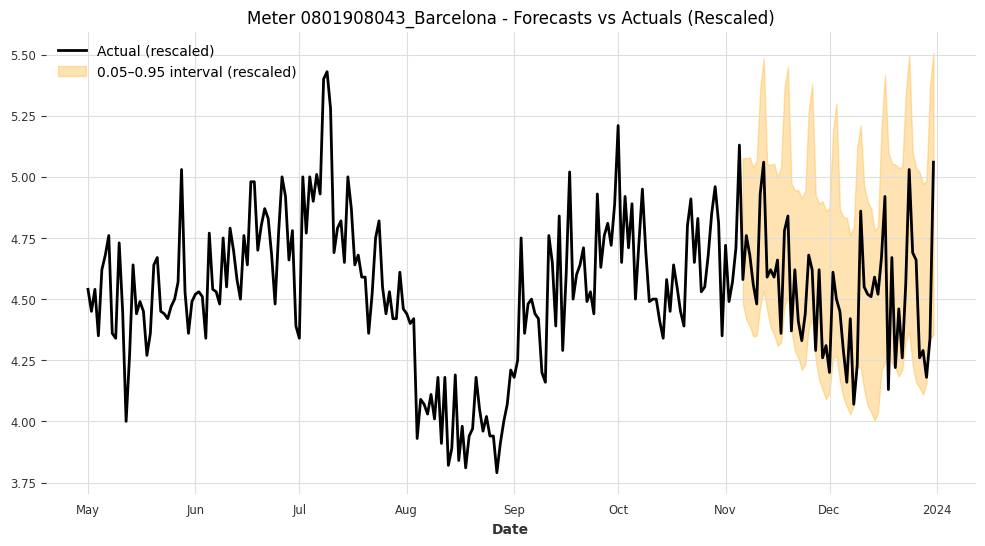

Meter 0801908043_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.8175



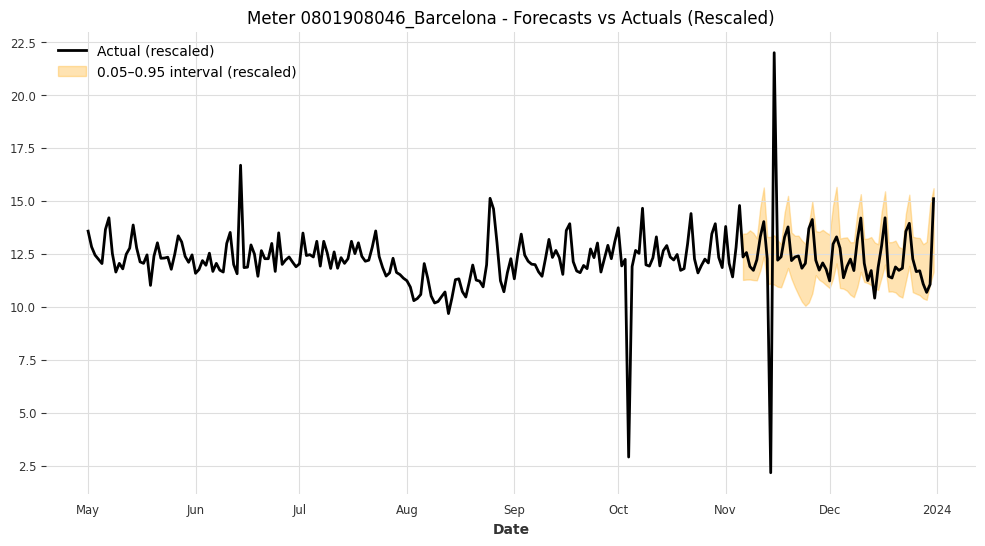

Meter 0801908046_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 2.6904



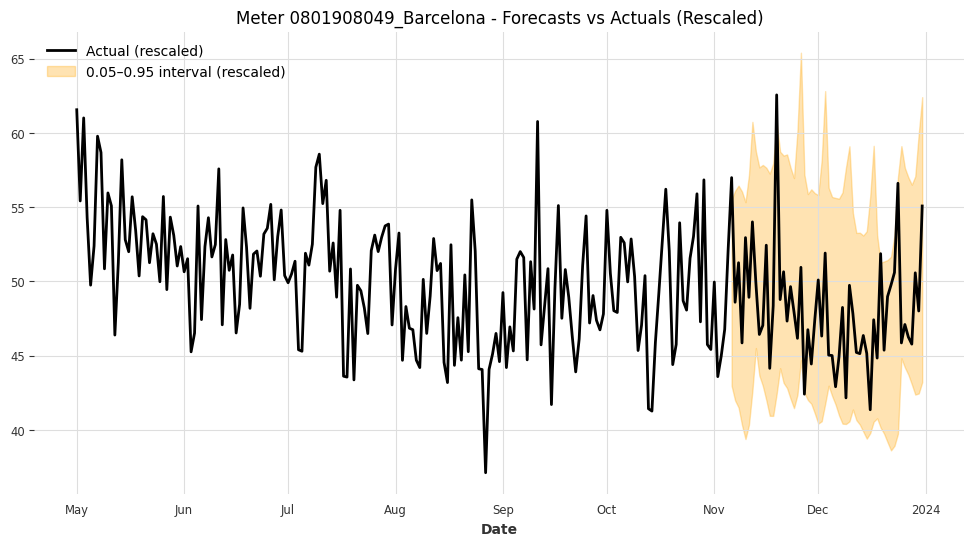

Meter 0801908049_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 15.1613



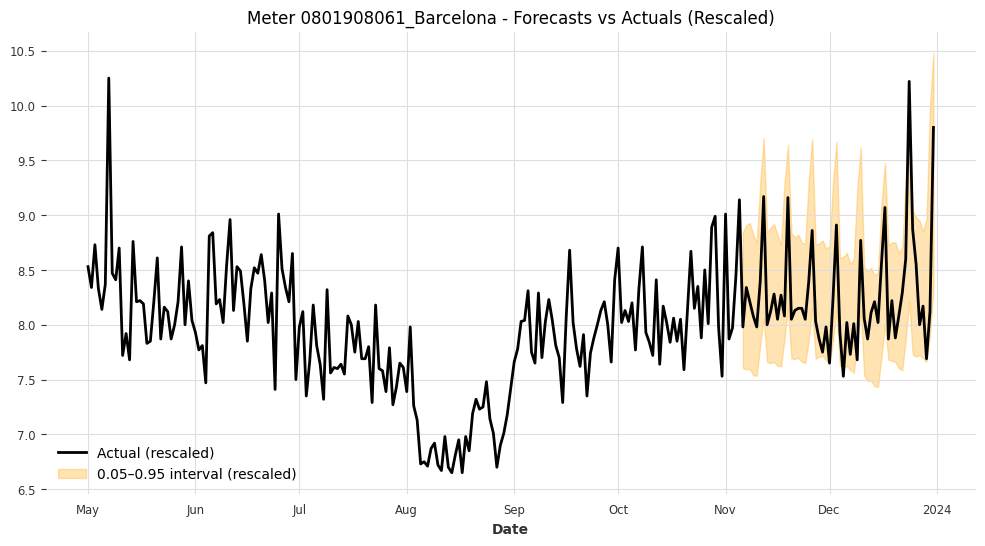

Meter 0801908061_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 1.2479



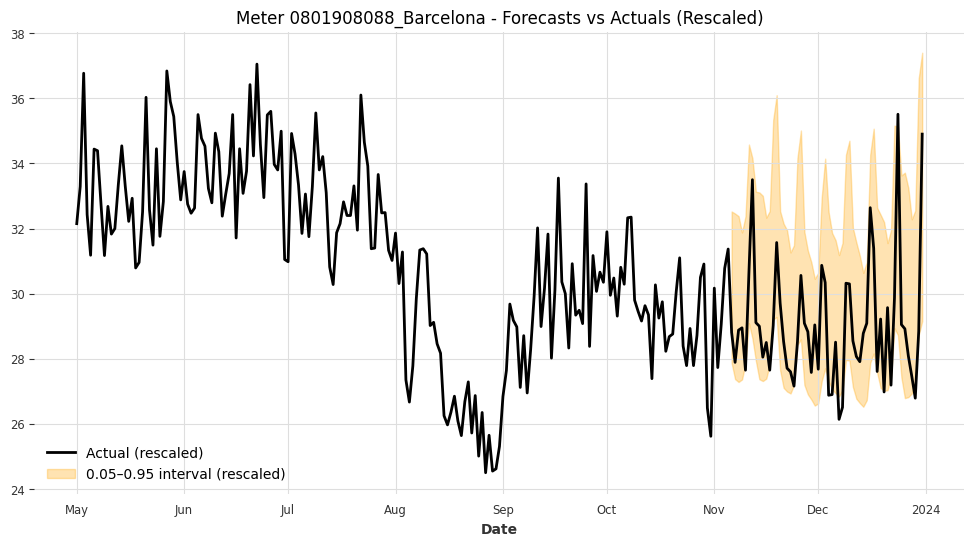

Meter 0801908088_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 5.3407



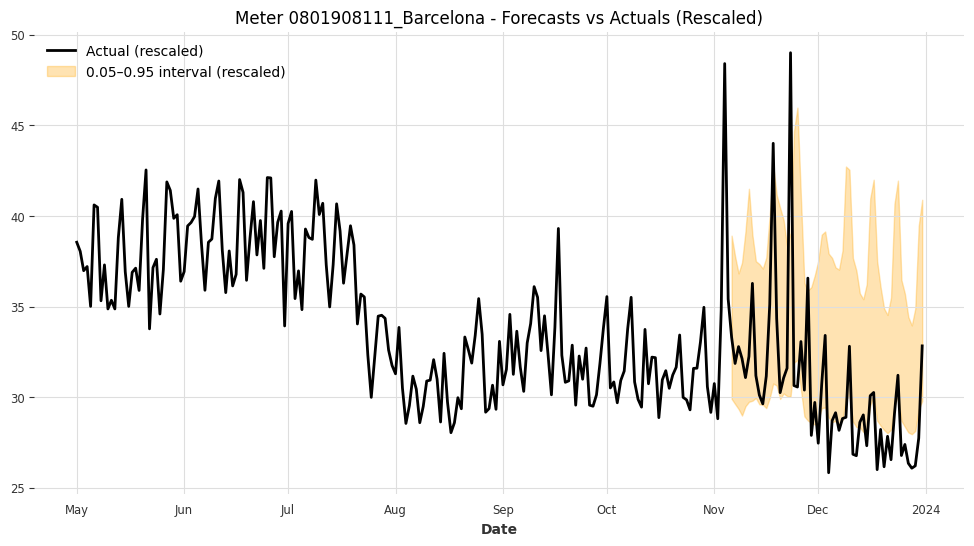

Meter 0801908111_Barcelona - Coverage: 0.5536, Mean Interval Width (rescaled): 9.0959



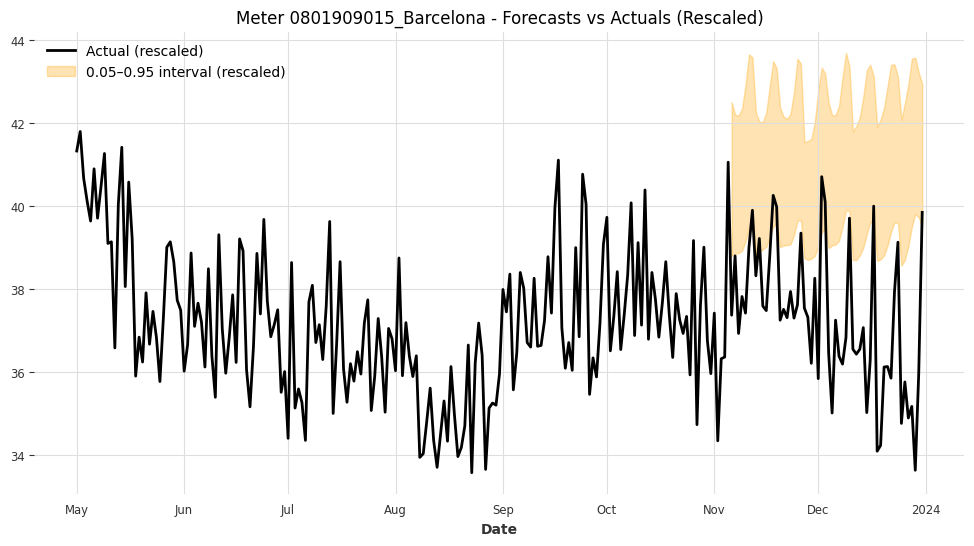

Meter 0801909015_Barcelona - Coverage: 0.1429, Mean Interval Width (rescaled): 3.5160



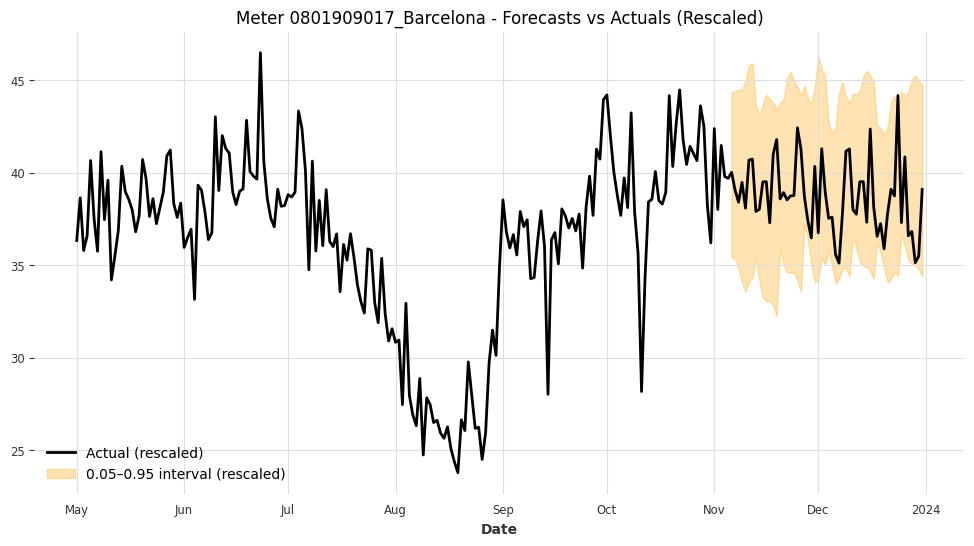

Meter 0801909017_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 9.5030



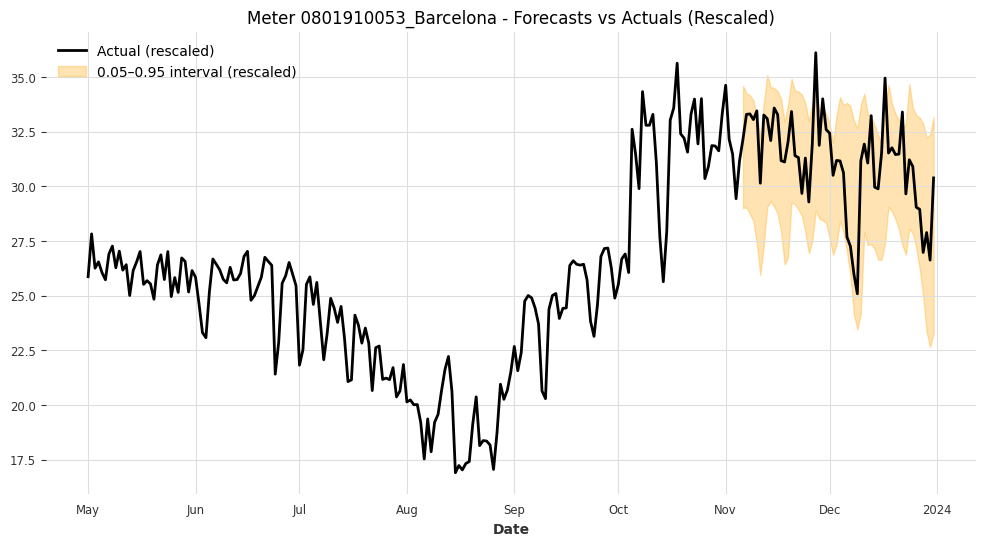

Meter 0801910053_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 6.1995



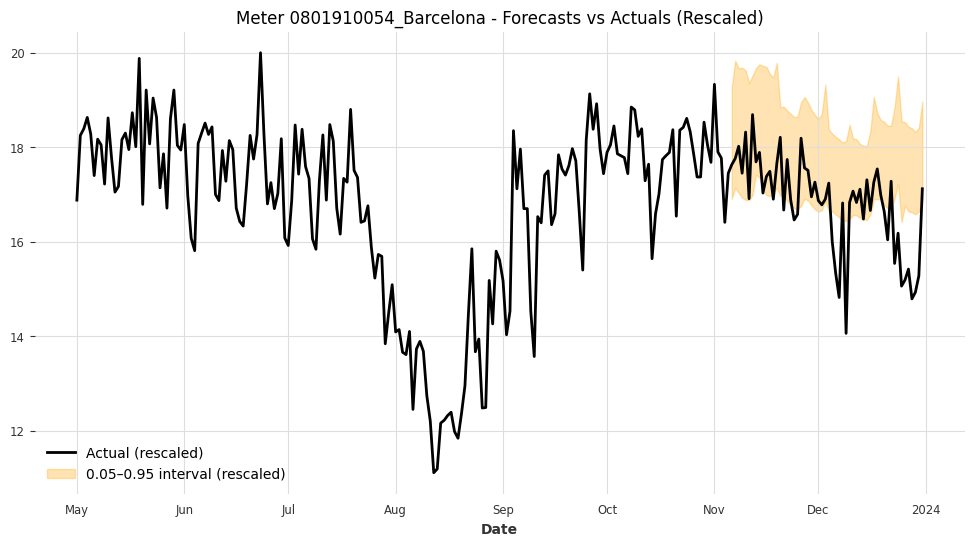

Meter 0801910054_Barcelona - Coverage: 0.6607, Mean Interval Width (rescaled): 2.0369



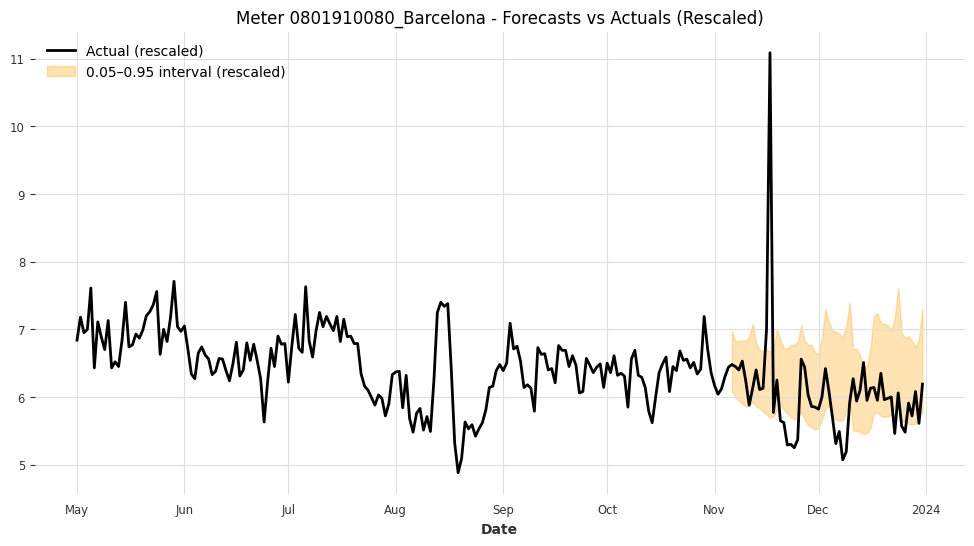

Meter 0801910080_Barcelona - Coverage: 0.6786, Mean Interval Width (rescaled): 1.1655



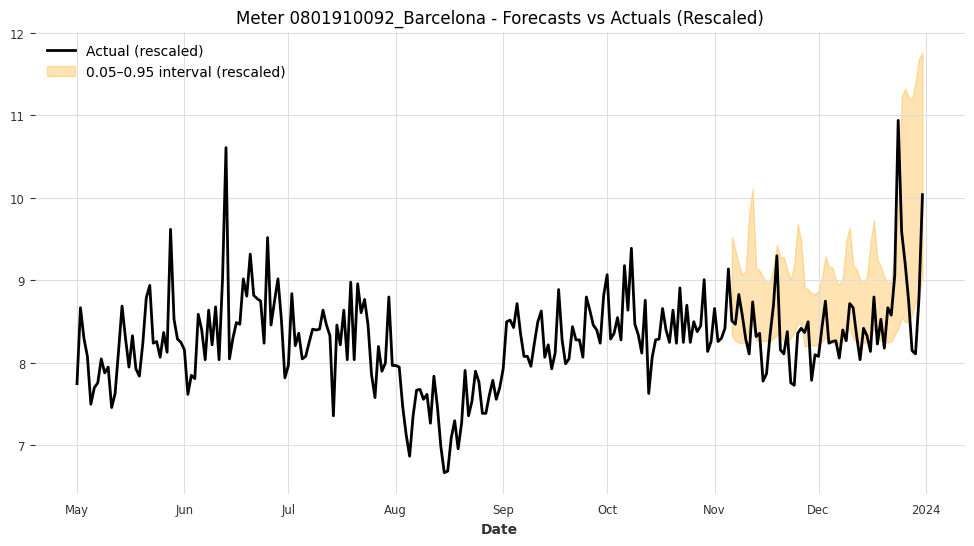

Meter 0801910092_Barcelona - Coverage: 0.5893, Mean Interval Width (rescaled): 1.1423



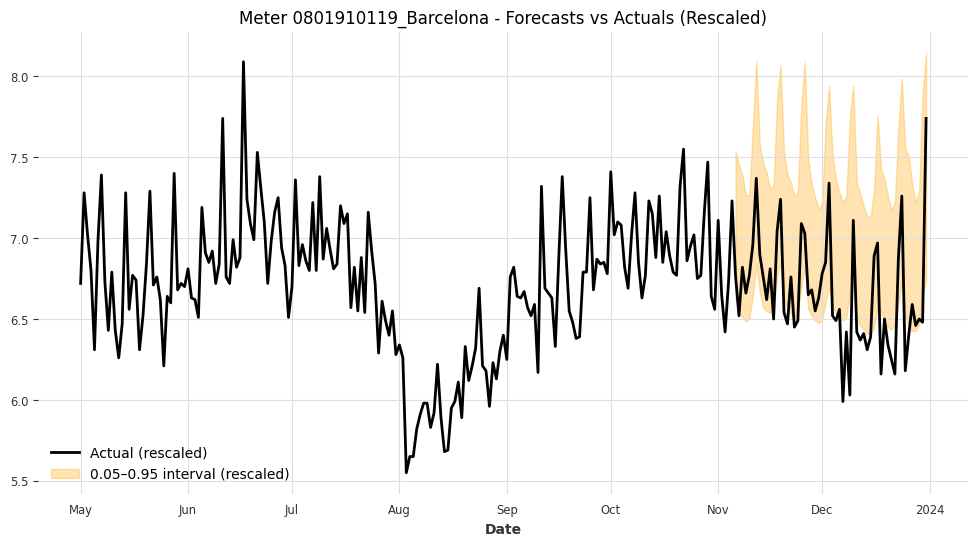

Meter 0801910119_Barcelona - Coverage: 0.5893, Mean Interval Width (rescaled): 0.9226



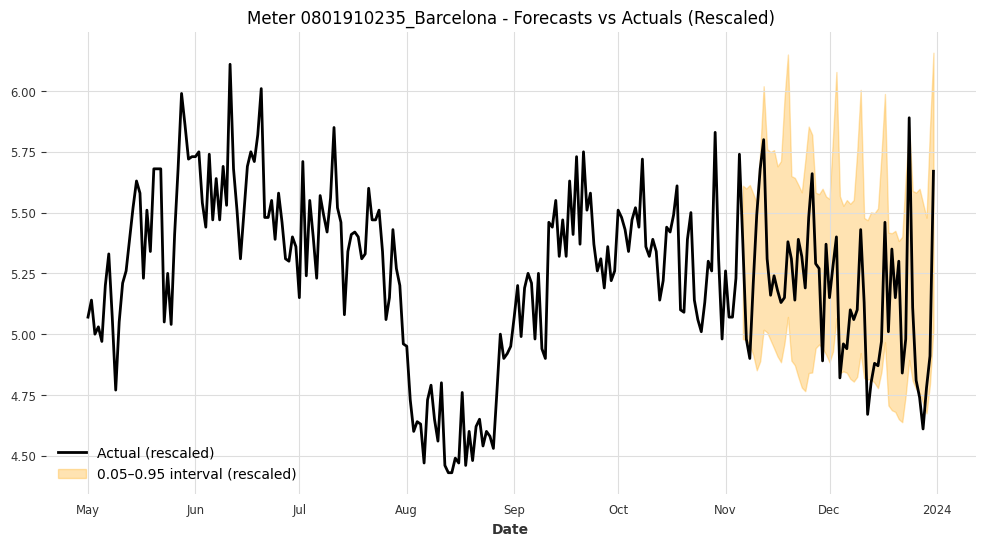

Meter 0801910235_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 0.8048



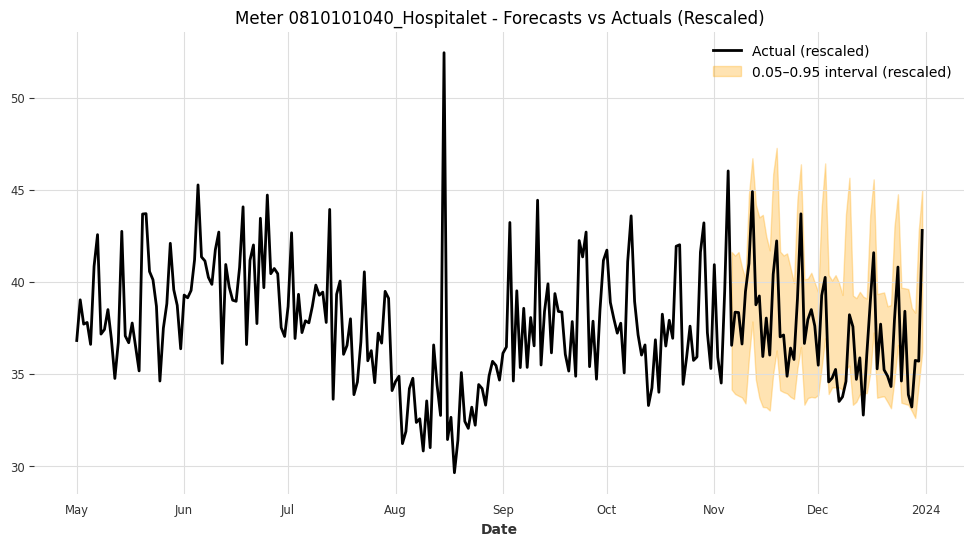

Meter 0810101040_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 7.3670



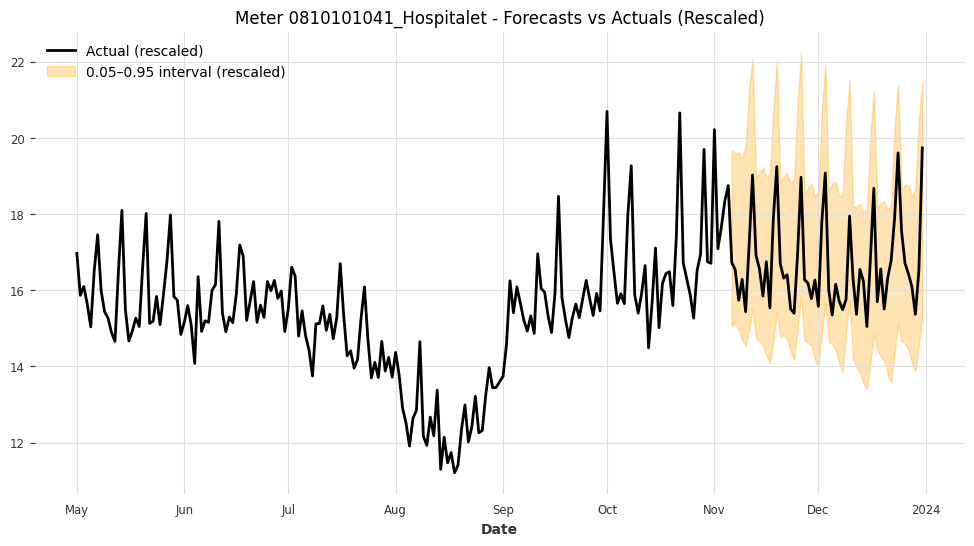

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 4.8868



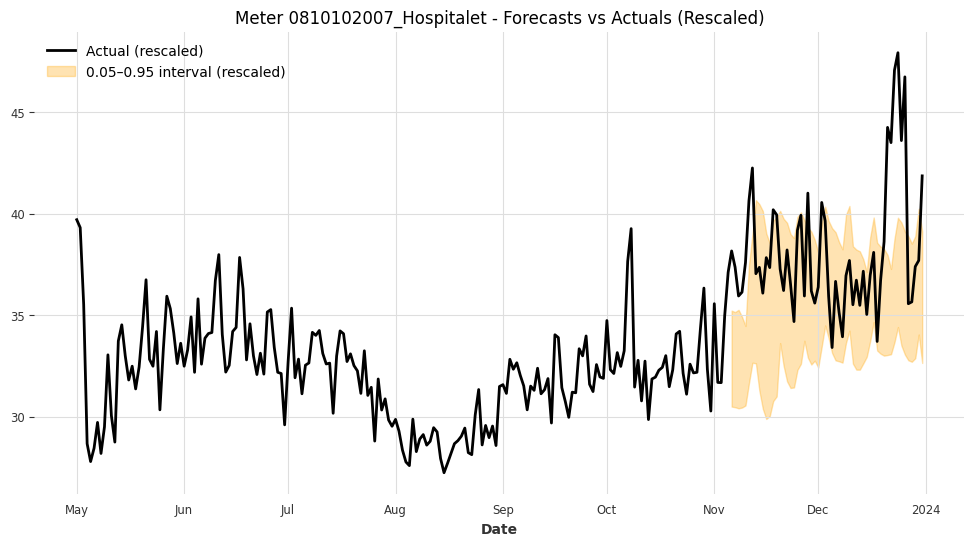

Meter 0810102007_Hospitalet - Coverage: 0.6607, Mean Interval Width (rescaled): 6.2265



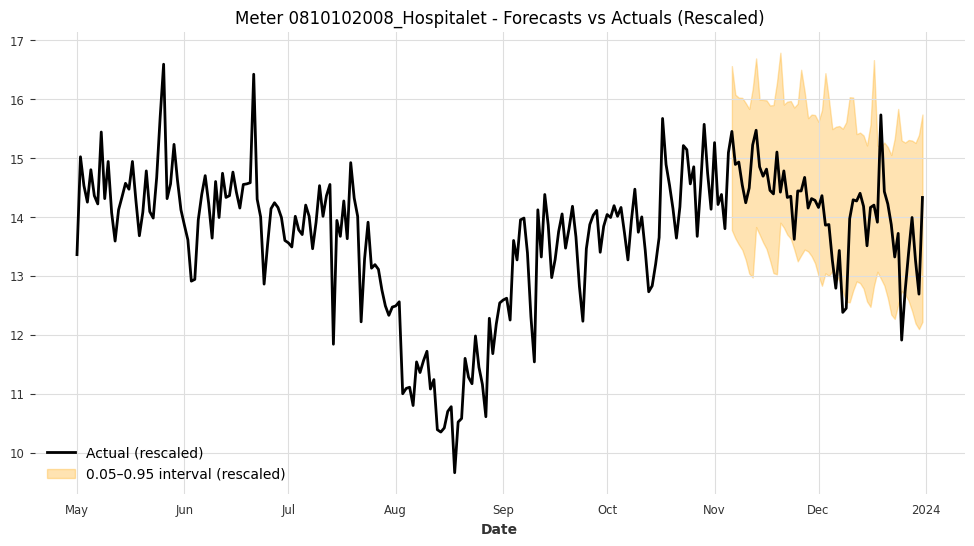

Meter 0810102008_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.7455



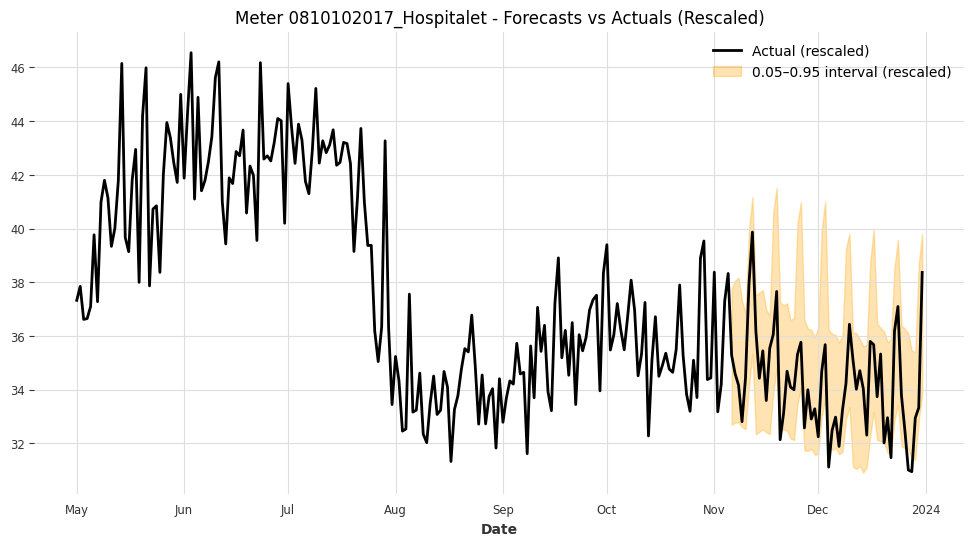

Meter 0810102017_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 5.1054



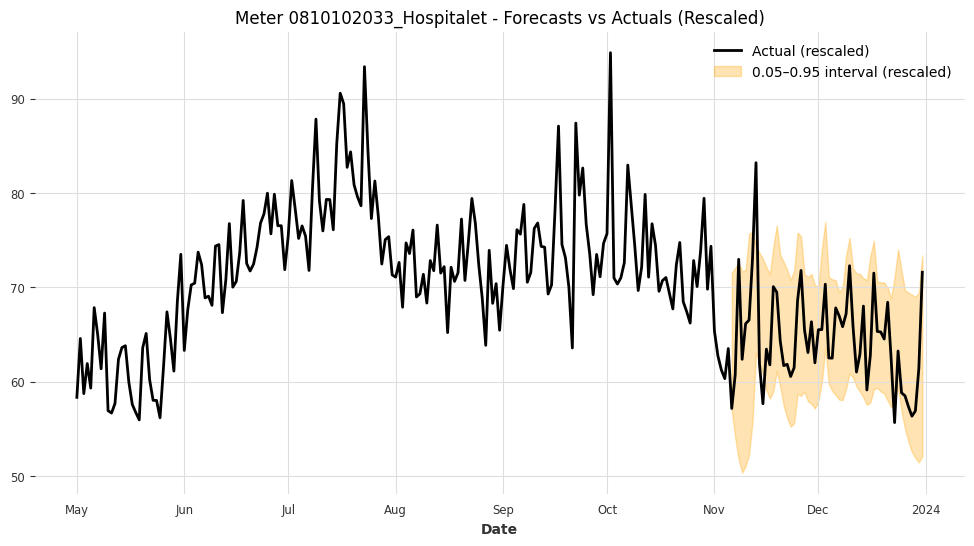

Meter 0810102033_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 14.6257



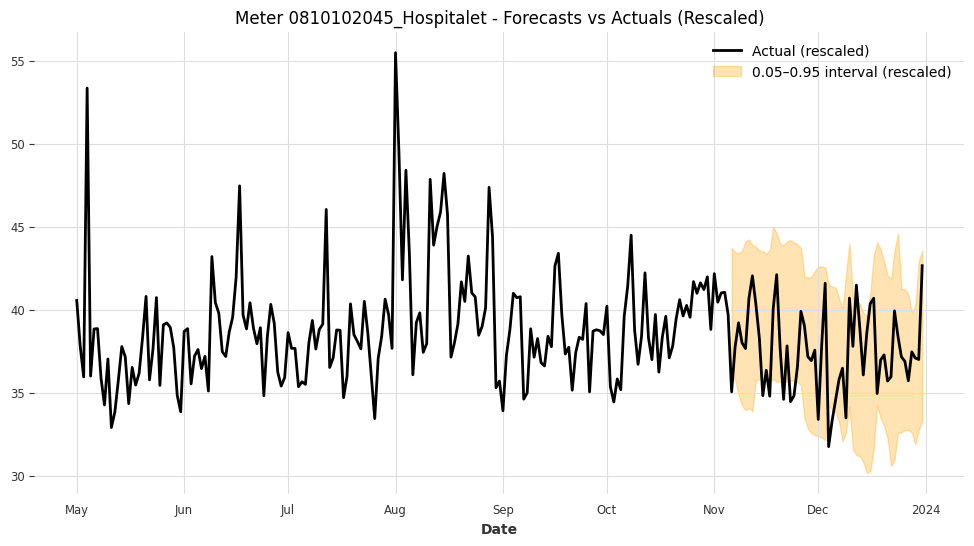

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 9.0896



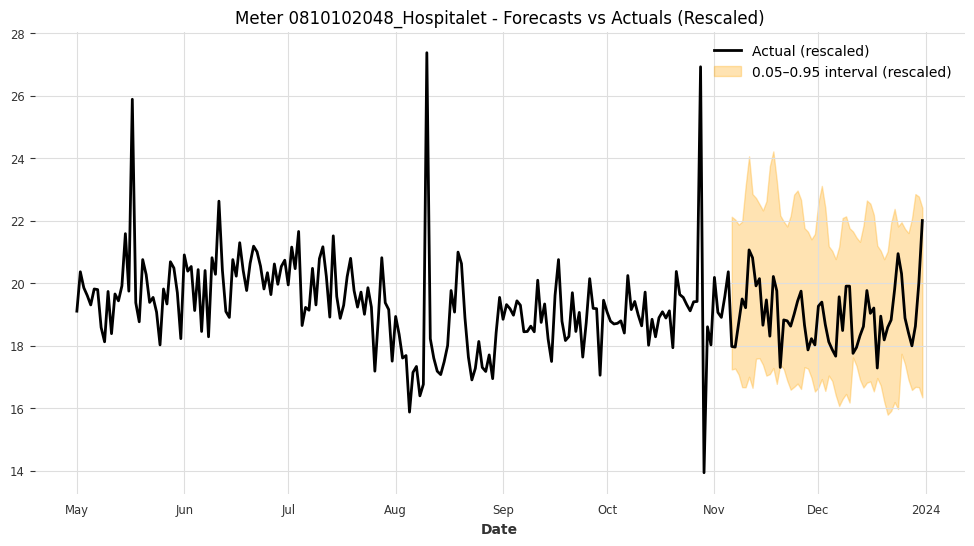

Meter 0810102048_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 5.3189



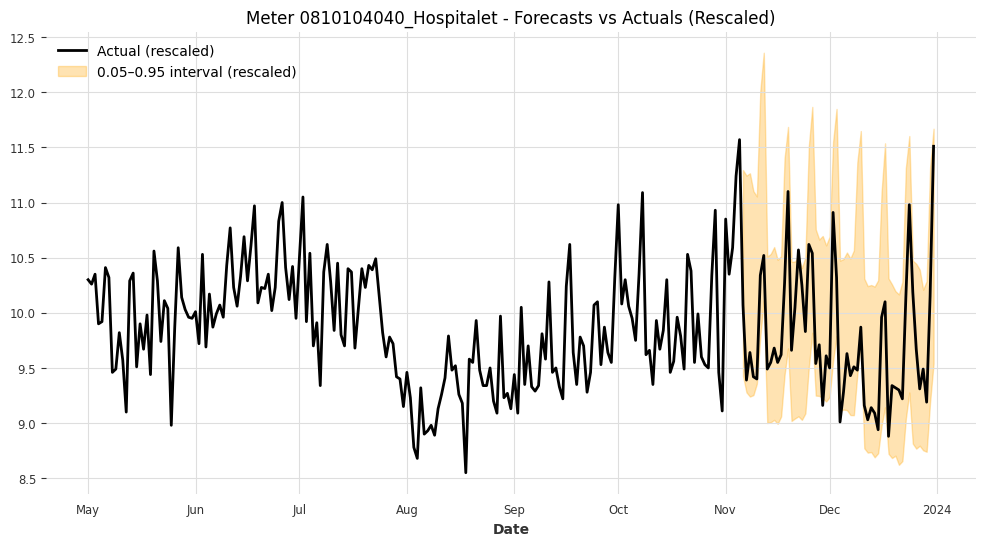

Meter 0810104040_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.7070



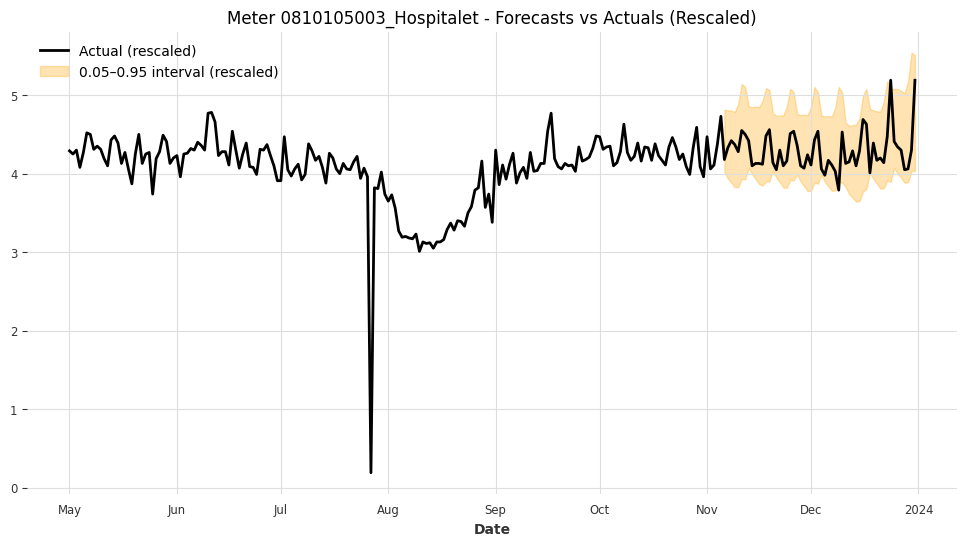

Meter 0810105003_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.0217



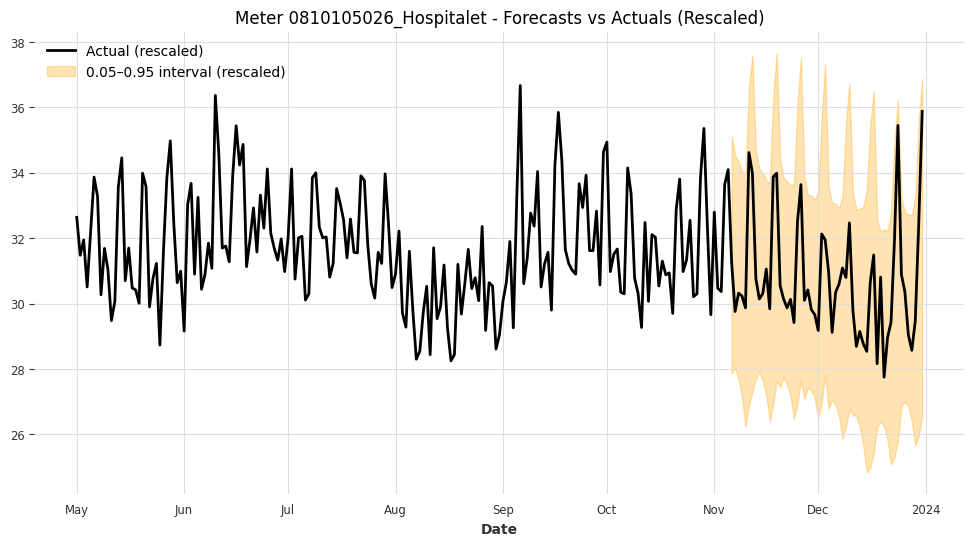

Meter 0810105026_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 7.5578



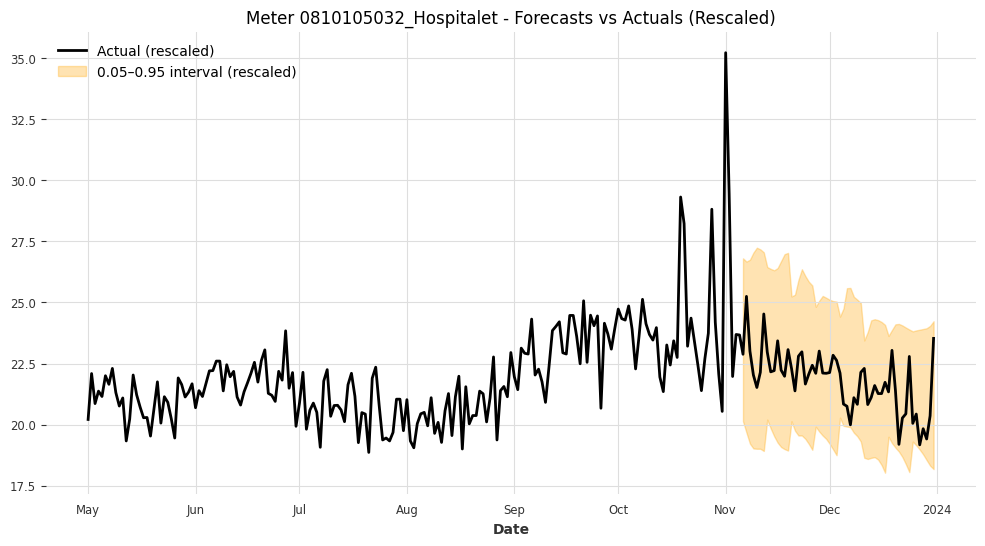

Meter 0810105032_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 6.0083



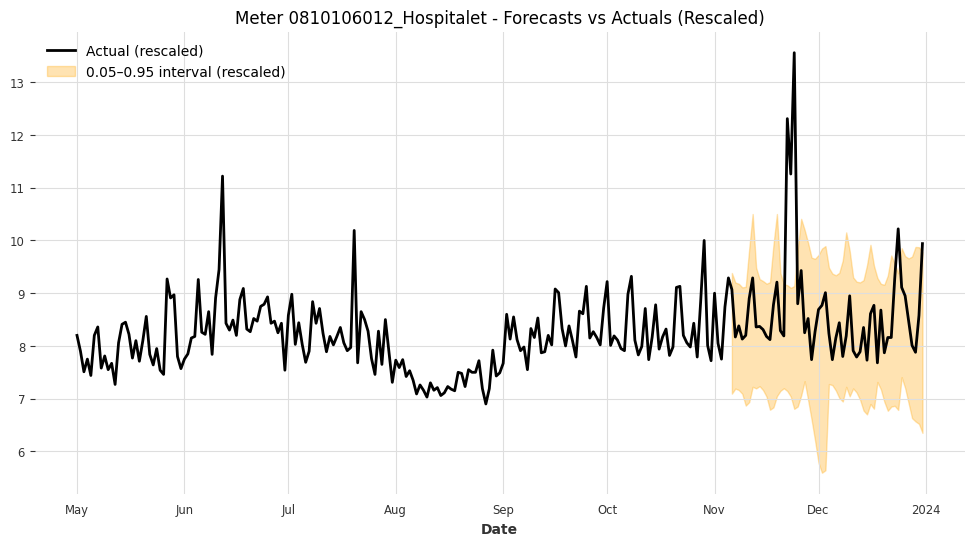

Meter 0810106012_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.6497



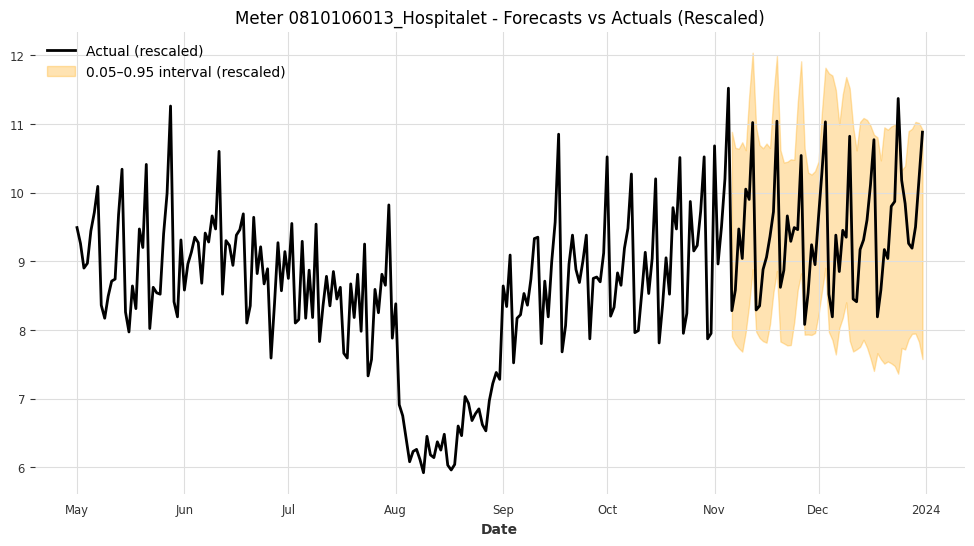

Meter 0810106013_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 3.0172



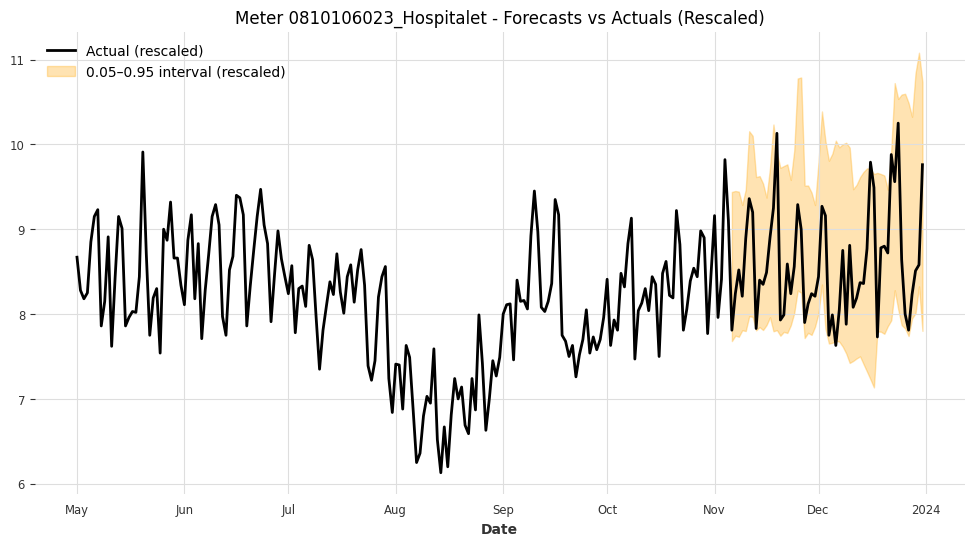

Meter 0810106023_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 2.1164



In [13]:
for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [14]:
# Now we will test with the Standard Scaling

In [16]:
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model_standard.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [17]:
# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.803571  21.351396


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9     0.875  28.525423


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9  0.678571  3.935418


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  2.417079


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  3.796861


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902052_Barcelona:
    Interval  Coverage    Width
0       0.9  0.035714  2.36546


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  2.639687


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width
0       0.9      0.75  2.957941


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  0.846529


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903040_Barcelona:
    Interval  Coverage    Width
0       0.9  0.857143  0.96025


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  3.783401


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9  0.696429  3.796598


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  1.123667


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903081_Barcelona:
    Interval  Coverage    Width
0       0.9  0.839286  2.30411


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.517857  6.955709


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  3.551638


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.857143  22.913519


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801905091_Barcelona:
    Interval  Coverage    Width
0       0.9  0.785714  5.47713


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  2.533961


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  6.955787


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906041_Barcelona:
    Interval  Coverage   Width
0       0.9  0.964286  8.7033


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  2.572878


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  2.879641


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  2.187784


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width
0       0.9  0.696429  9.051279


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9     0.625  4.236957


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  9.397262


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width
0       0.9       1.0  8.703867


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907115_Barcelona:
    Interval  Coverage      Width
0       0.9       1.0  27.245205


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  3.473775


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.678838


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  0.676023


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908046_Barcelona:
    Interval  Coverage    Width
0       0.9  0.892857  2.17537


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908049_Barcelona:
    Interval  Coverage      Width
0       0.9  0.910714  15.885259


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  1.224772


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.678571  5.882116


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.464286  8.936256


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9  0.267857  6.212192


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width
0       0.9  0.982143  9.046385


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  6.863453


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width
0       0.9     0.375  2.915493


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.607143  1.313918


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9  0.214286  0.910842


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage    Width
0       0.9  0.910714  1.26181


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  0.816256


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  8.002788


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  3.678102


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.696429  8.01039


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  2.011481


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  5.212081


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.892857  14.474291


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  9.208937


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.979677


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  1.362999


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  0.750379


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  4.871059


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105032_Hospitalet:
    Interval  Coverage    Width
0       0.9       1.0  5.93562


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106012_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.910714  2.31727


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  3.016765


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  2.034526


In [18]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8054
Mean Width: 5.8218


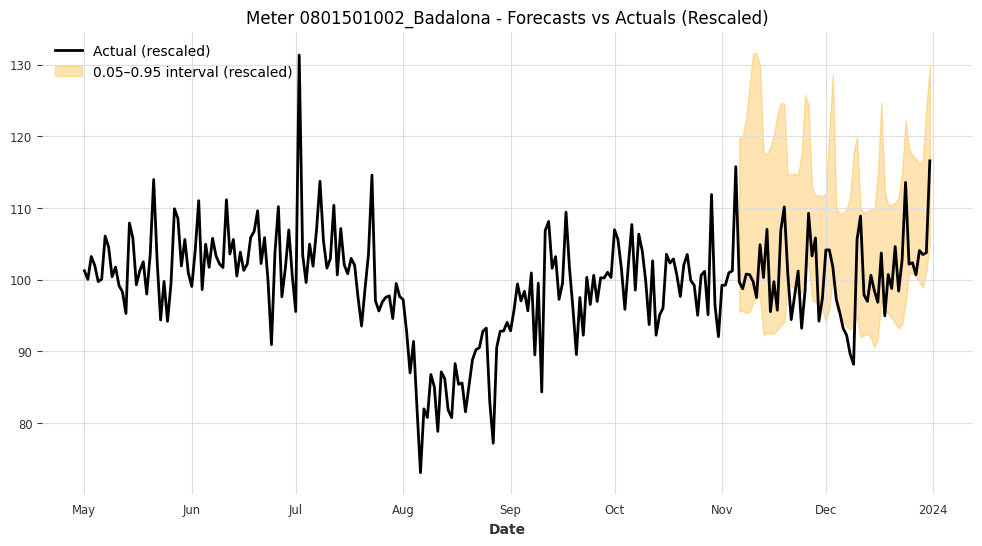

Meter 0801501002_Badalona - Coverage: 0.8036, Mean Interval Width (rescaled): 21.3514



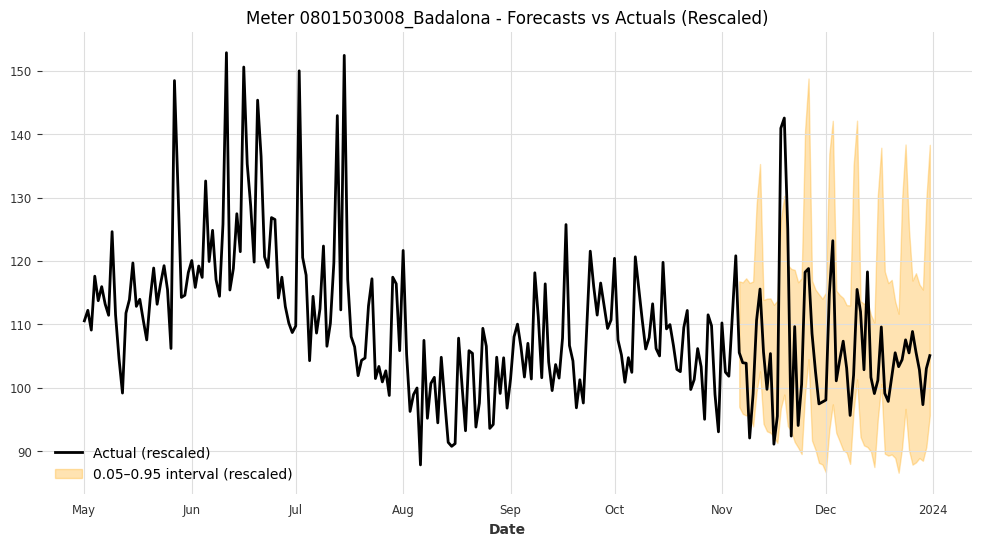

Meter 0801503008_Badalona - Coverage: 0.8750, Mean Interval Width (rescaled): 28.5254



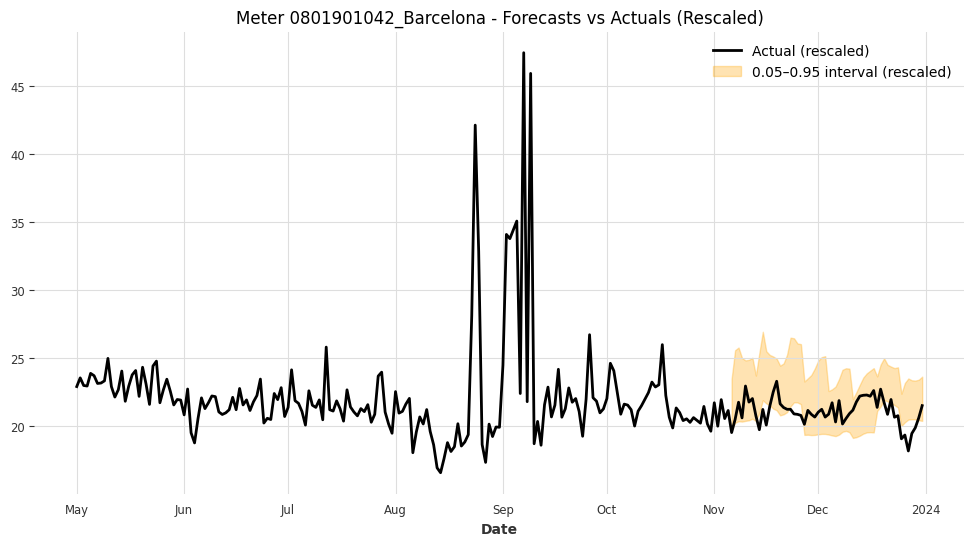

Meter 0801901042_Barcelona - Coverage: 0.6786, Mean Interval Width (rescaled): 3.9354



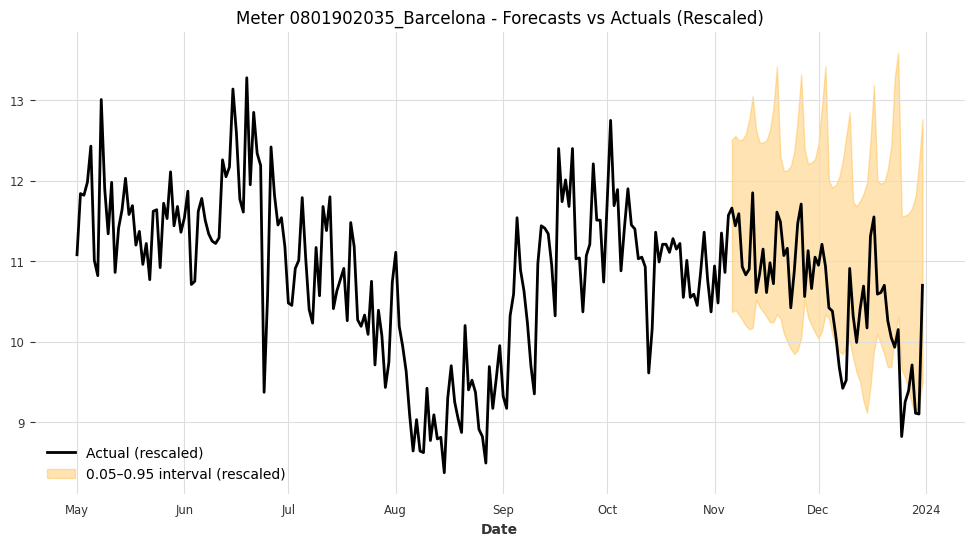

Meter 0801902035_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.4171



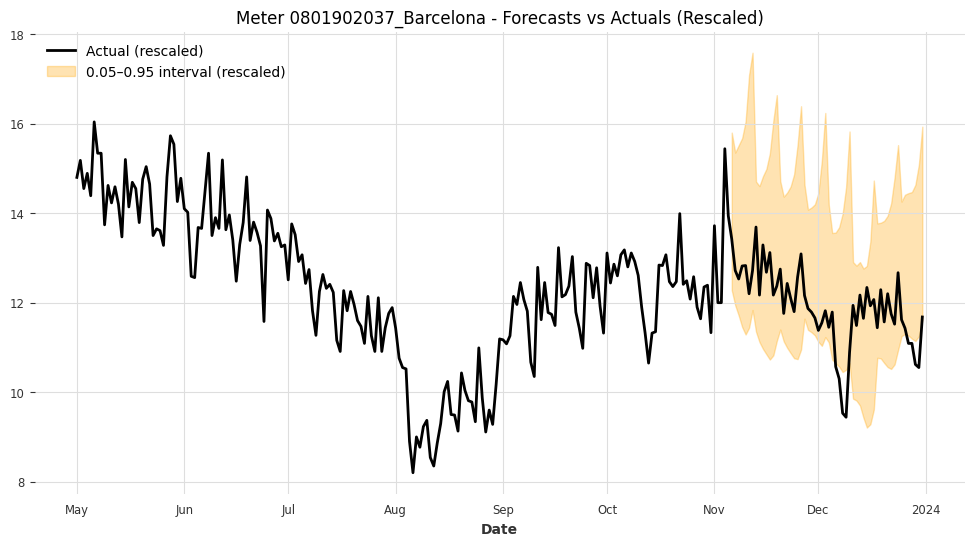

Meter 0801902037_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 3.7969



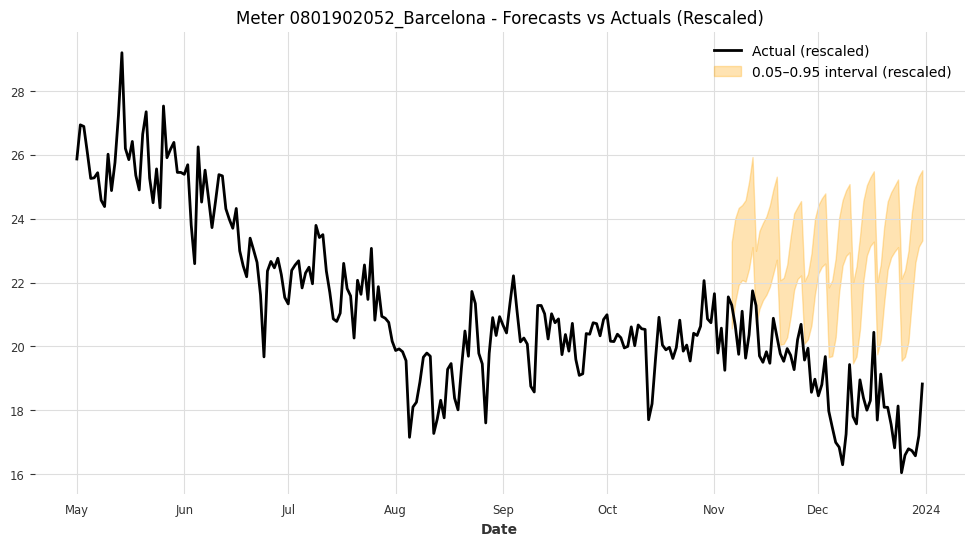

Meter 0801902052_Barcelona - Coverage: 0.0357, Mean Interval Width (rescaled): 2.3655



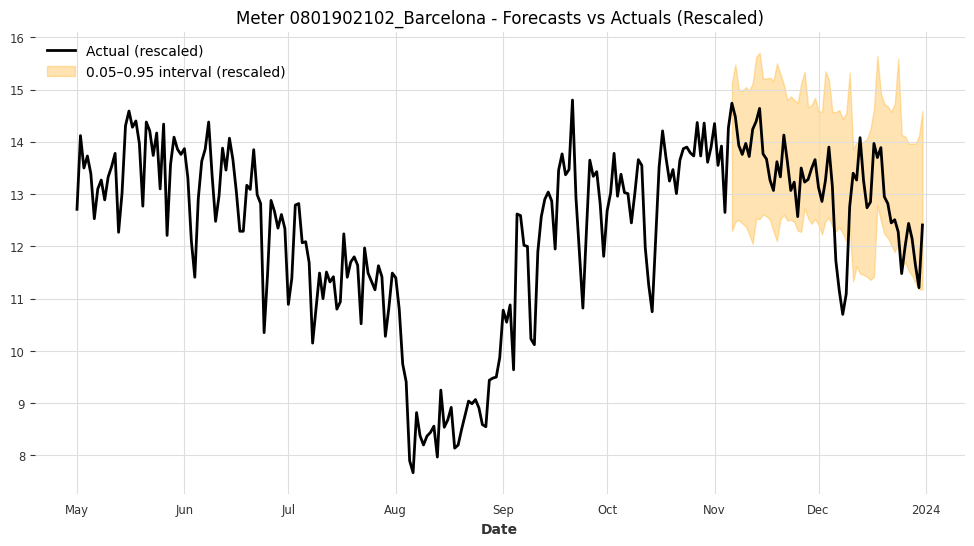

Meter 0801902102_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.6397



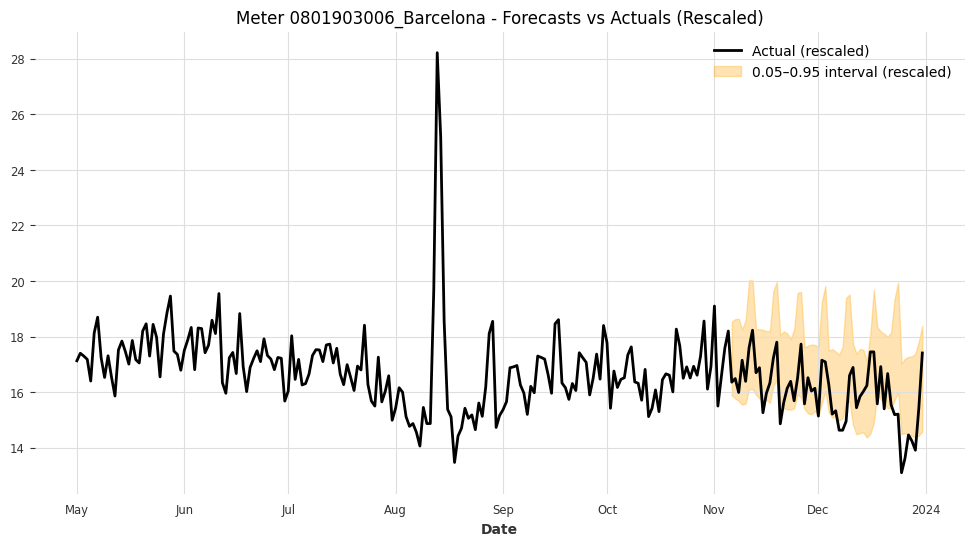

Meter 0801903006_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 2.9579



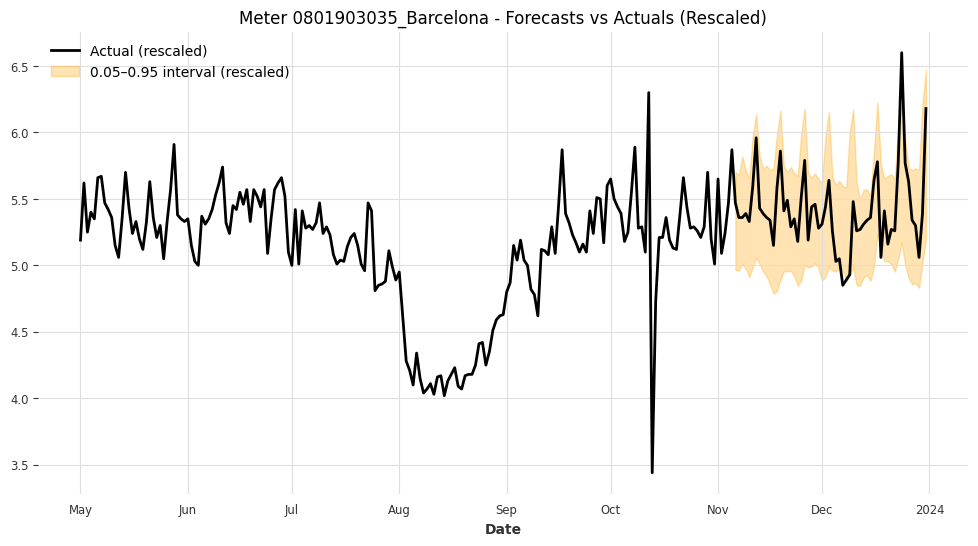

Meter 0801903035_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 0.8465



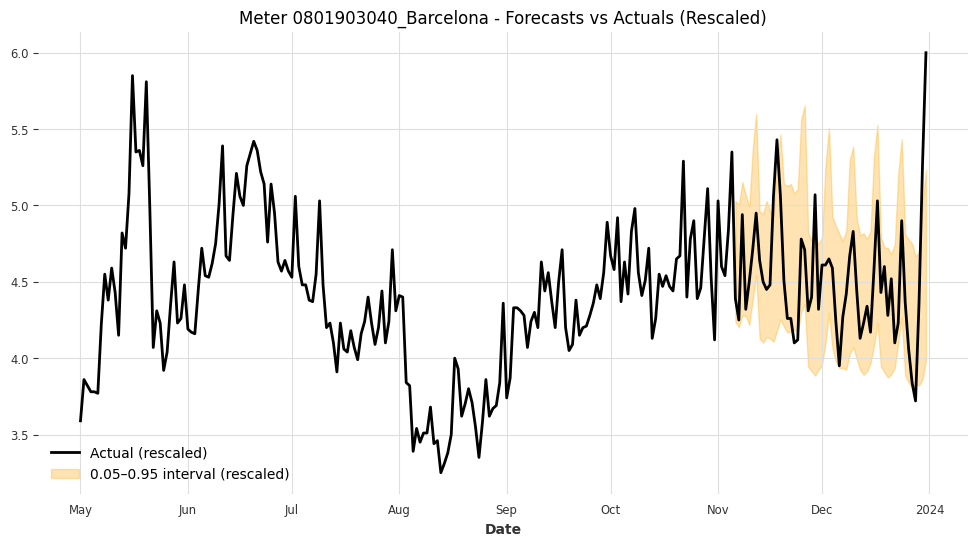

Meter 0801903040_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 0.9602



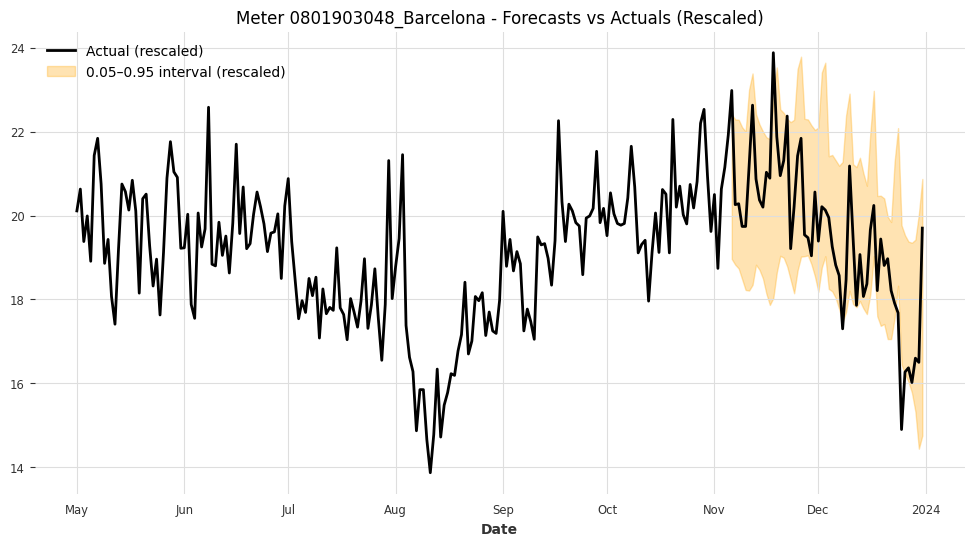

Meter 0801903048_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.7834



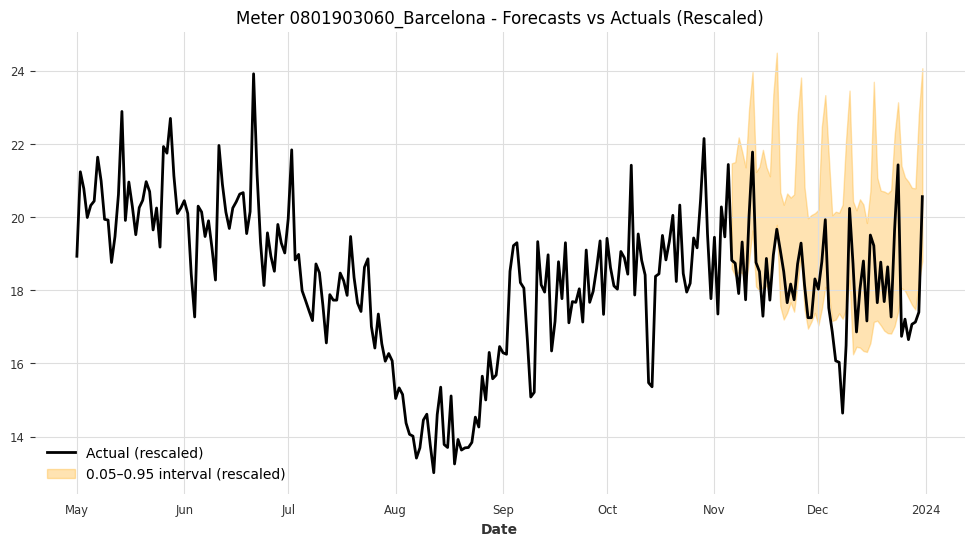

Meter 0801903060_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 3.7966



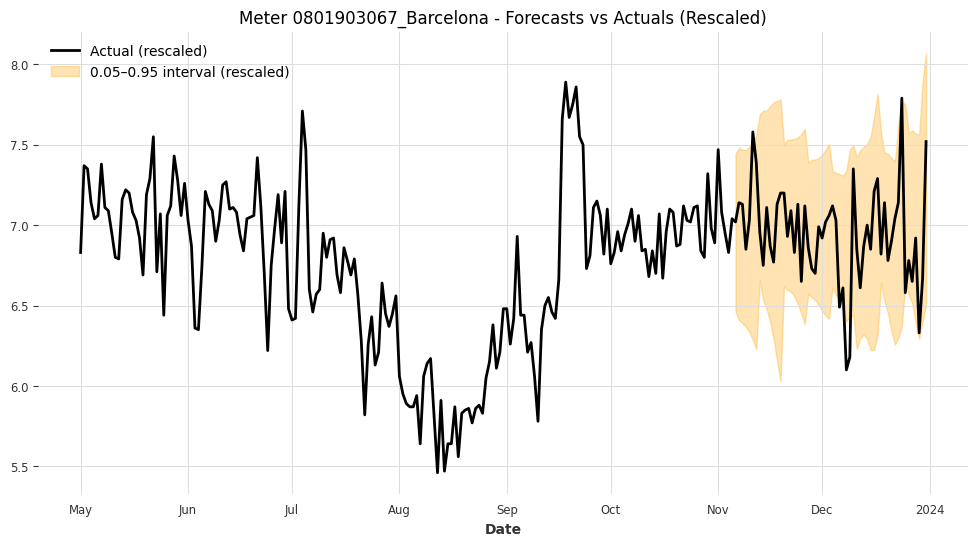

Meter 0801903067_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 1.1237



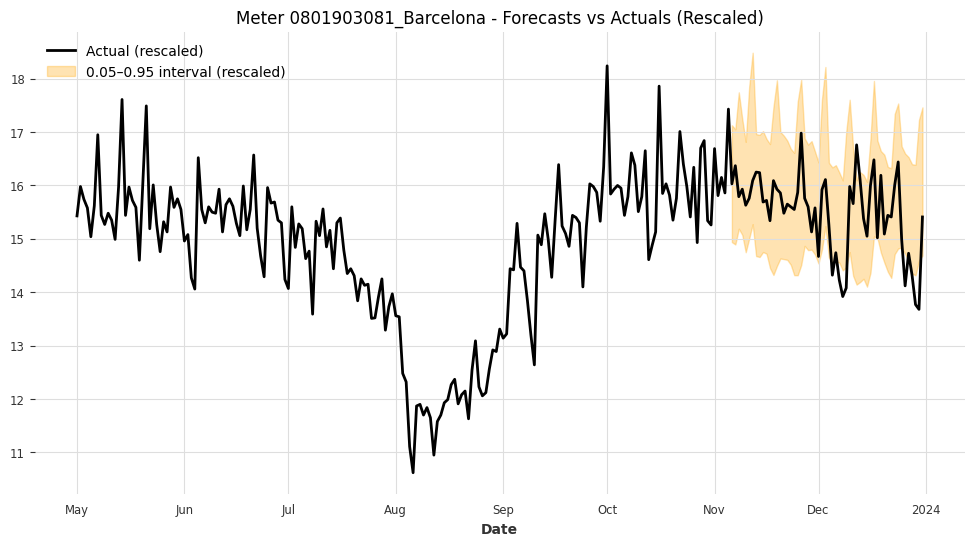

Meter 0801903081_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.3041



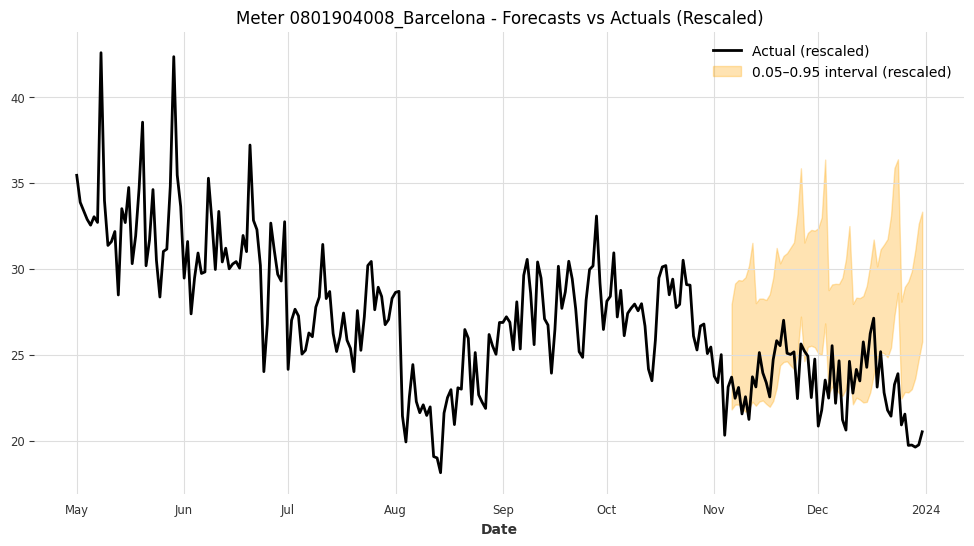

Meter 0801904008_Barcelona - Coverage: 0.5179, Mean Interval Width (rescaled): 6.9557



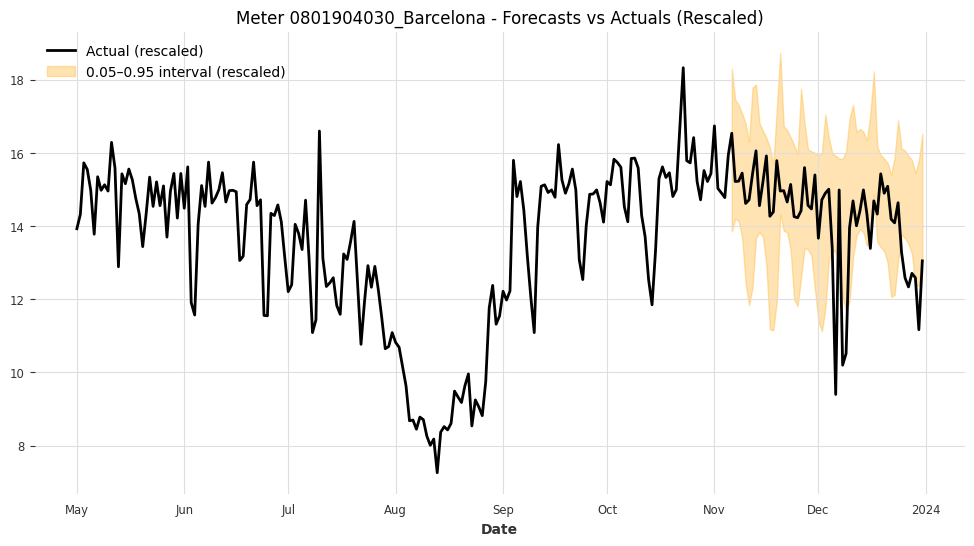

Meter 0801904030_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 3.5516



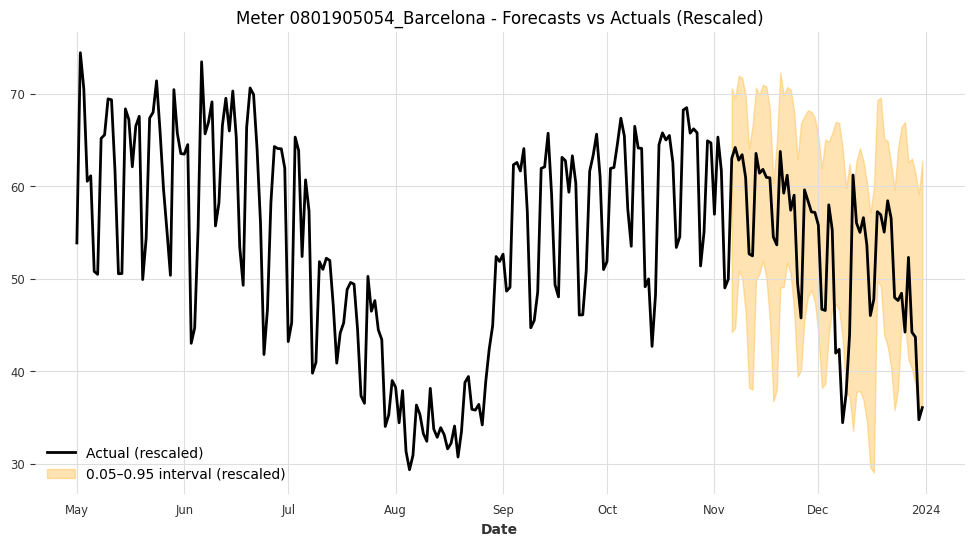

Meter 0801905054_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 22.9135



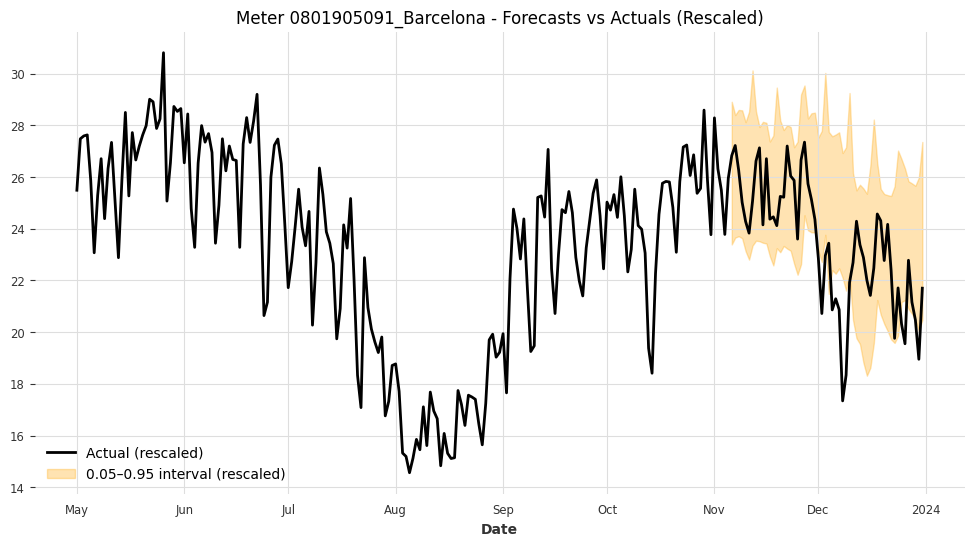

Meter 0801905091_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 5.4771



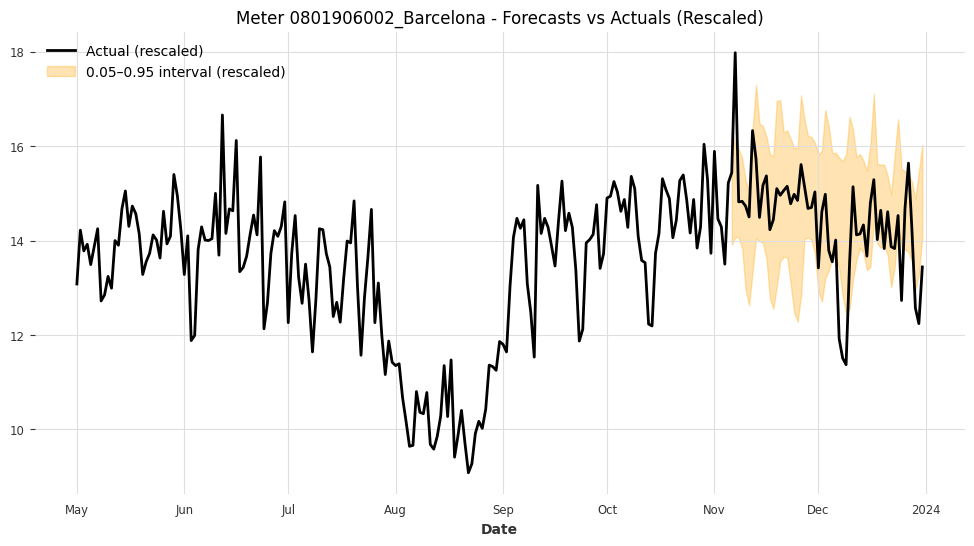

Meter 0801906002_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 2.5340



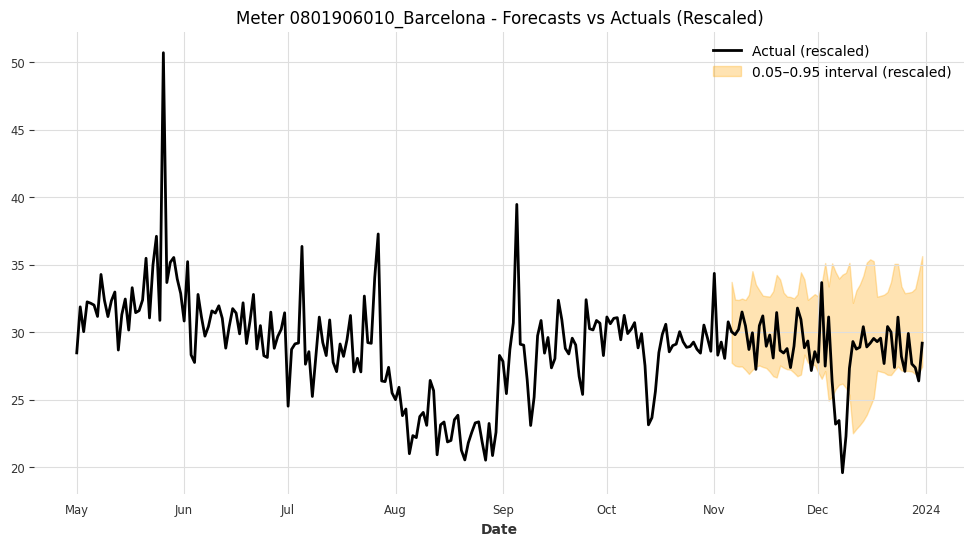

Meter 0801906010_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 6.9558



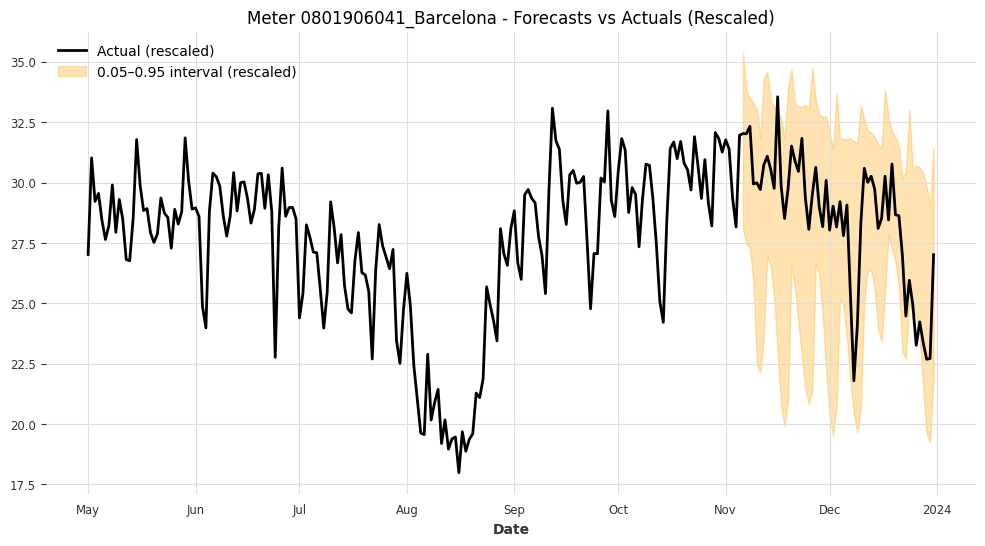

Meter 0801906041_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 8.7033



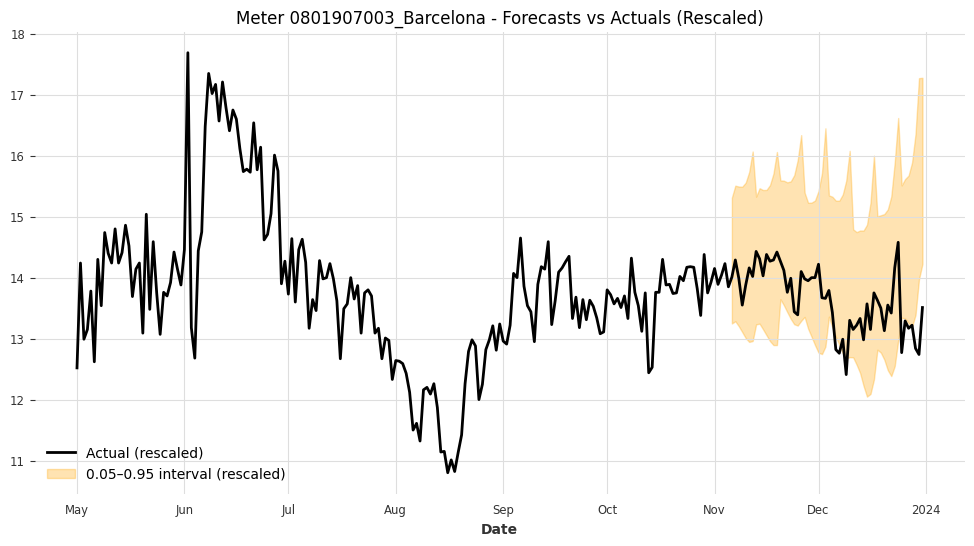

Meter 0801907003_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.5729



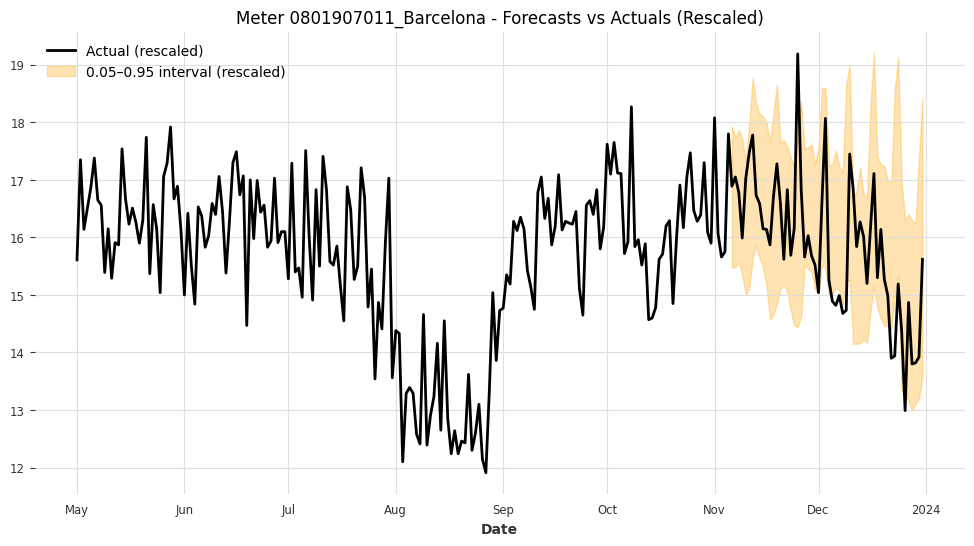

Meter 0801907011_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 2.8796



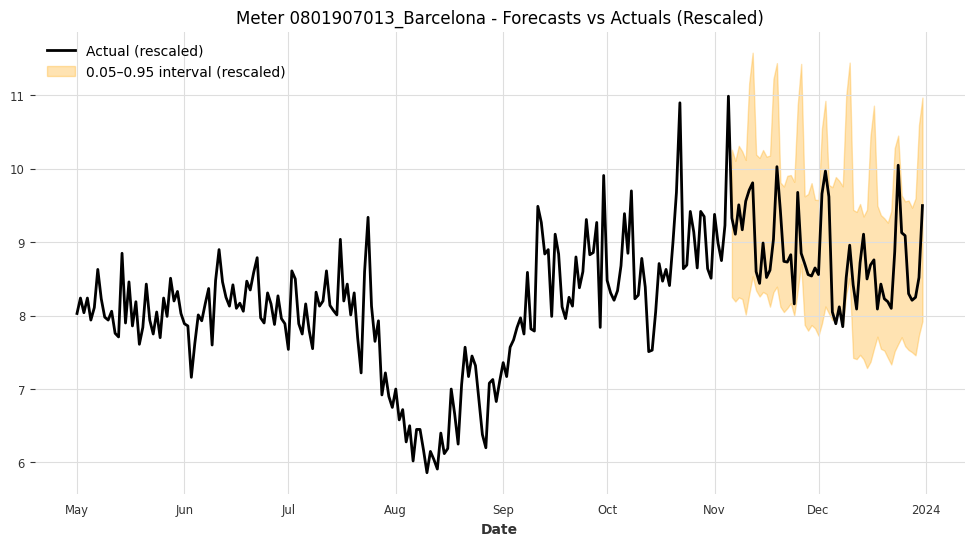

Meter 0801907013_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 2.1878



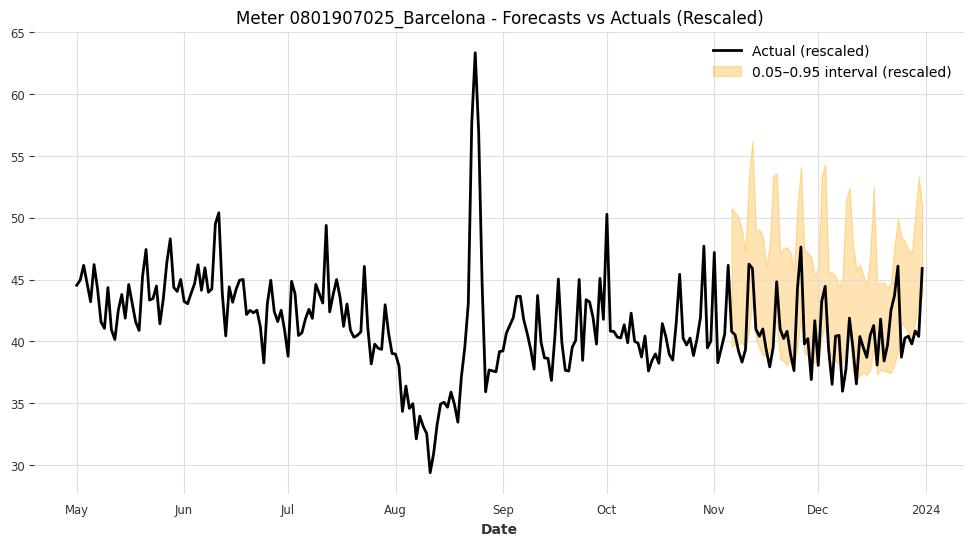

Meter 0801907025_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 9.0513



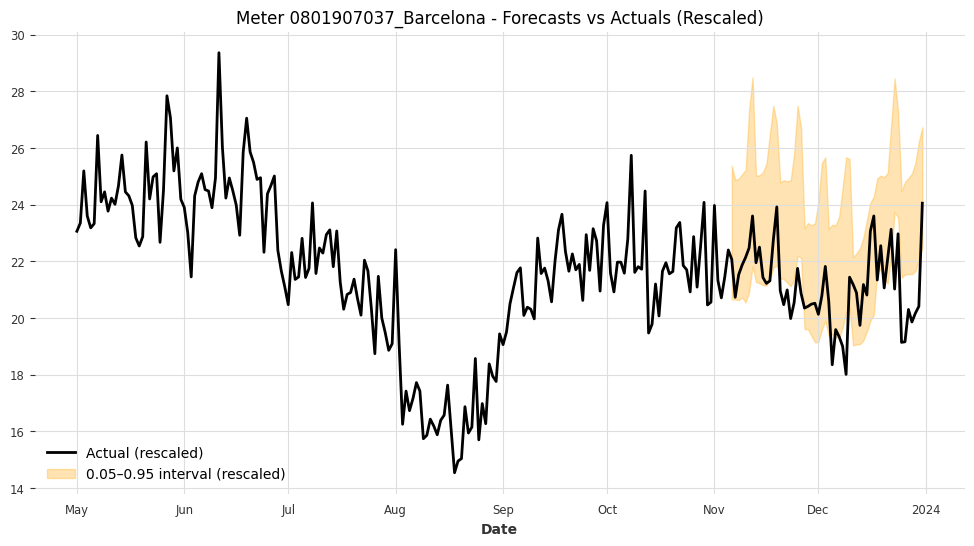

Meter 0801907037_Barcelona - Coverage: 0.6250, Mean Interval Width (rescaled): 4.2370



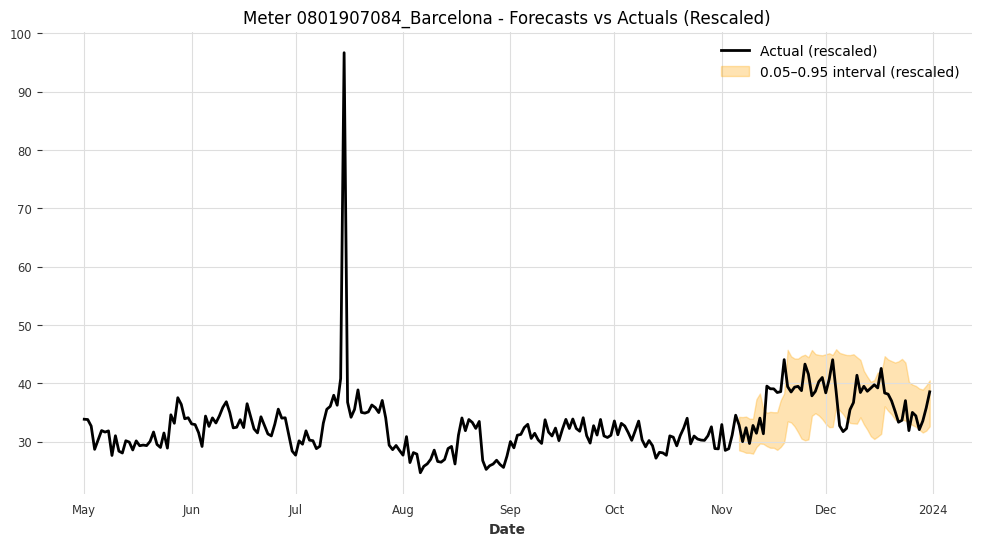

Meter 0801907084_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 9.3973



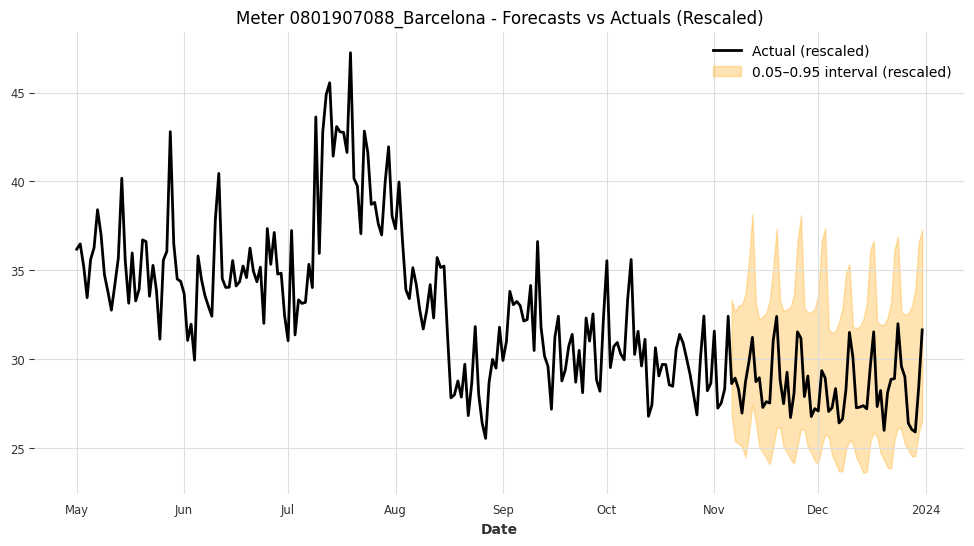

Meter 0801907088_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 8.7039



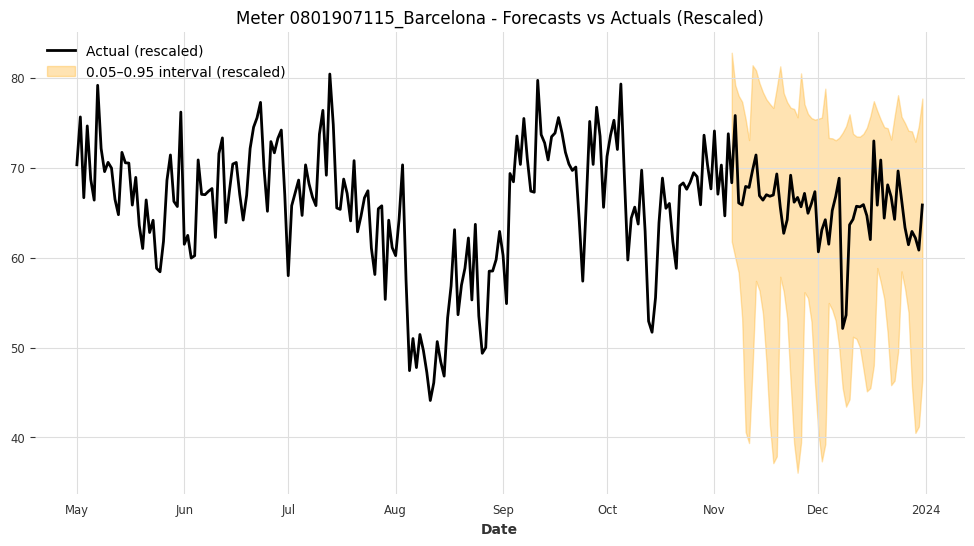

Meter 0801907115_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 27.2452



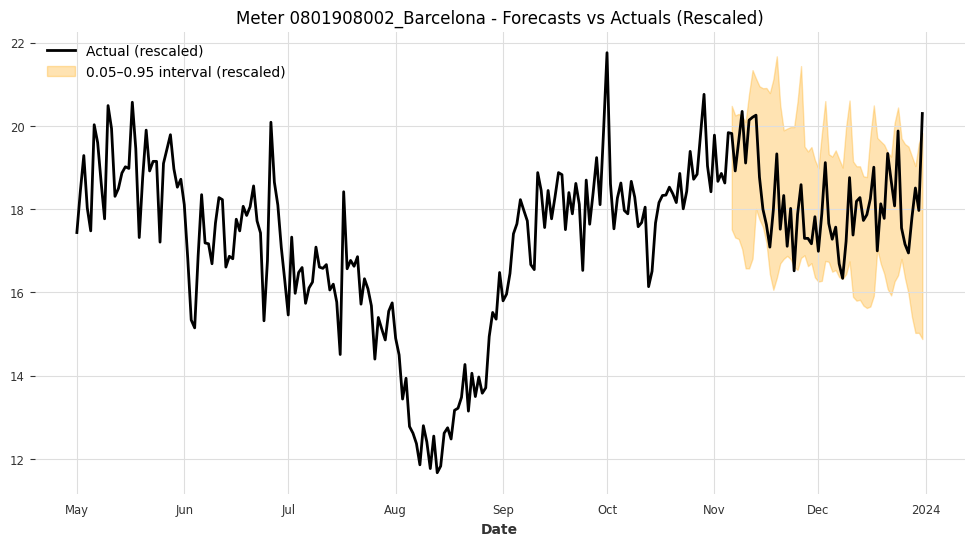

Meter 0801908002_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 3.4738



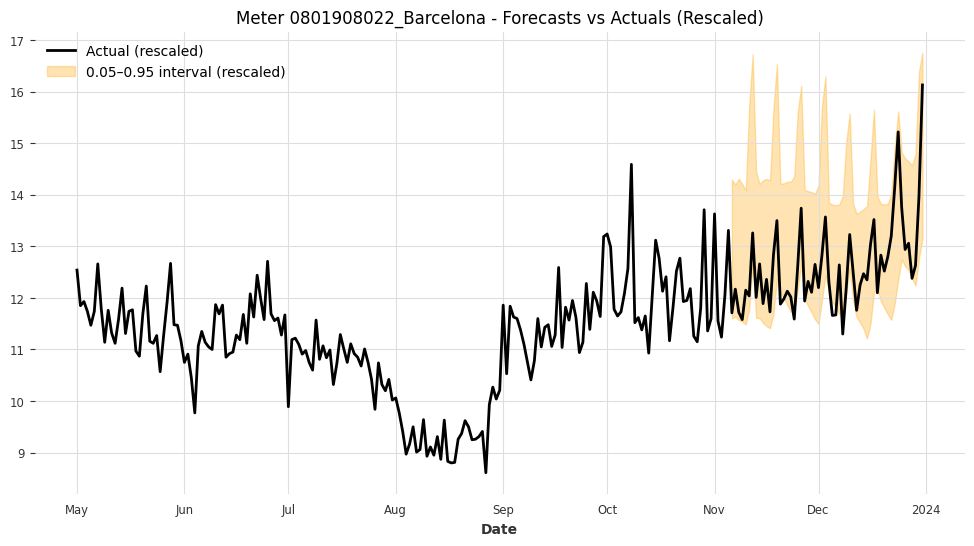

Meter 0801908022_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.6788



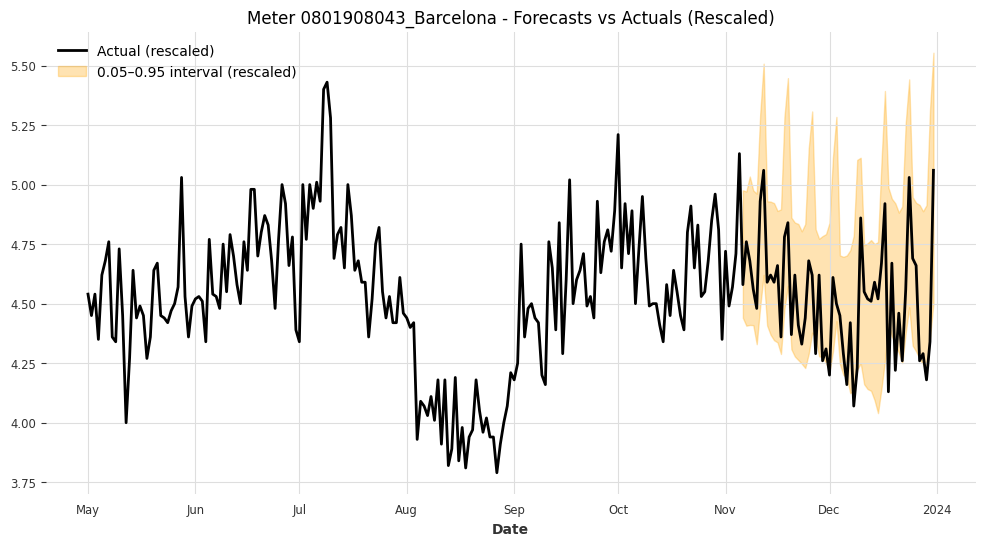

Meter 0801908043_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 0.6760



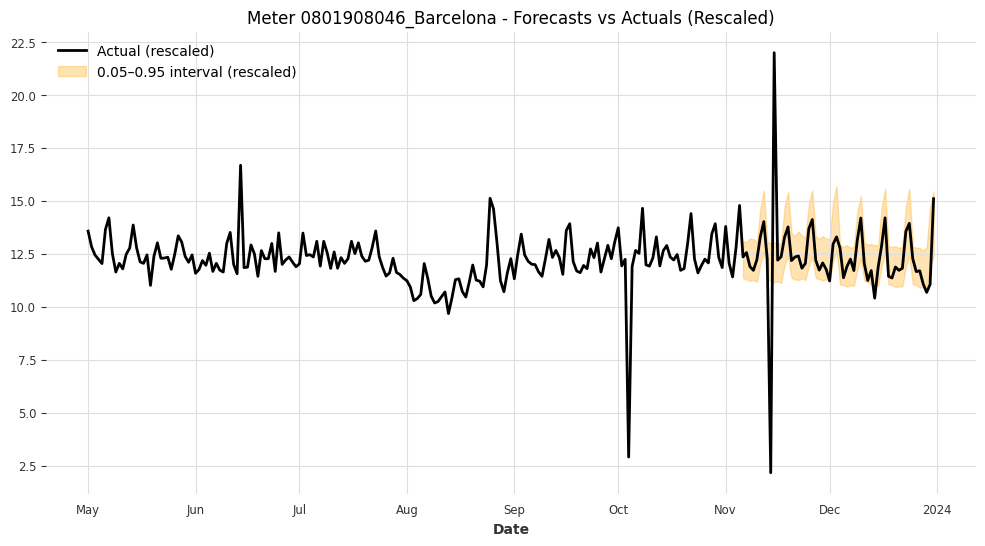

Meter 0801908046_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.1754



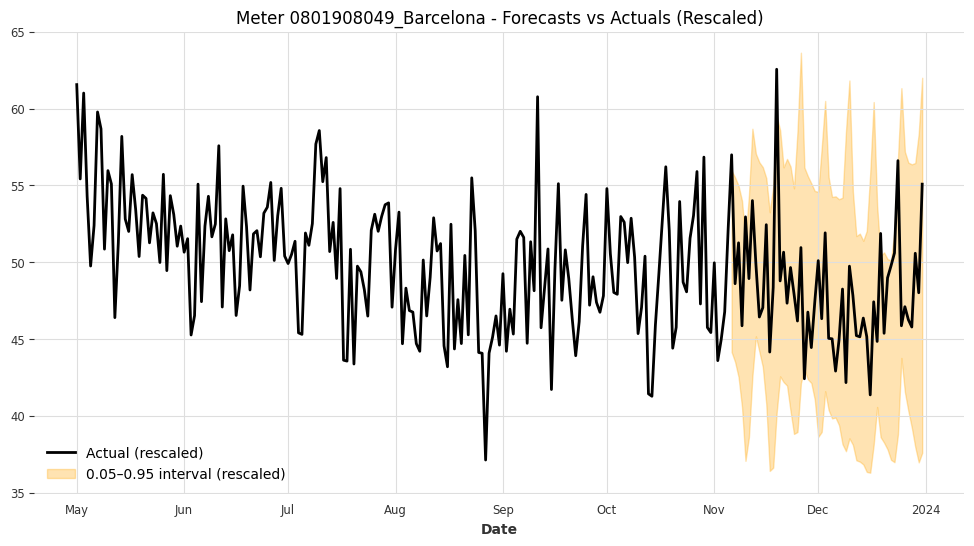

Meter 0801908049_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 15.8853



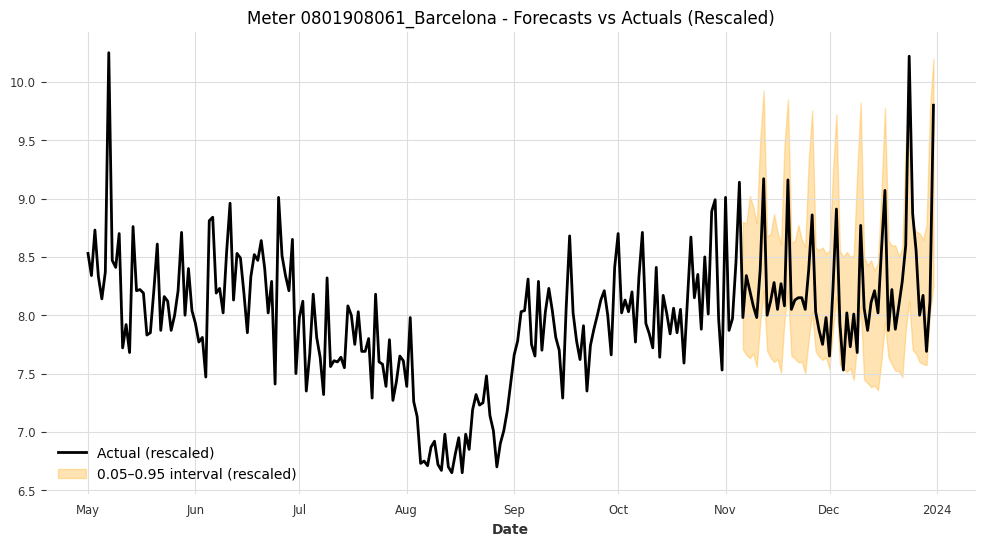

Meter 0801908061_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 1.2248



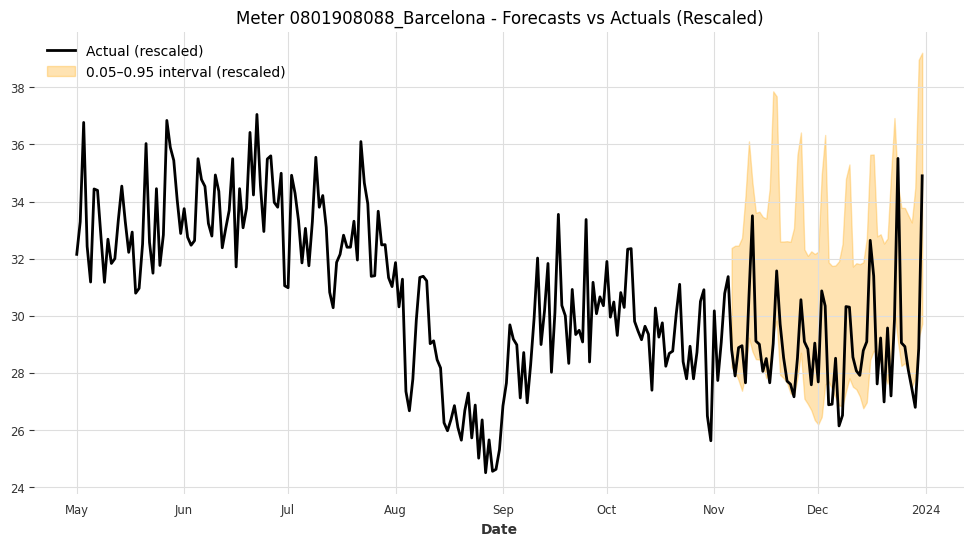

Meter 0801908088_Barcelona - Coverage: 0.6786, Mean Interval Width (rescaled): 5.8821



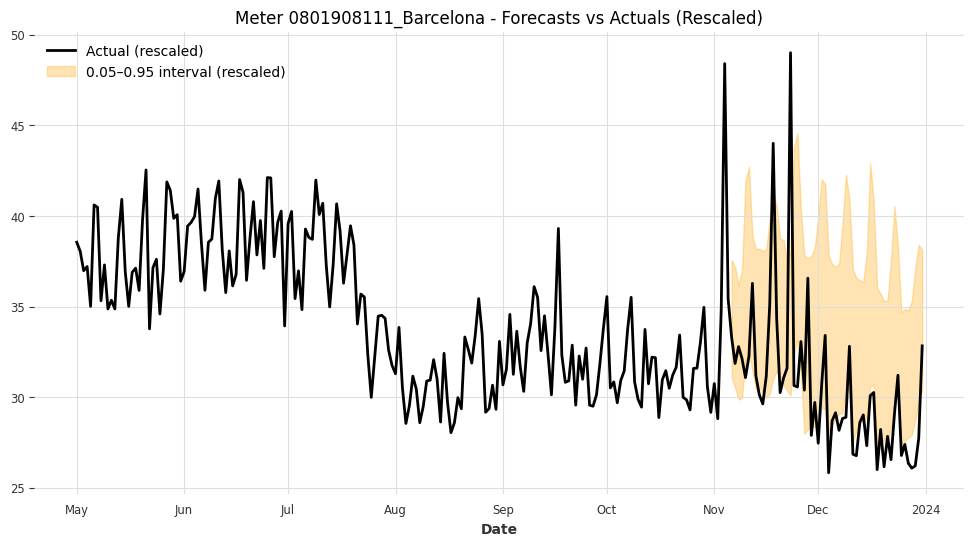

Meter 0801908111_Barcelona - Coverage: 0.4643, Mean Interval Width (rescaled): 8.9363



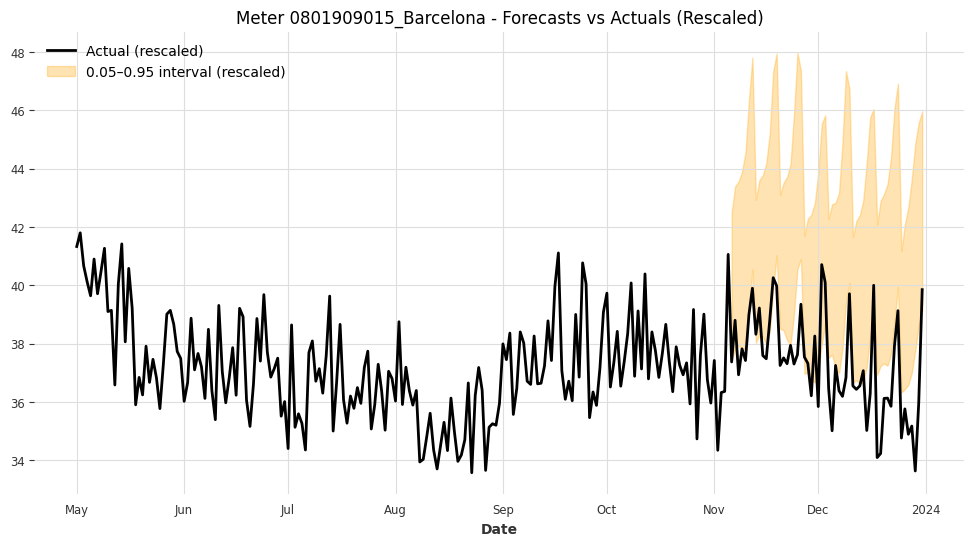

Meter 0801909015_Barcelona - Coverage: 0.2679, Mean Interval Width (rescaled): 6.2122



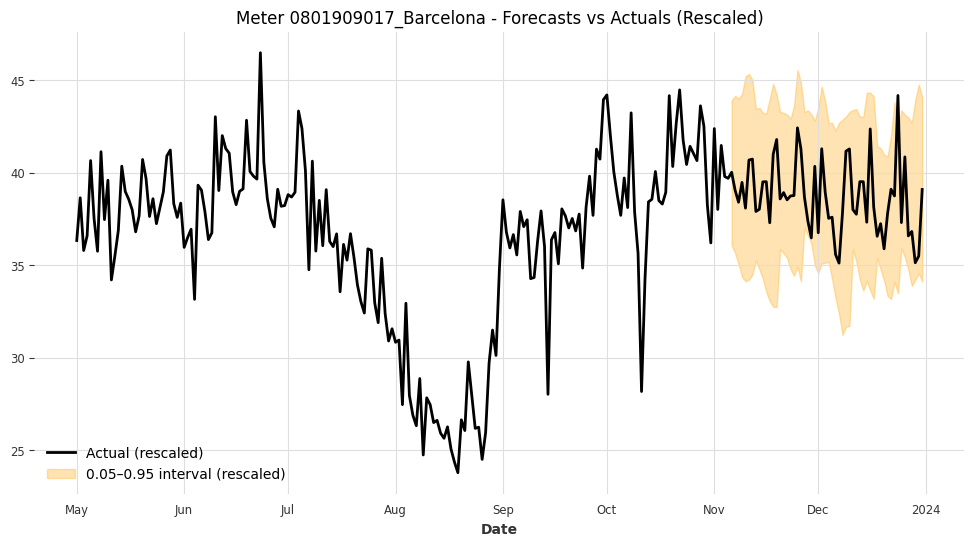

Meter 0801909017_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 9.0464



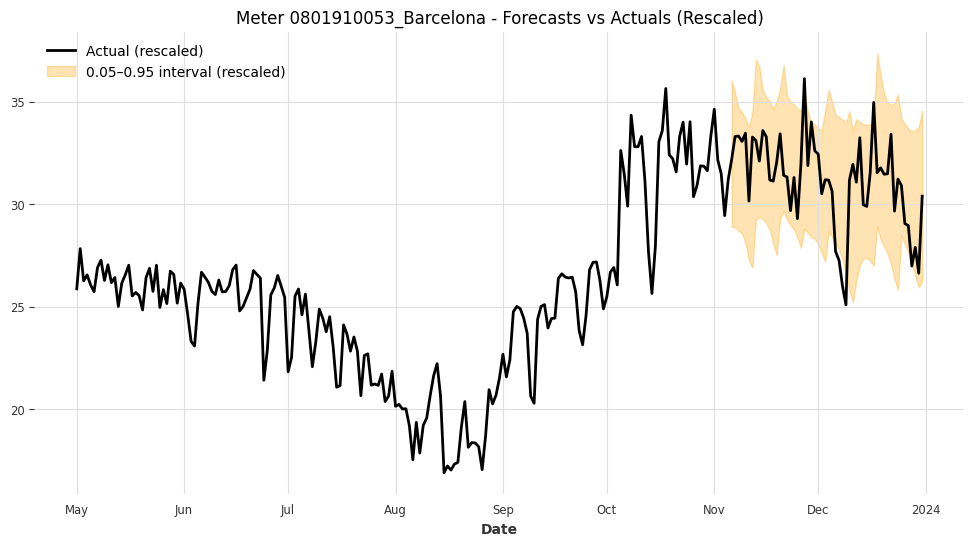

Meter 0801910053_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 6.8635



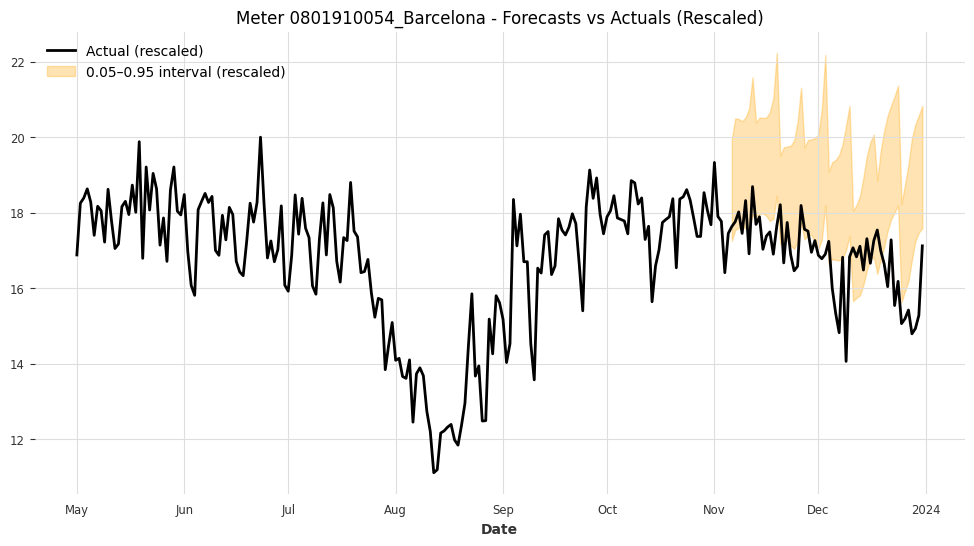

Meter 0801910054_Barcelona - Coverage: 0.3750, Mean Interval Width (rescaled): 2.9155



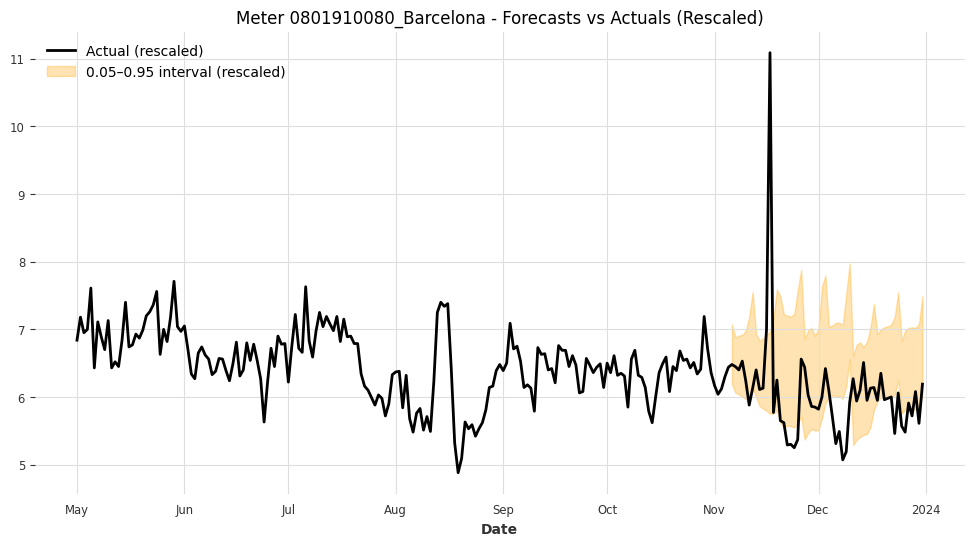

Meter 0801910080_Barcelona - Coverage: 0.6071, Mean Interval Width (rescaled): 1.3139



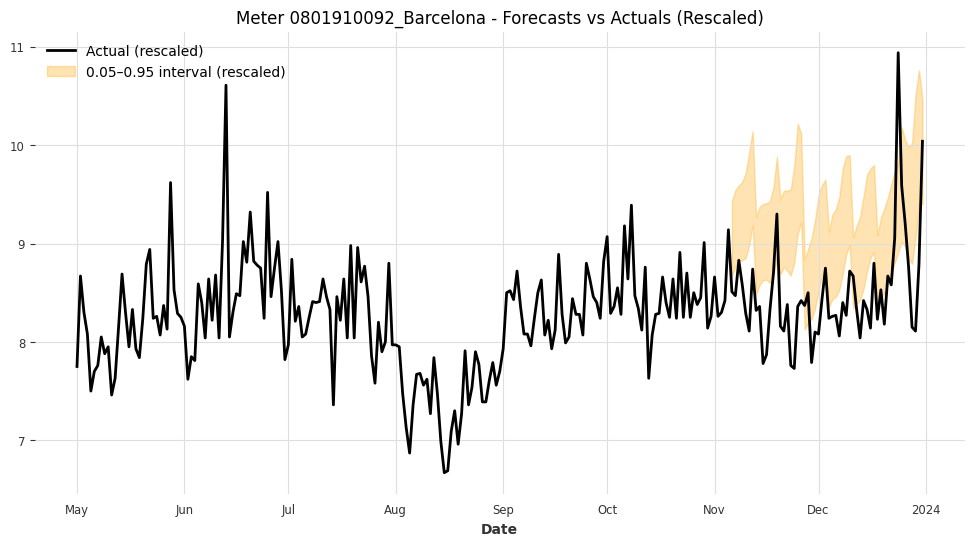

Meter 0801910092_Barcelona - Coverage: 0.2143, Mean Interval Width (rescaled): 0.9108



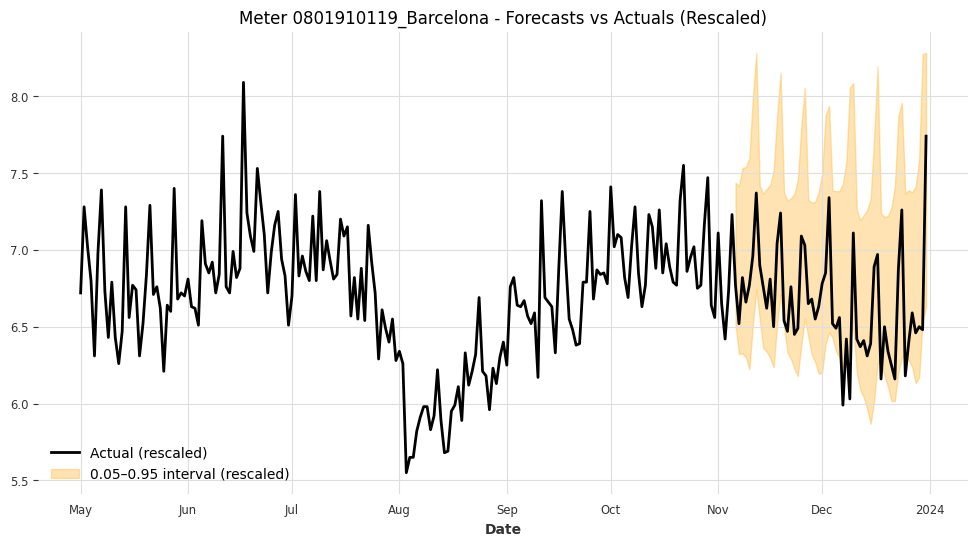

Meter 0801910119_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 1.2618



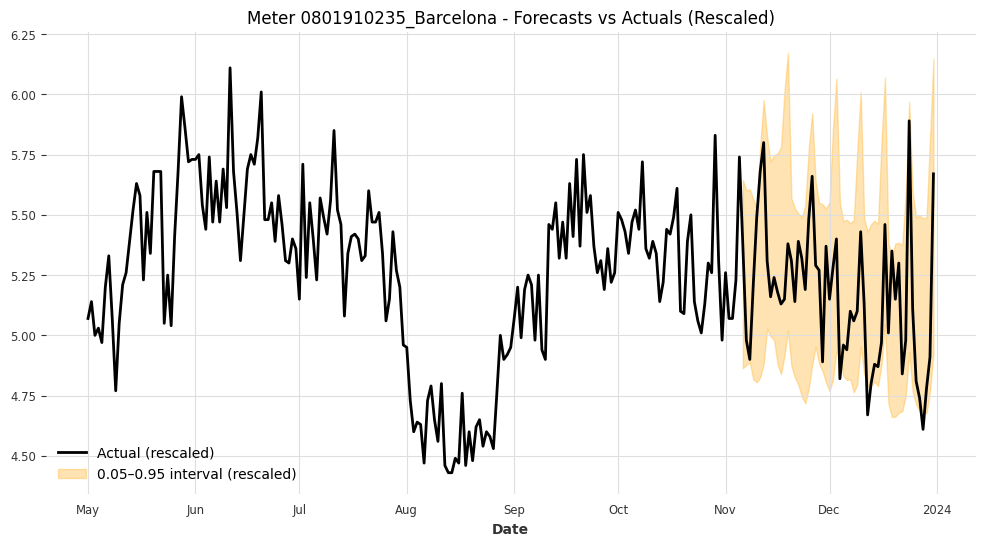

Meter 0801910235_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 0.8163



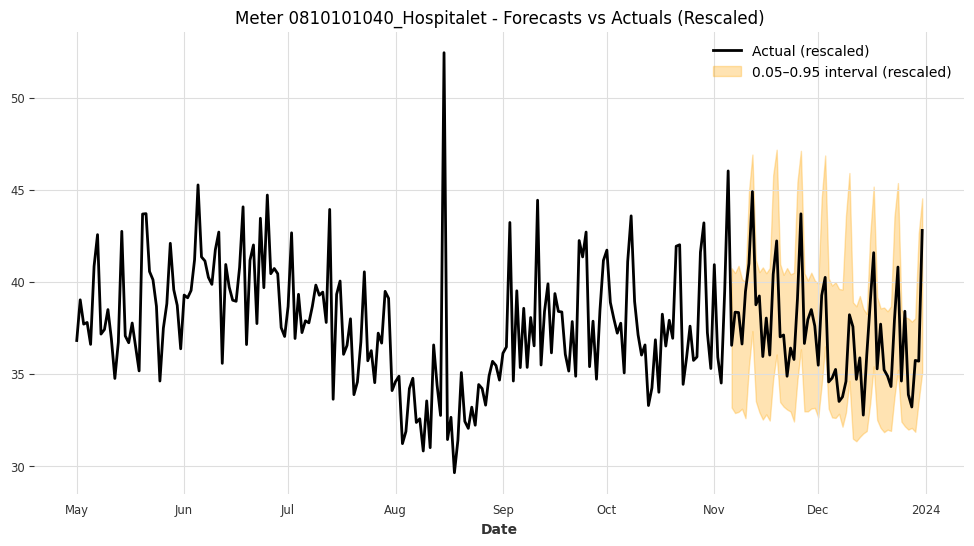

Meter 0810101040_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 8.0028



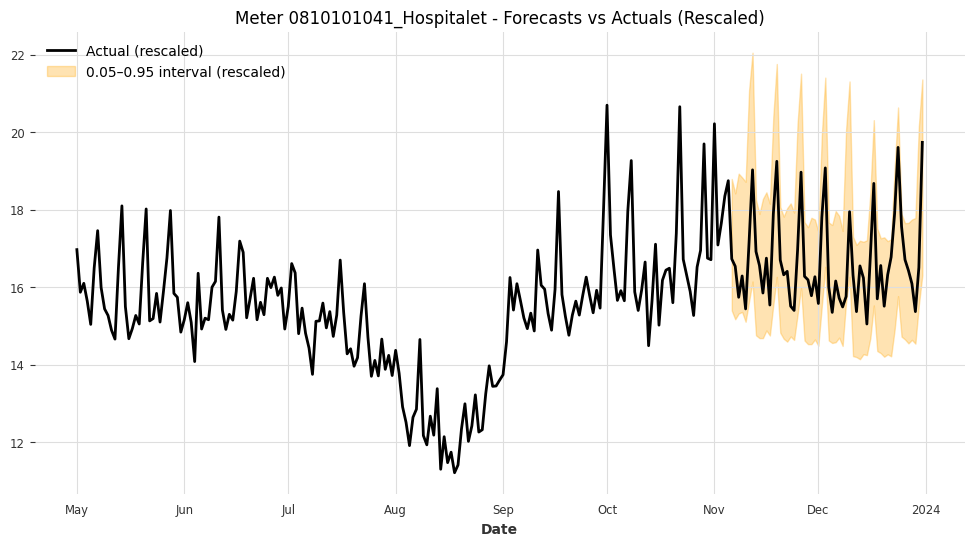

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 3.6781



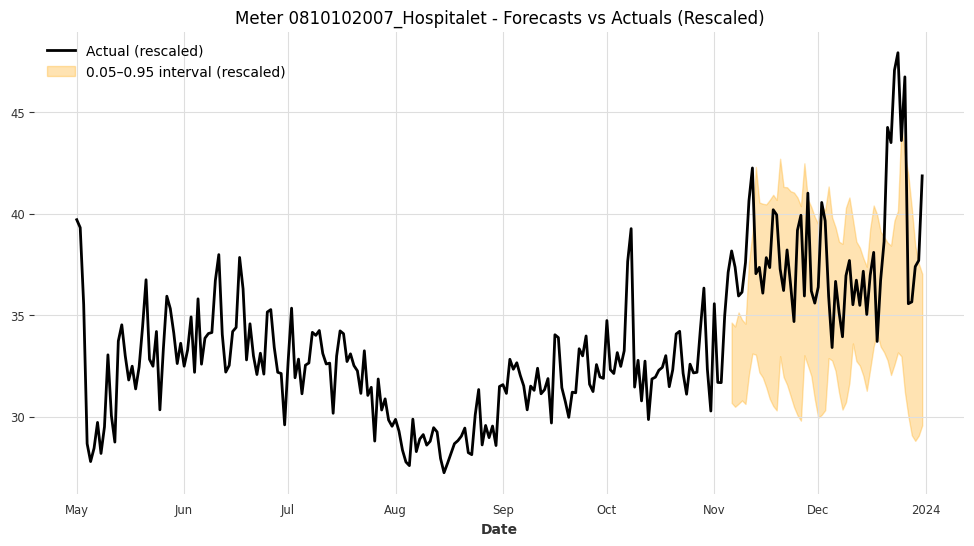

Meter 0810102007_Hospitalet - Coverage: 0.6964, Mean Interval Width (rescaled): 8.0104



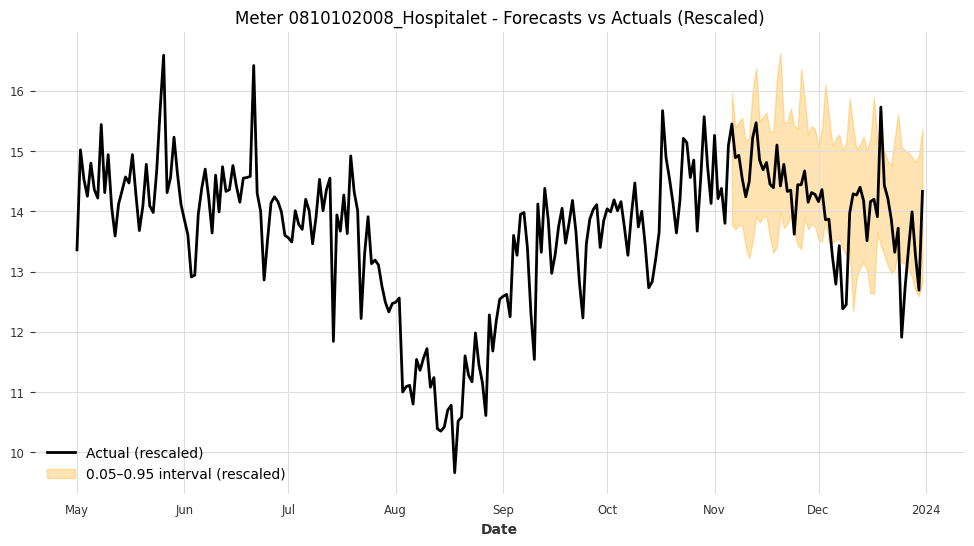

Meter 0810102008_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.0115



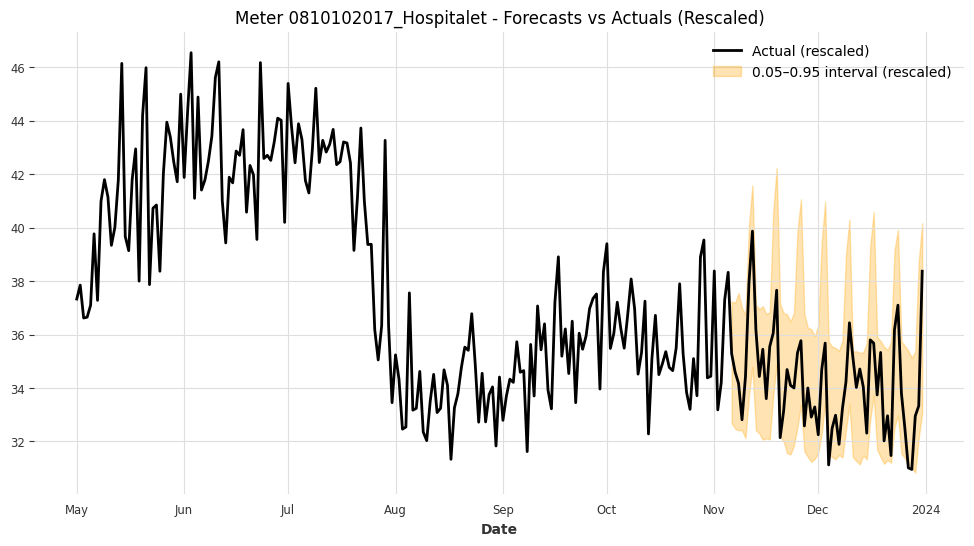

Meter 0810102017_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 5.2121



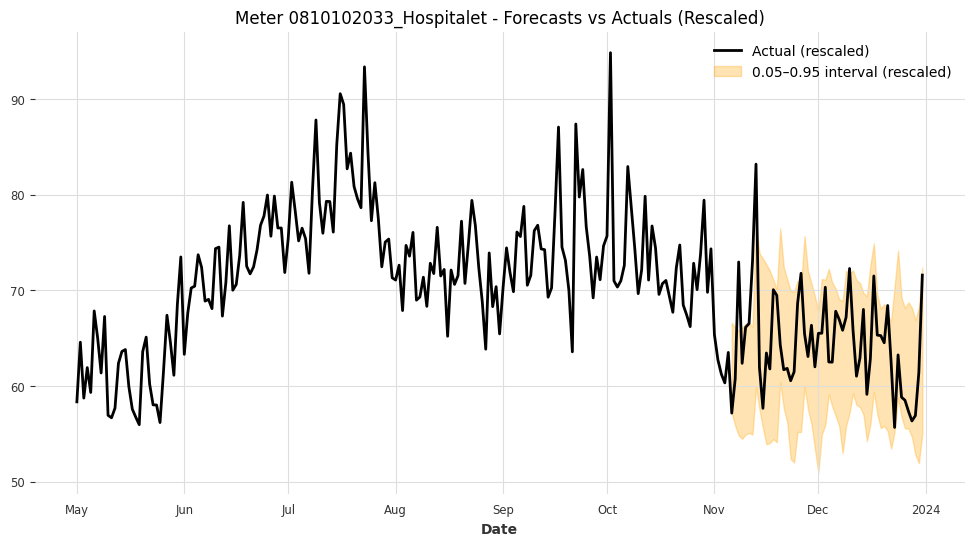

Meter 0810102033_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 14.4743



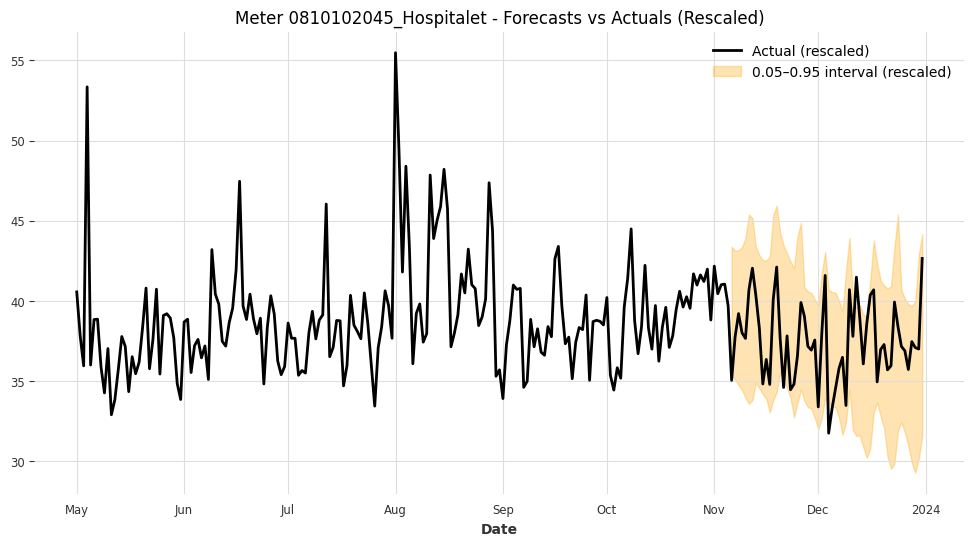

Meter 0810102045_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 9.2089



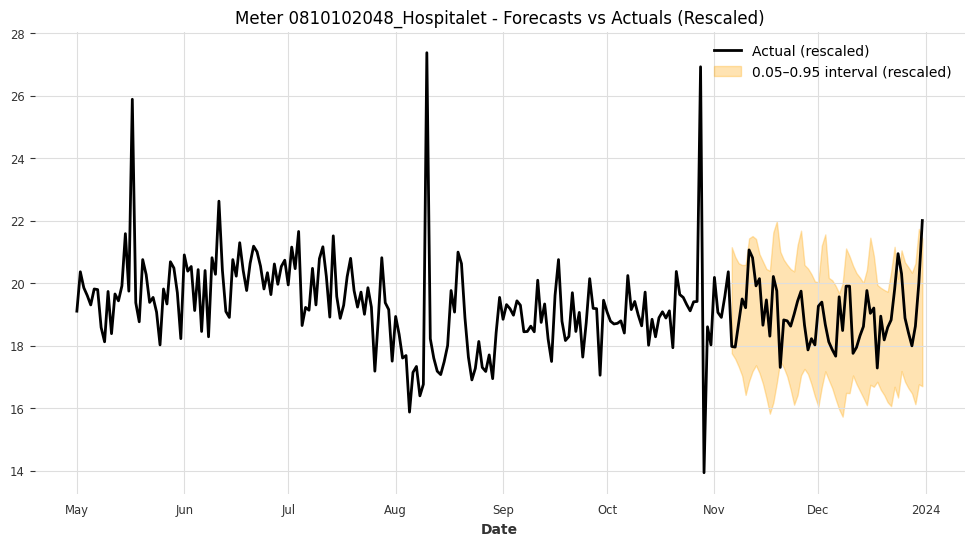

Meter 0810102048_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.9797



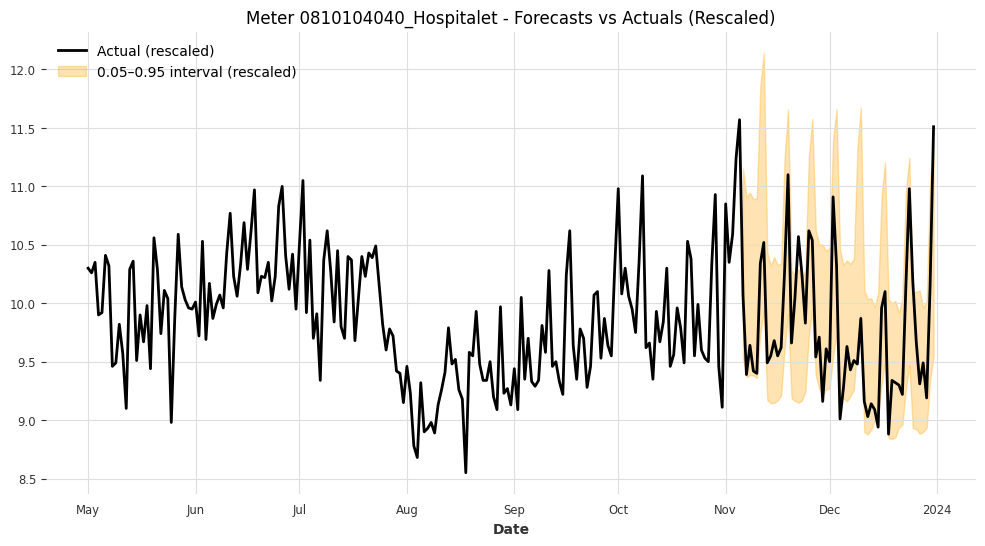

Meter 0810104040_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 1.3630



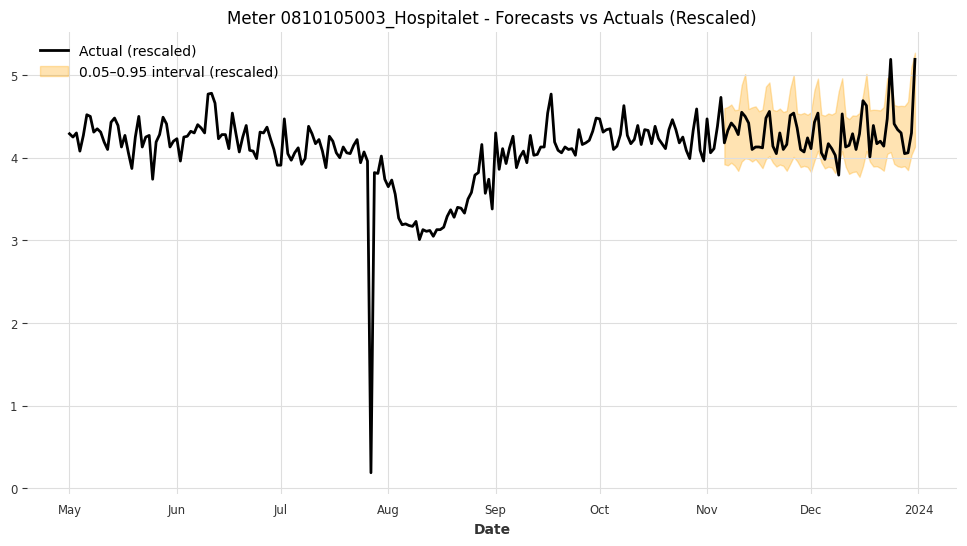

Meter 0810105003_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.7504



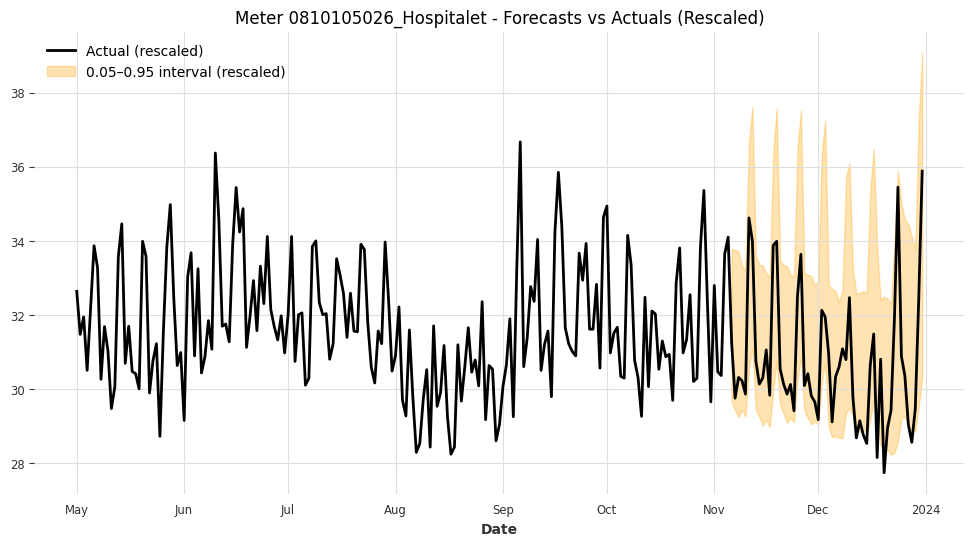

Meter 0810105026_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 4.8711



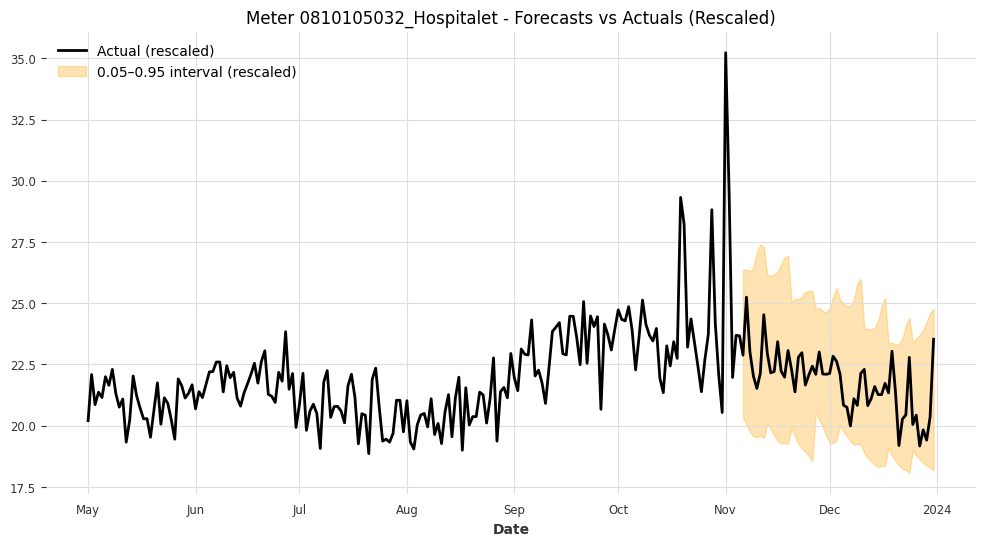

Meter 0810105032_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 5.9356



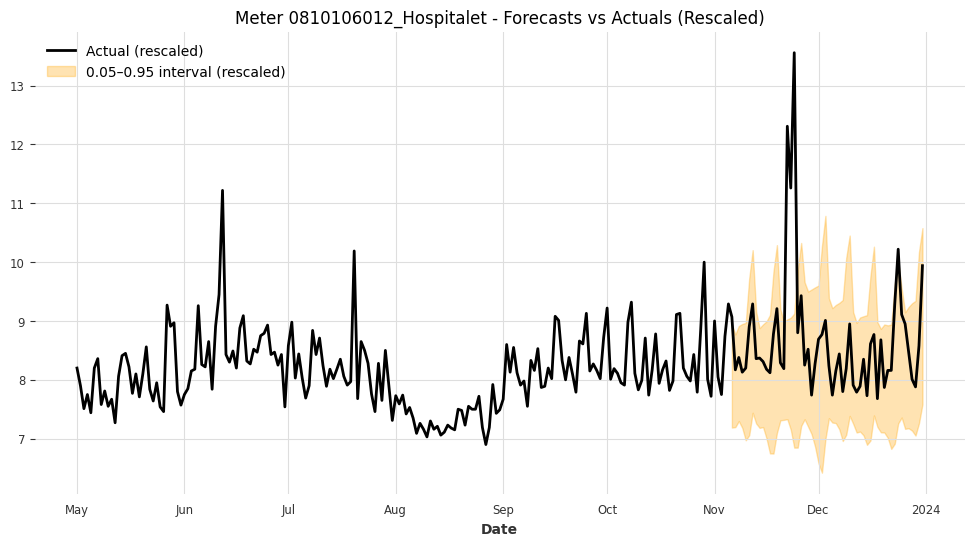

Meter 0810106012_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.3173



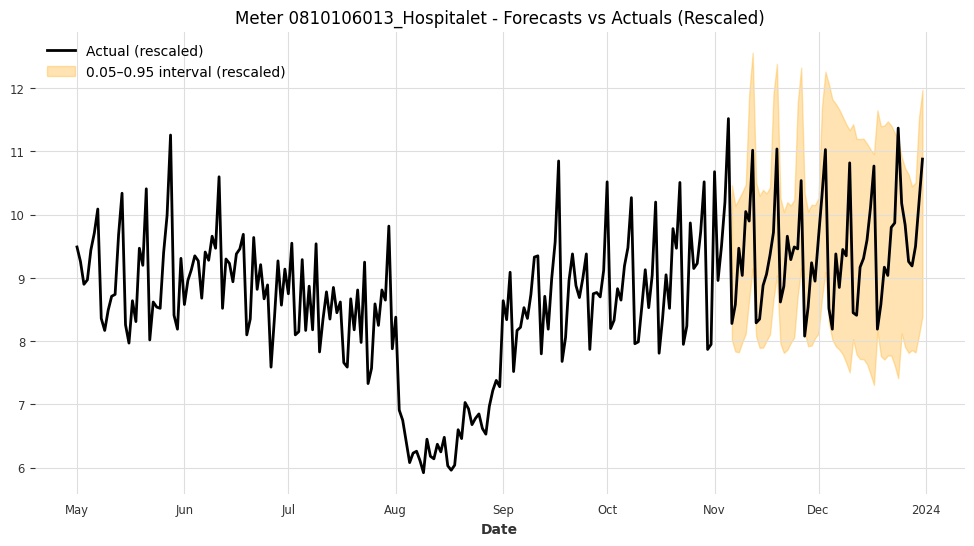

Meter 0810106013_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 3.0168



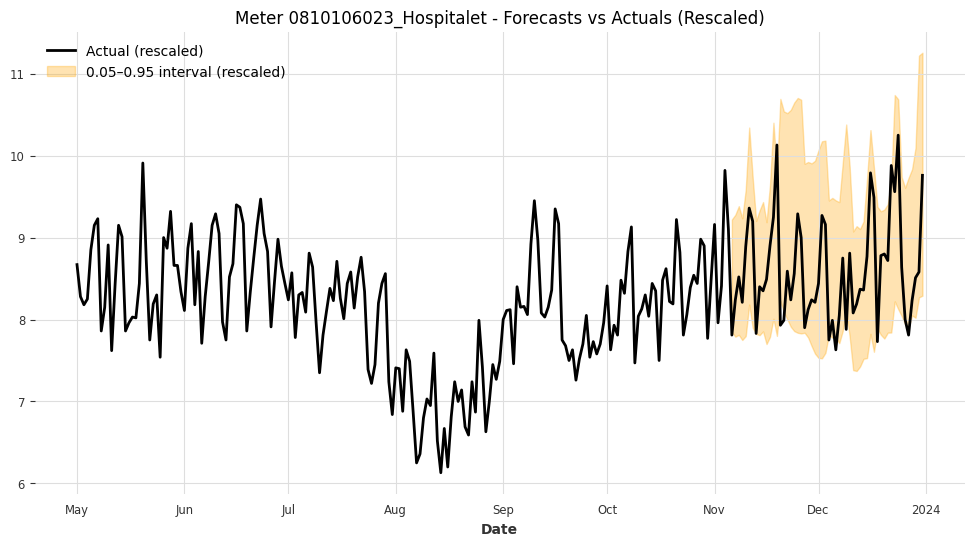

Meter 0810106023_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.0345



In [19]:
for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [20]:
# Let's try with the specific test set (minmax scaled)

In [25]:
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [26]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  2.023996


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  3.609062


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903021_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  1.377636


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903026_Barcelona:
    Interval  Coverage     Width
0       0.9  0.982143  2.345688


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.834071


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  1.773777


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903213_Barcelona:
    Interval  Coverage    Width
0       0.9  0.946429  0.49448


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904027_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  3.871787


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904047_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  4.398041


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904049_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  4.084767


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905057_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  4.235259


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906071_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  1.431805


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910007_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  1.089879


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0807302003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  5.524547


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0807710008_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.839286  84.134569


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101004_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  8.491664


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  3.455126


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101018_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  1.577677


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101019_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  2.065245


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101024_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  3.340547


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101029_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  6.999325


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101033_Hospitalet:
    Interval  Coverage    Width
0       0.9     0.875  5.42567


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  4.412141


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.928571  7.36696


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102005_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  3.257242


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.660714  6.226475


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  4.583287


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102024_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  2.779928


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102034_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  7.690865


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102038_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  5.244402


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  6.190344


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  9.089554


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  5.318851


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102049_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.892857  4.13968


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103002_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.732143  0.851206


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103006_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  6.537311


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  4.036996


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103012_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.964286  0.48339


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103018_Hospitalet:
    Interval  Coverage   Width
0       0.9  0.892857  2.1433


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103022_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  3.504715


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  4.388905


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104010_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  2.808248


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  4.865444


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.737243


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104035_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  0.969755


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.706951


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105001_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  0.932311


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  5.916035


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105018_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  2.636007


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106005_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  2.421751


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  1.751806


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106010_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  1.402493


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106014_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  1.229212


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  1.104012


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106019_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.362716


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106021_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  2.273836


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106022_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.910714  0.96863


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  2.116415


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  0.768847


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106032_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  1.952823


In [27]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.9095
Mean Width: 4.6959


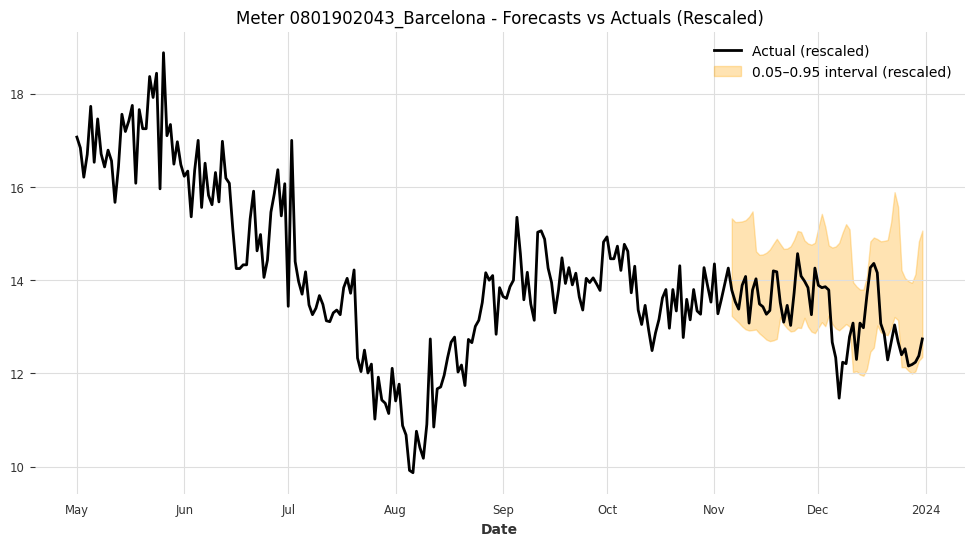

Meter 0801902043_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.0240



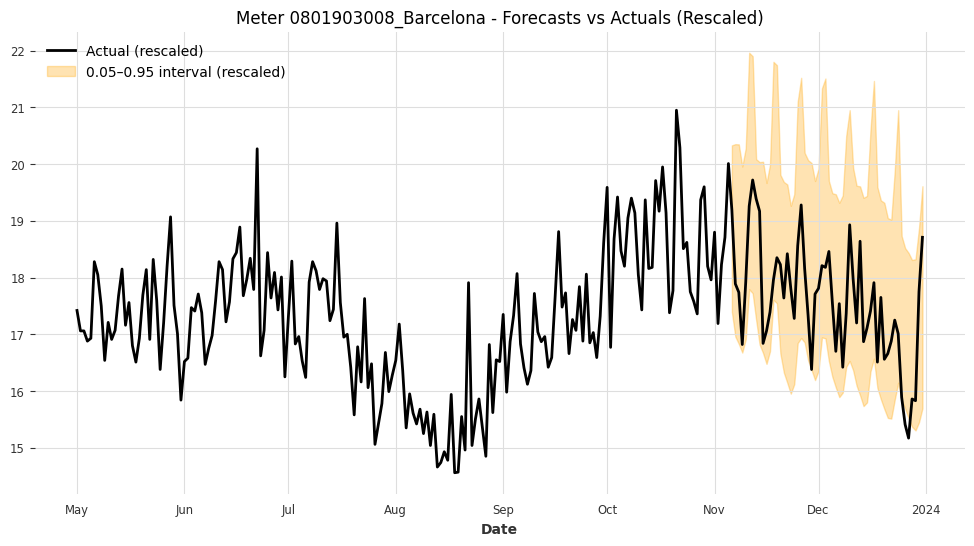

Meter 0801903008_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 3.6091



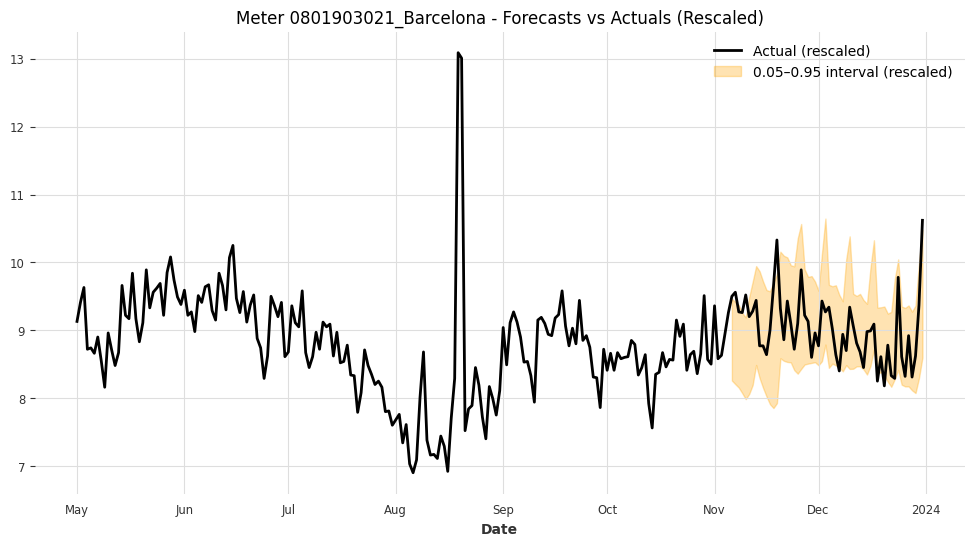

Meter 0801903021_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 1.3776



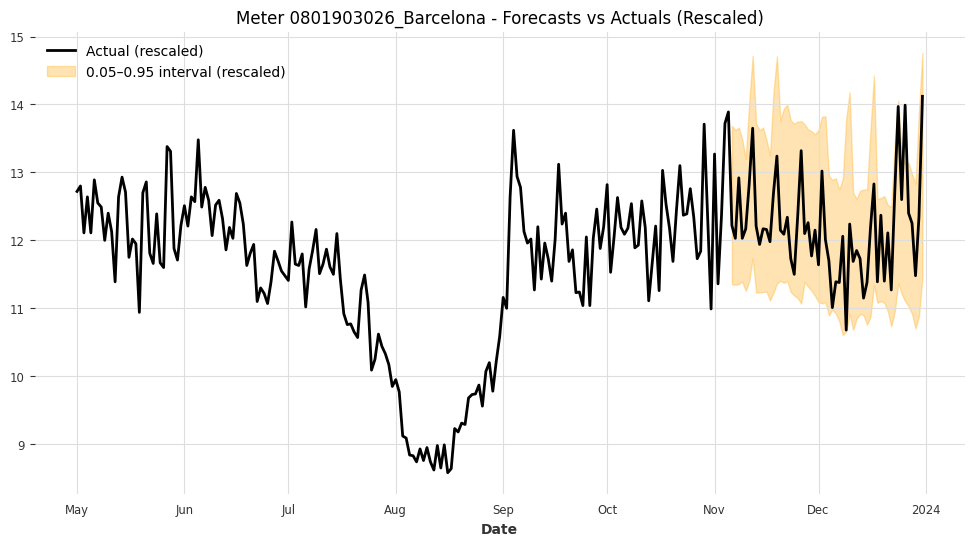

Meter 0801903026_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.3457



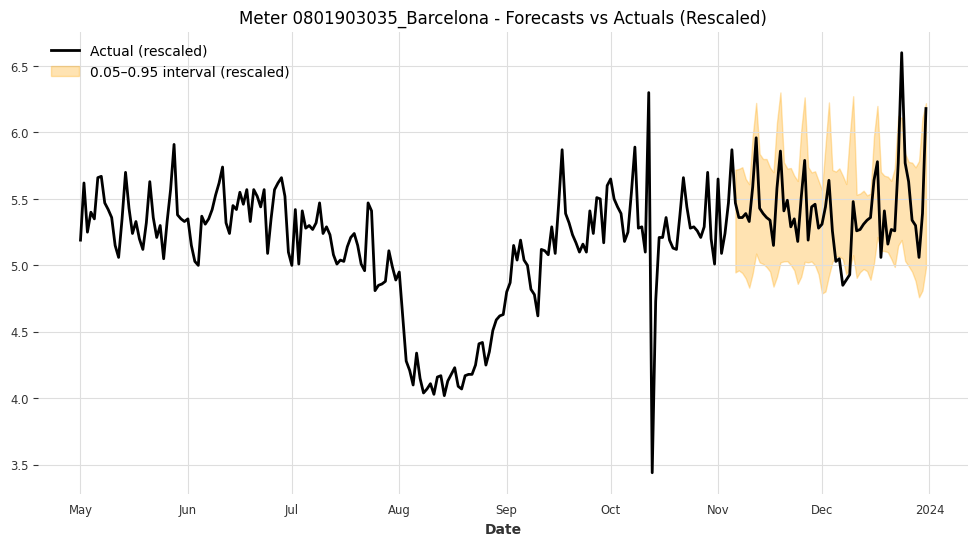

Meter 0801903035_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.8341



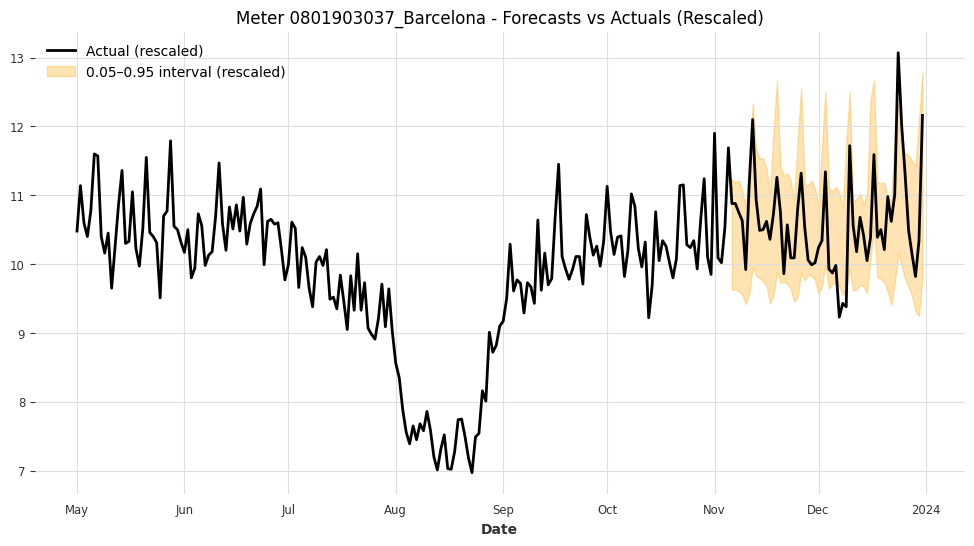

Meter 0801903037_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 1.7738



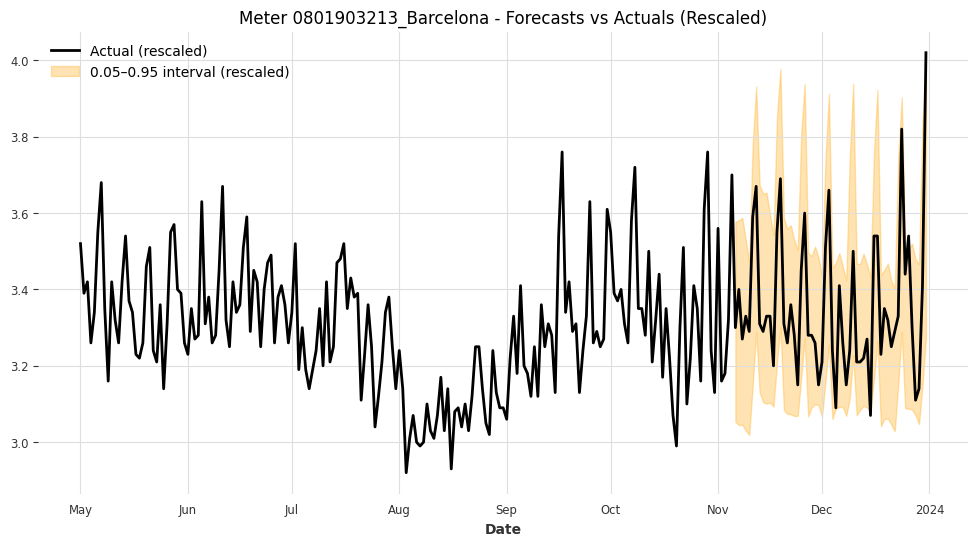

Meter 0801903213_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 0.4945



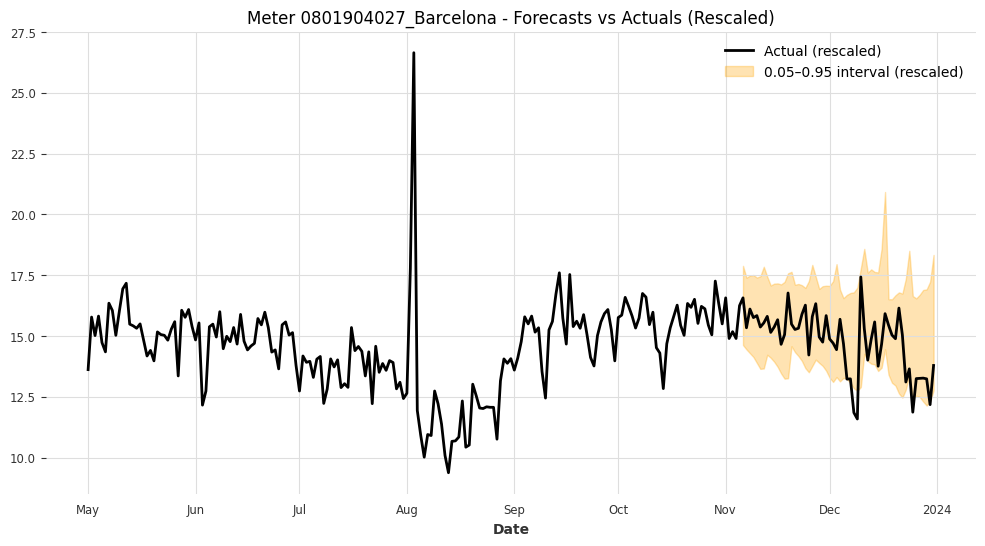

Meter 0801904027_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 3.8718



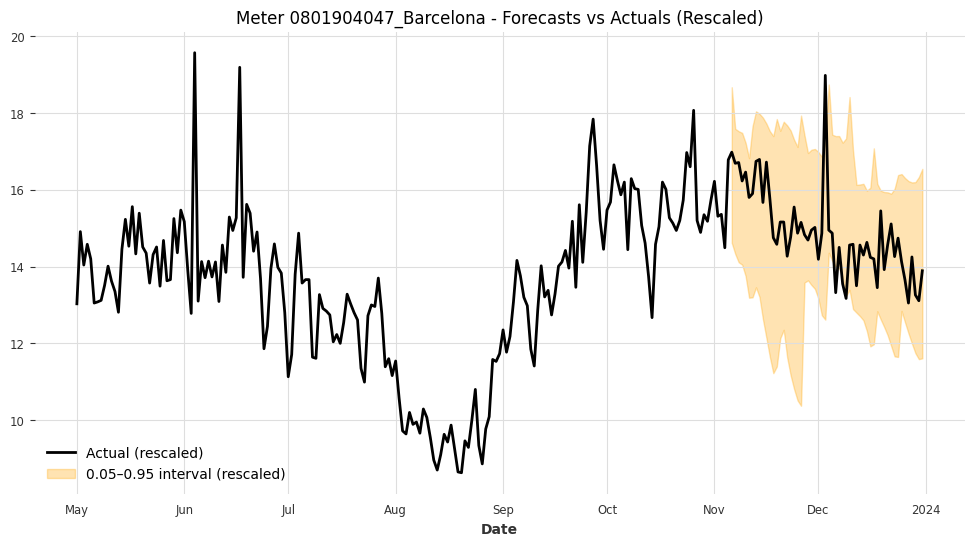

Meter 0801904047_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 4.3980



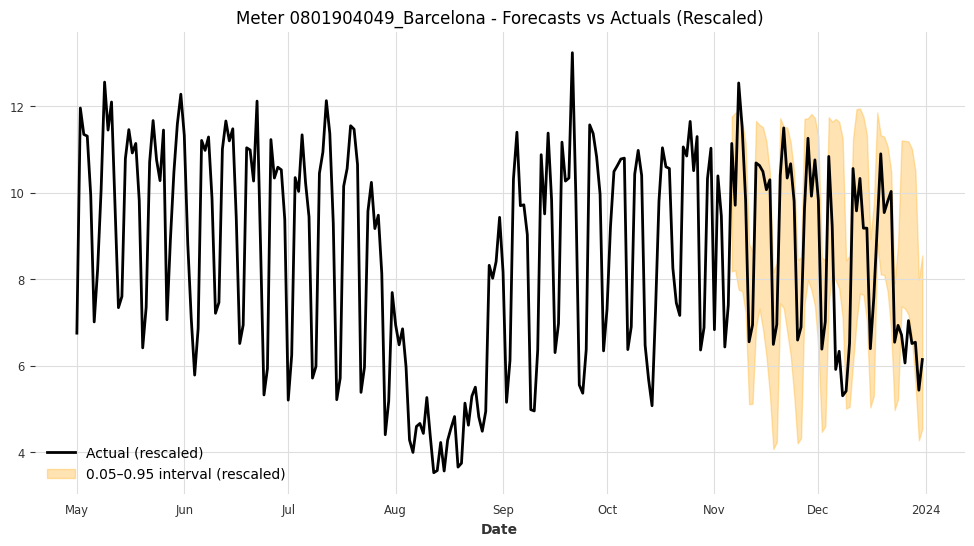

Meter 0801904049_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 4.0848



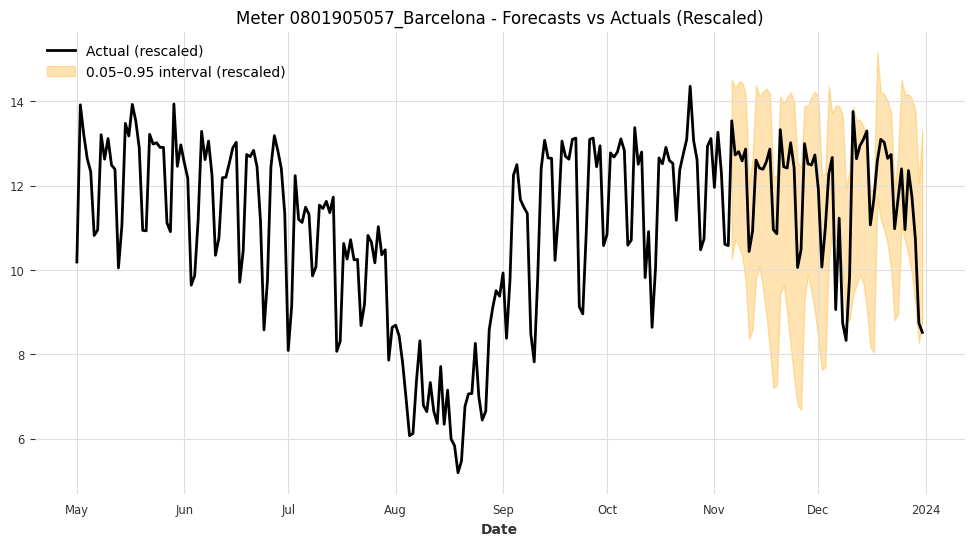

Meter 0801905057_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 4.2353



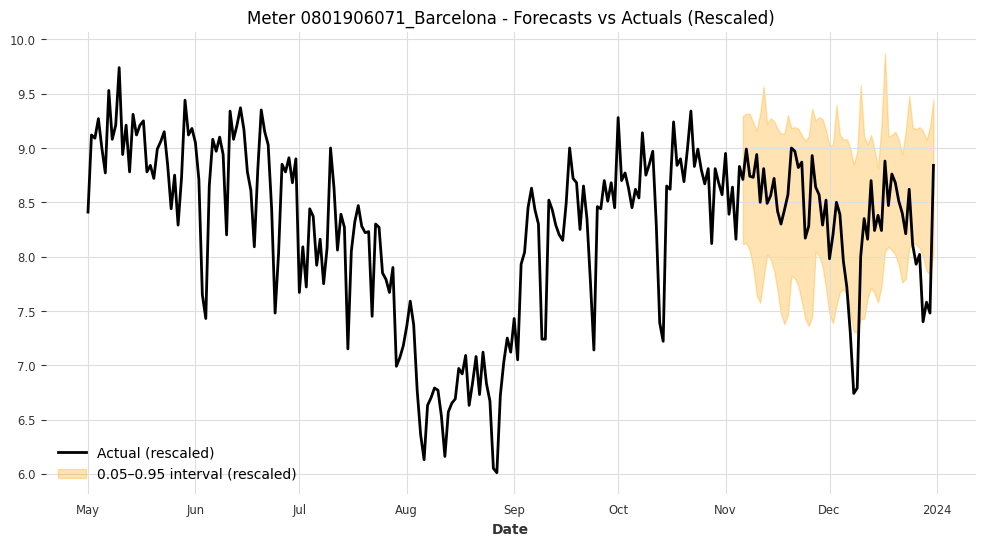

Meter 0801906071_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 1.4318



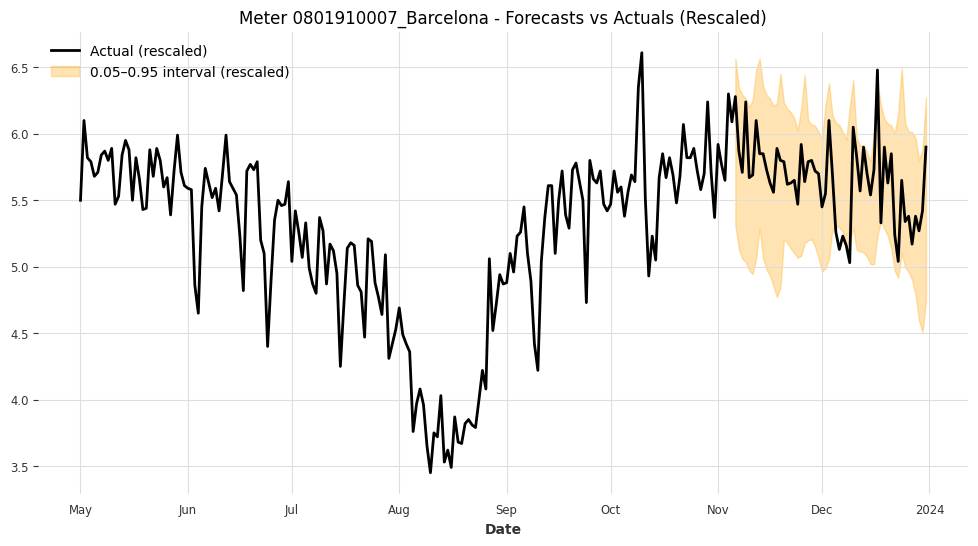

Meter 0801910007_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 1.0899



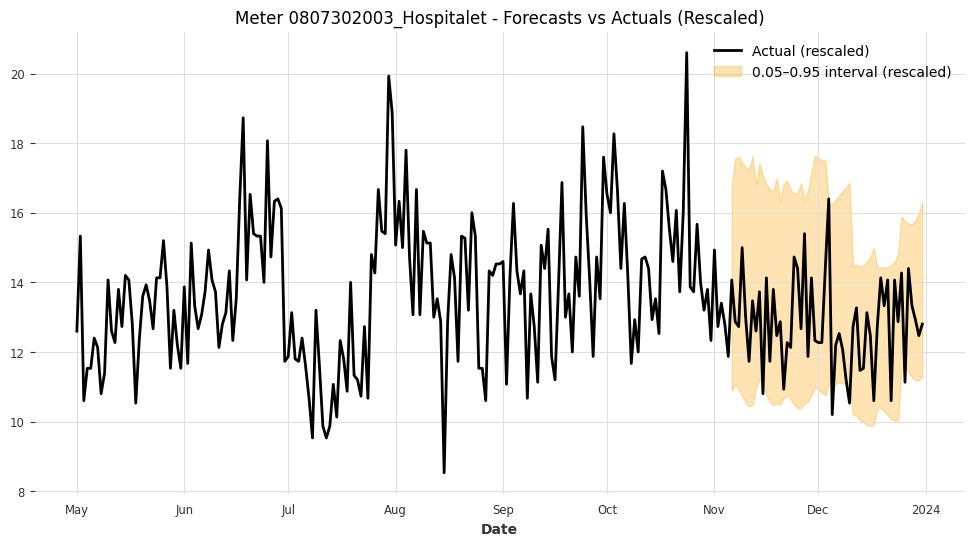

Meter 0807302003_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 5.5245



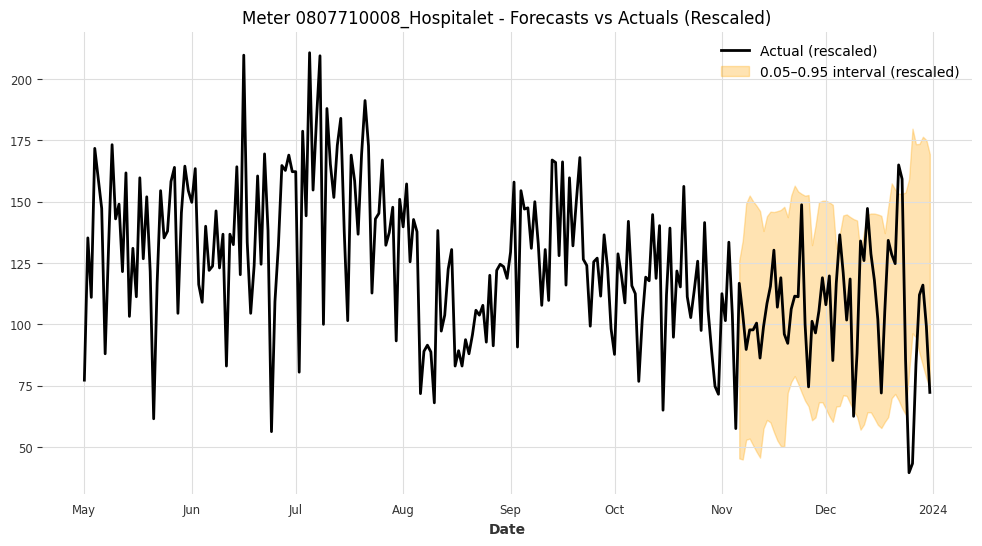

Meter 0807710008_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 84.1346



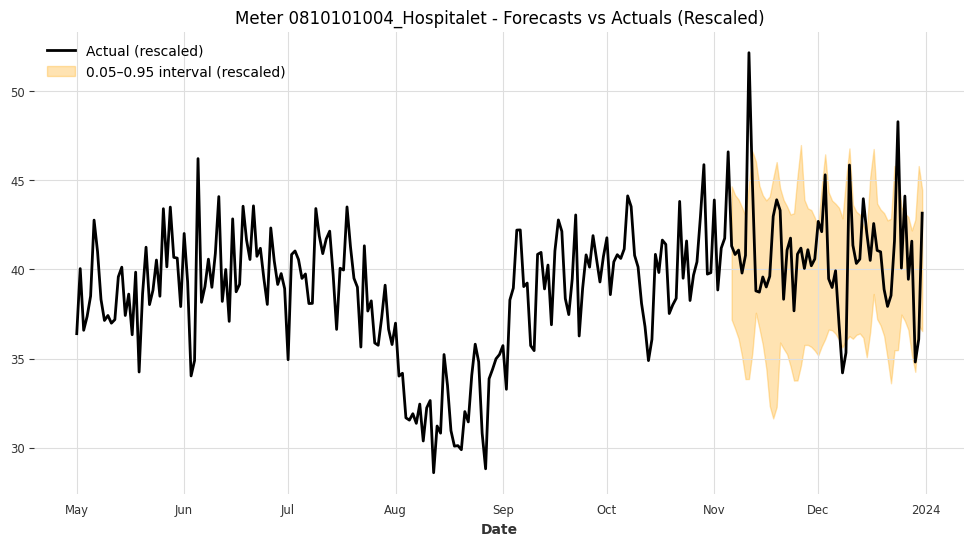

Meter 0810101004_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 8.4917



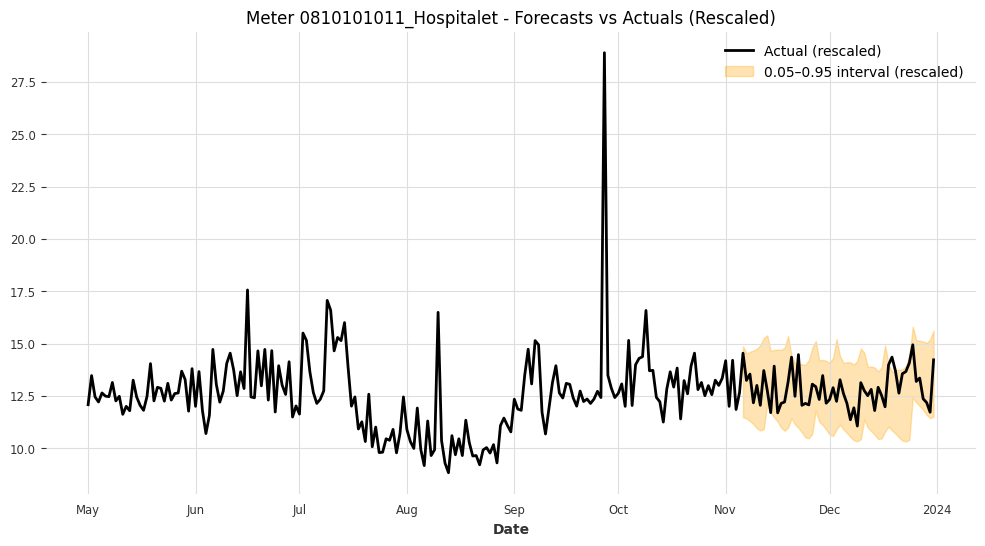

Meter 0810101011_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 3.4551



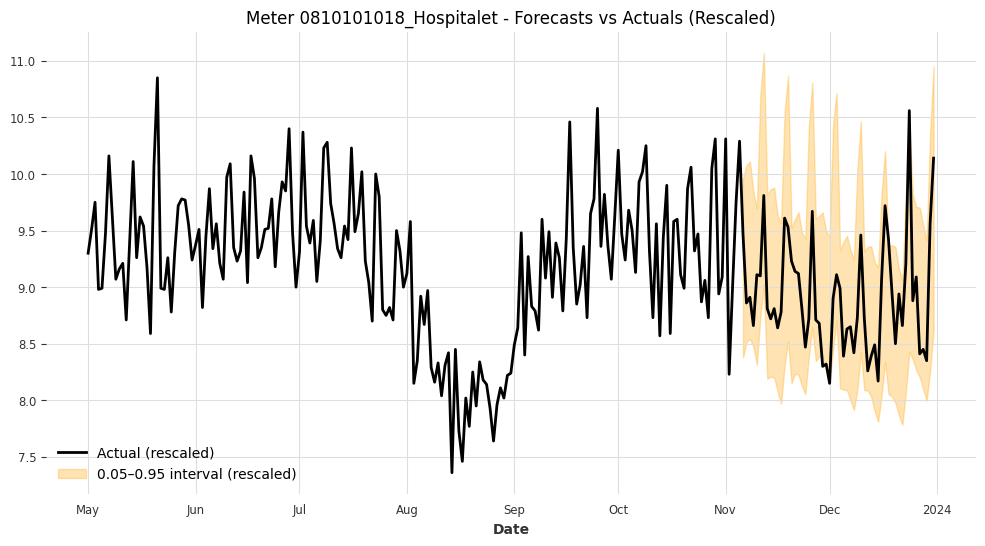

Meter 0810101018_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.5777



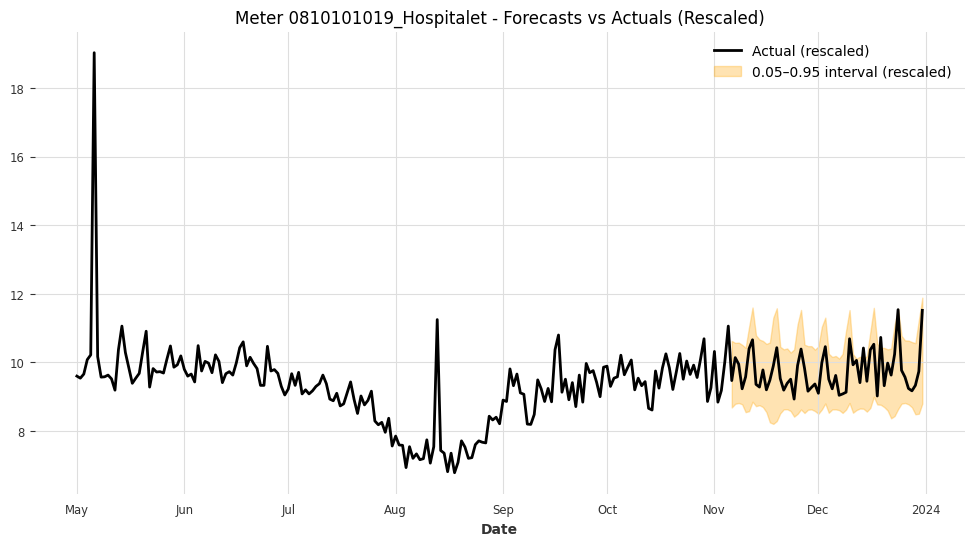

Meter 0810101019_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 2.0652



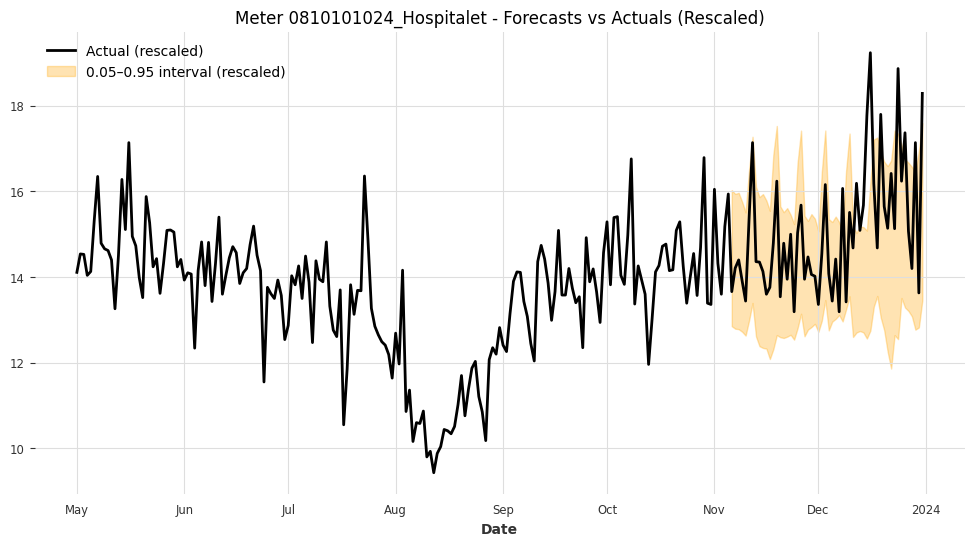

Meter 0810101024_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 3.3405



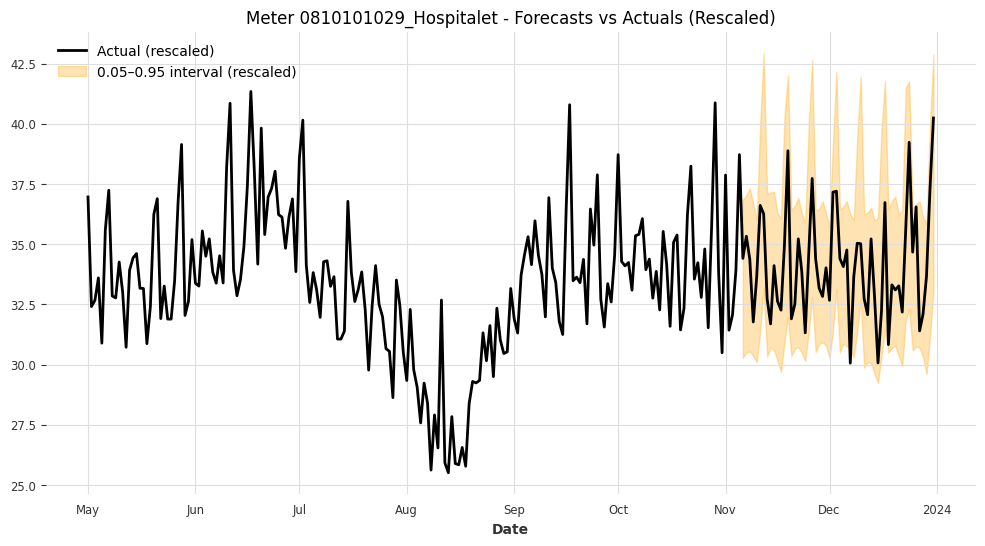

Meter 0810101029_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 6.9993



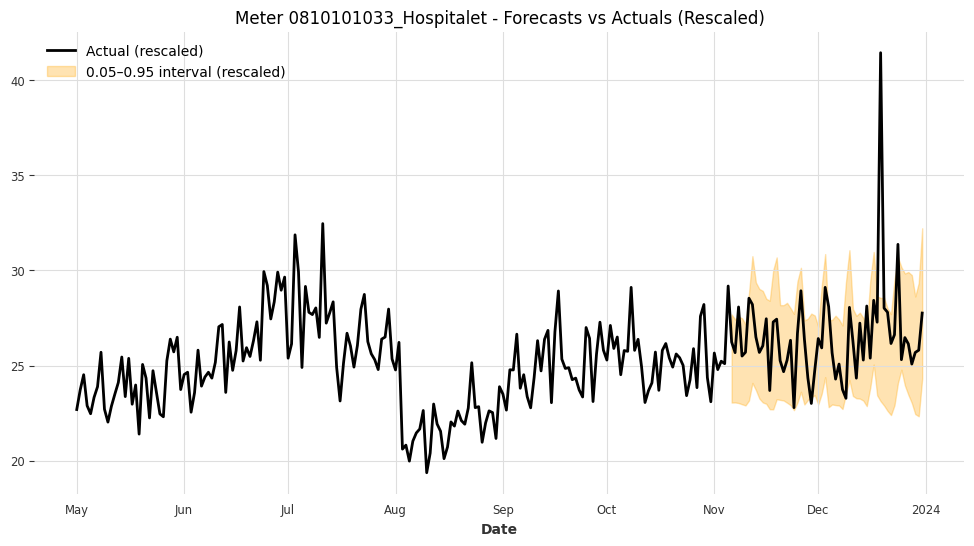

Meter 0810101033_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 5.4257



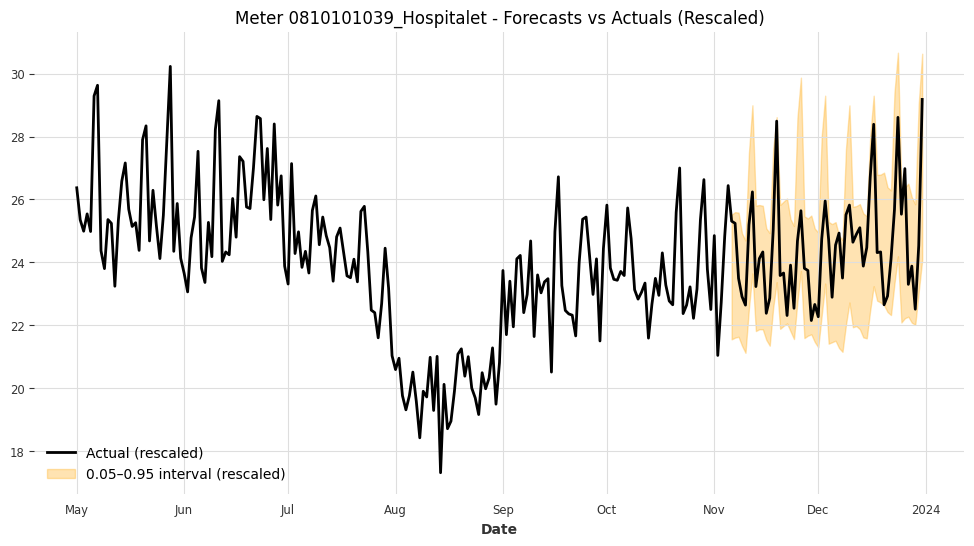

Meter 0810101039_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 4.4121



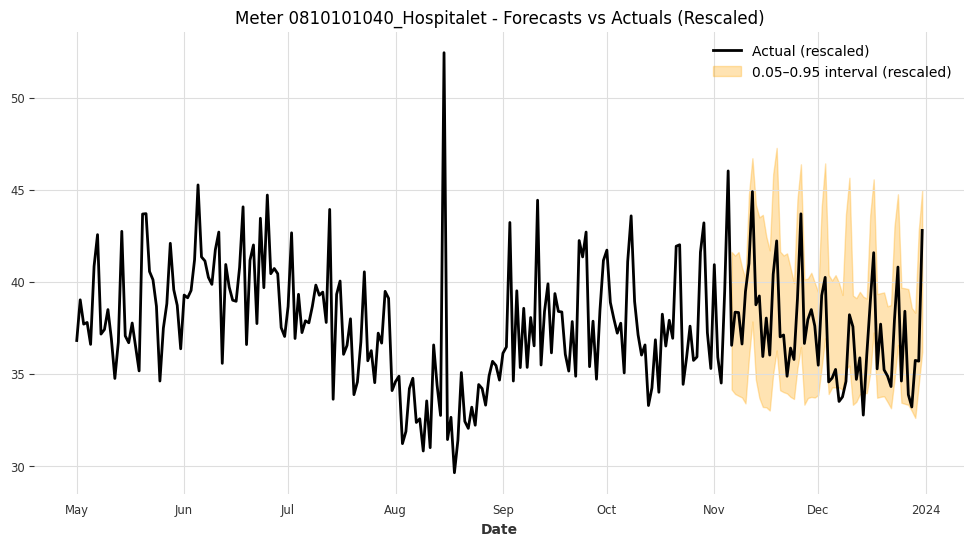

Meter 0810101040_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 7.3670



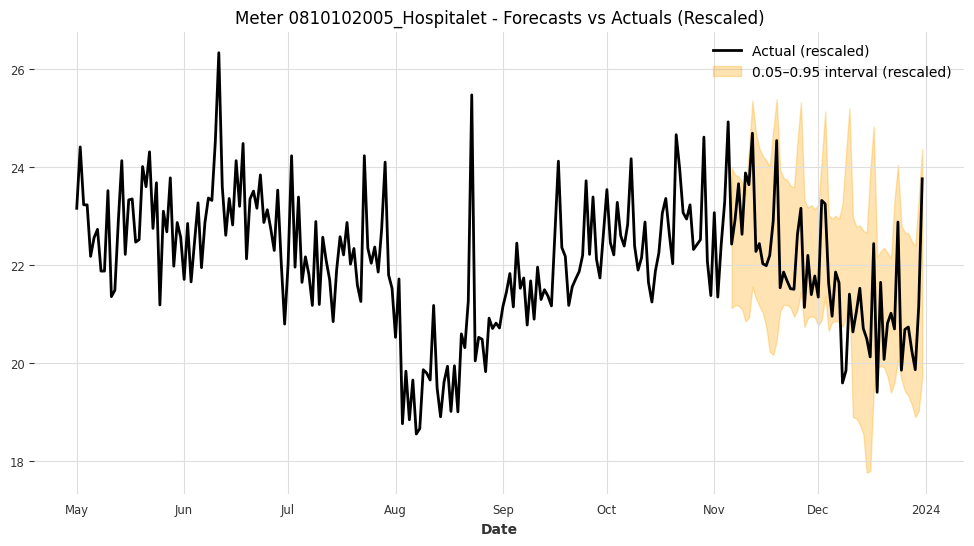

Meter 0810102005_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 3.2572



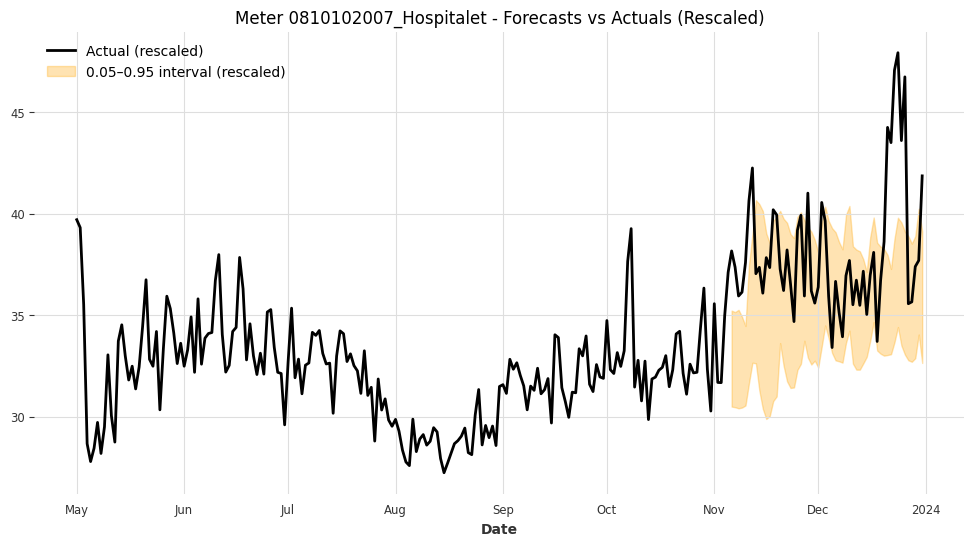

Meter 0810102007_Hospitalet - Coverage: 0.6607, Mean Interval Width (rescaled): 6.2265



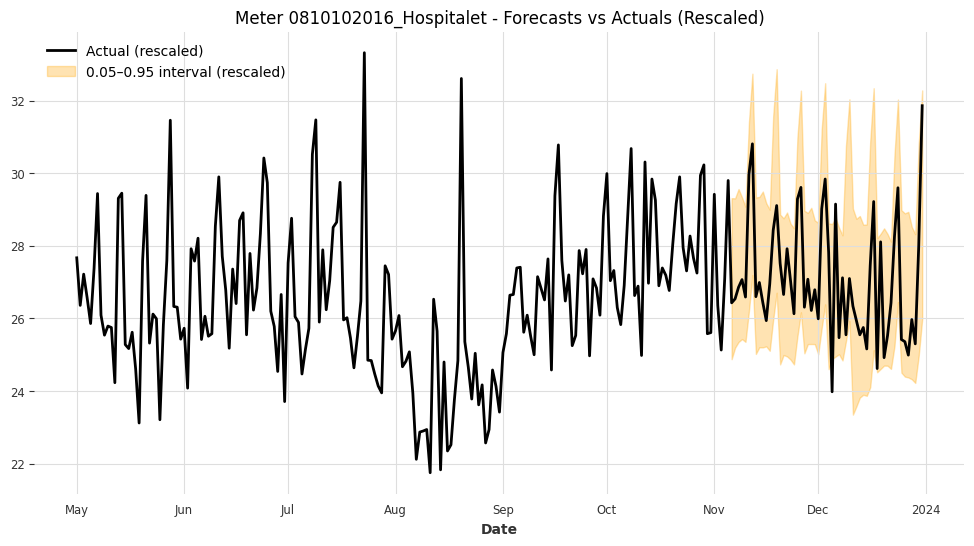

Meter 0810102016_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 4.5833



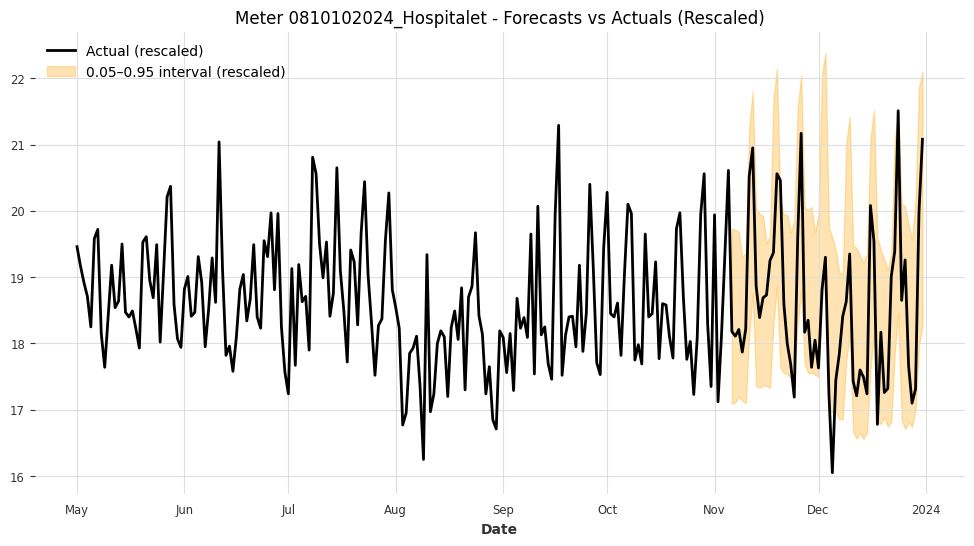

Meter 0810102024_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.7799



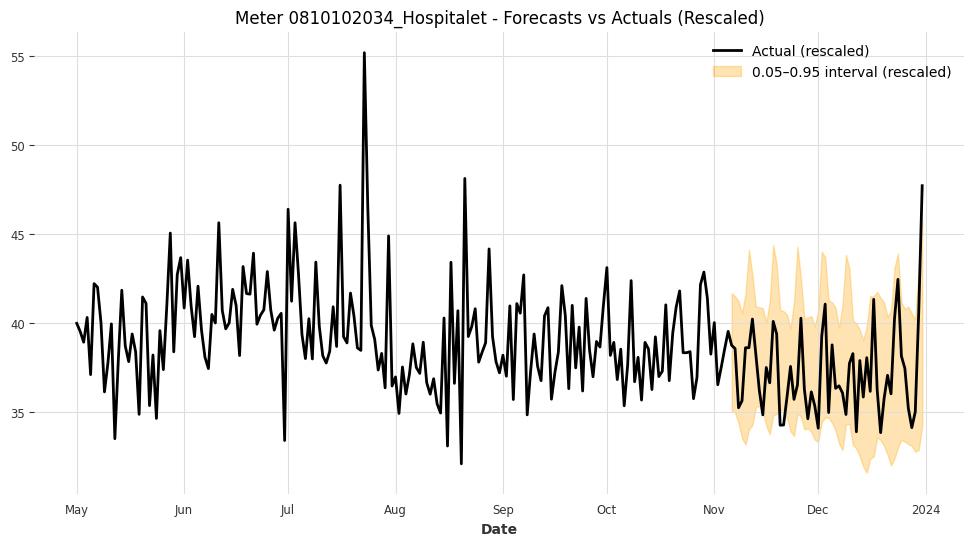

Meter 0810102034_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 7.6909



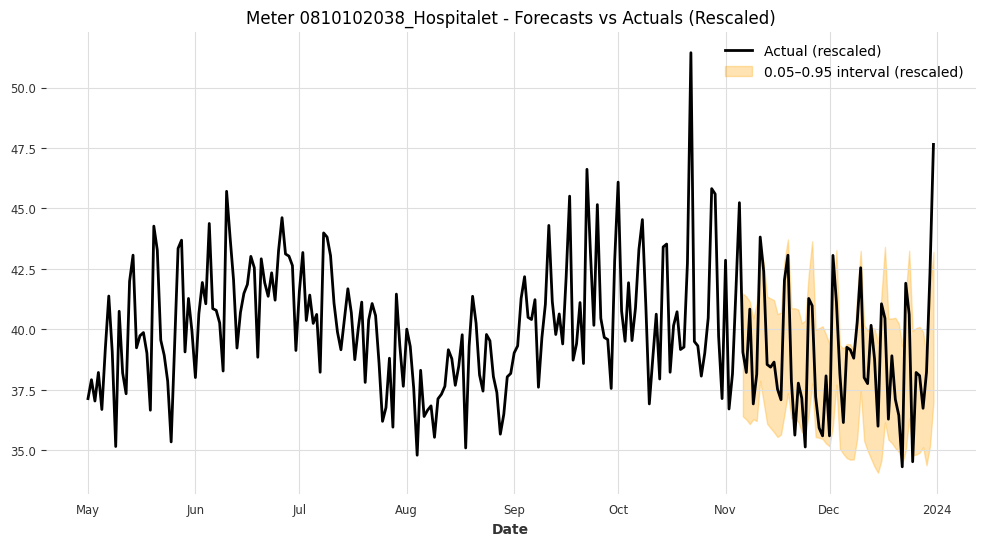

Meter 0810102038_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 5.2444



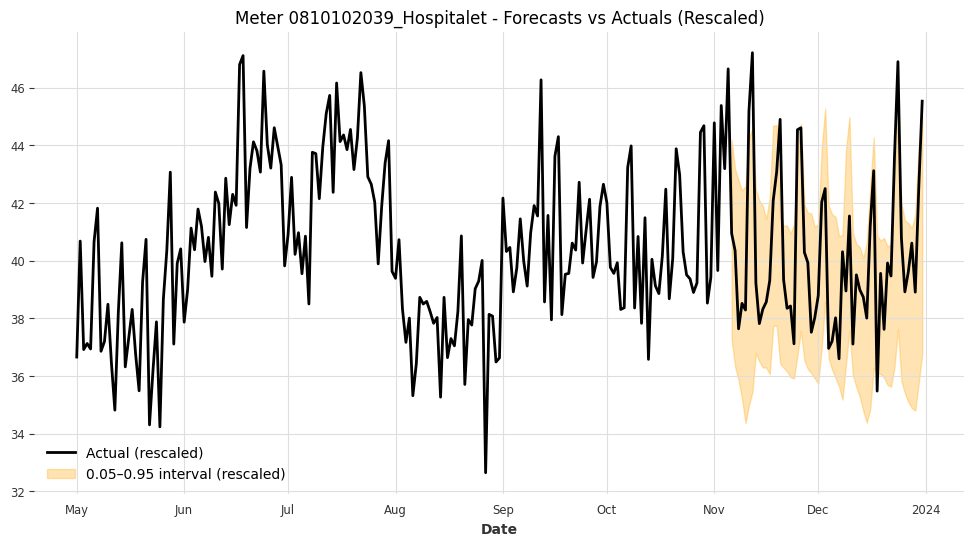

Meter 0810102039_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 6.1903



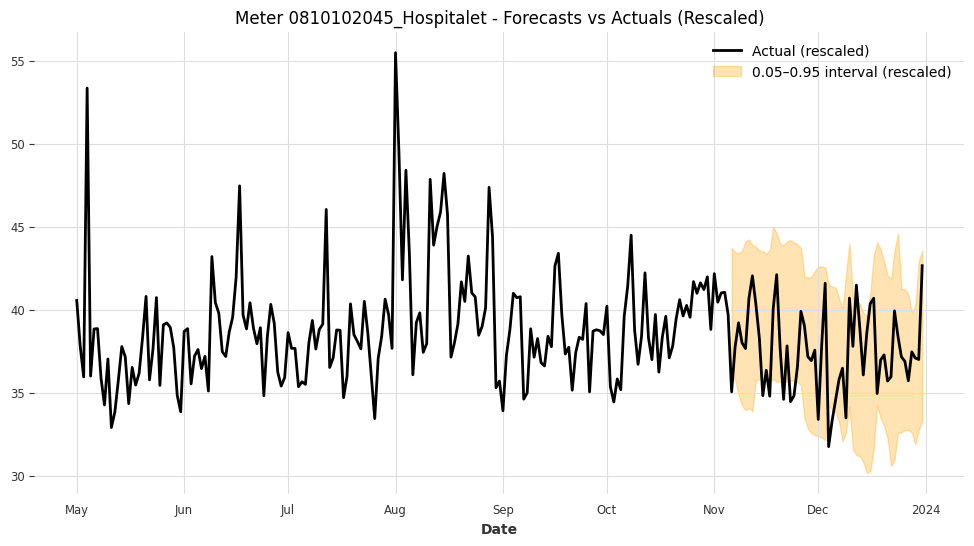

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 9.0896



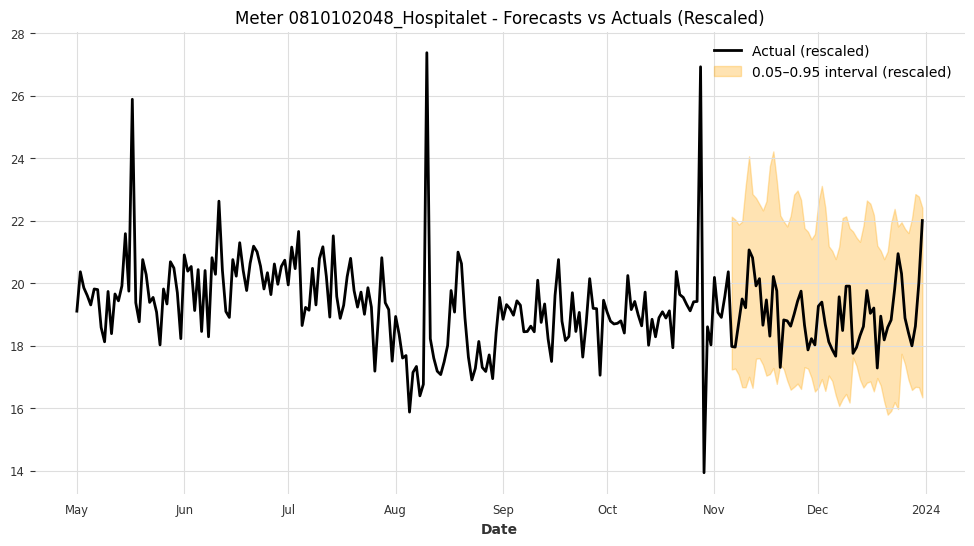

Meter 0810102048_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 5.3189



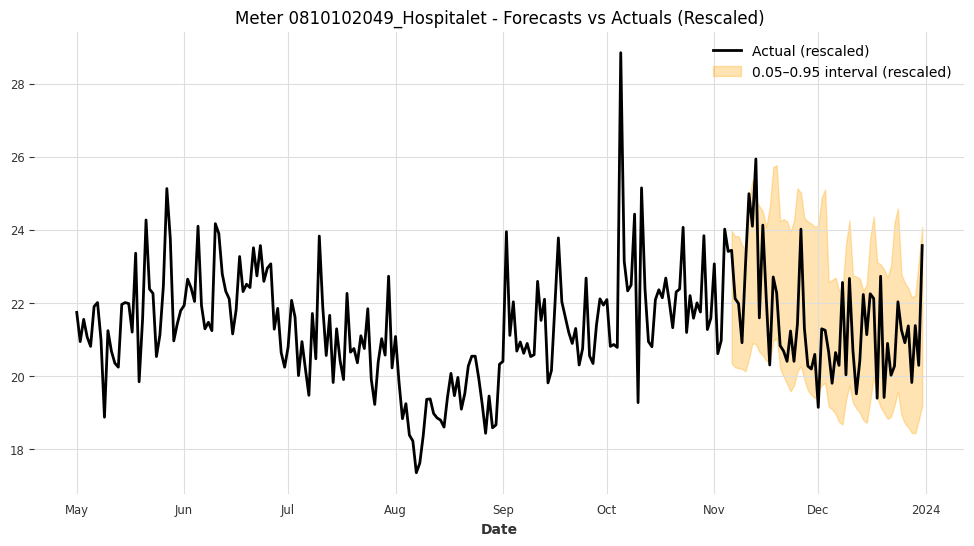

Meter 0810102049_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 4.1397



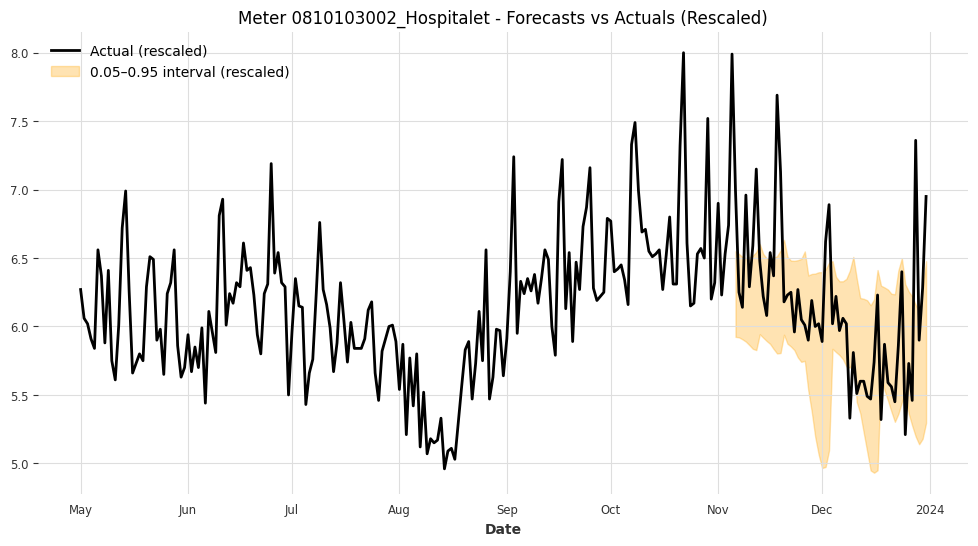

Meter 0810103002_Hospitalet - Coverage: 0.7321, Mean Interval Width (rescaled): 0.8512



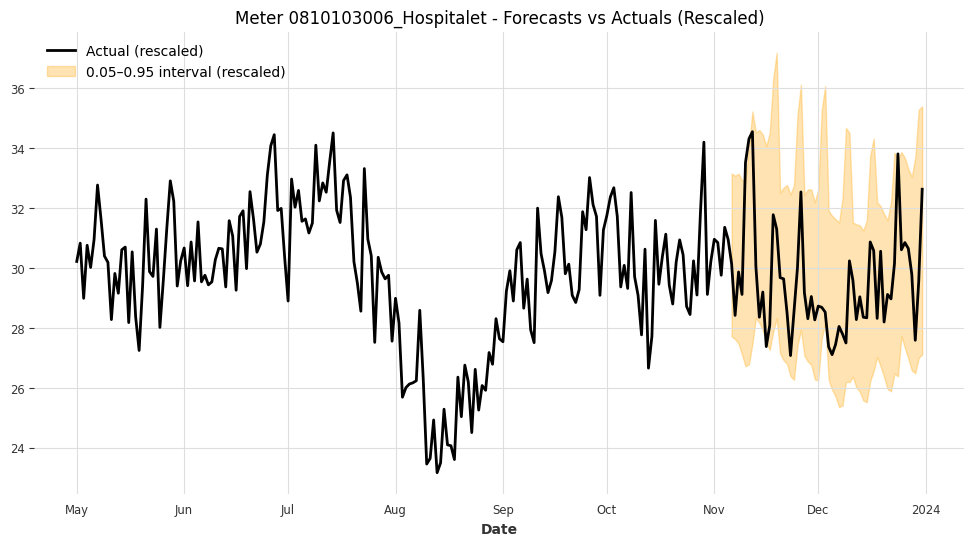

Meter 0810103006_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 6.5373



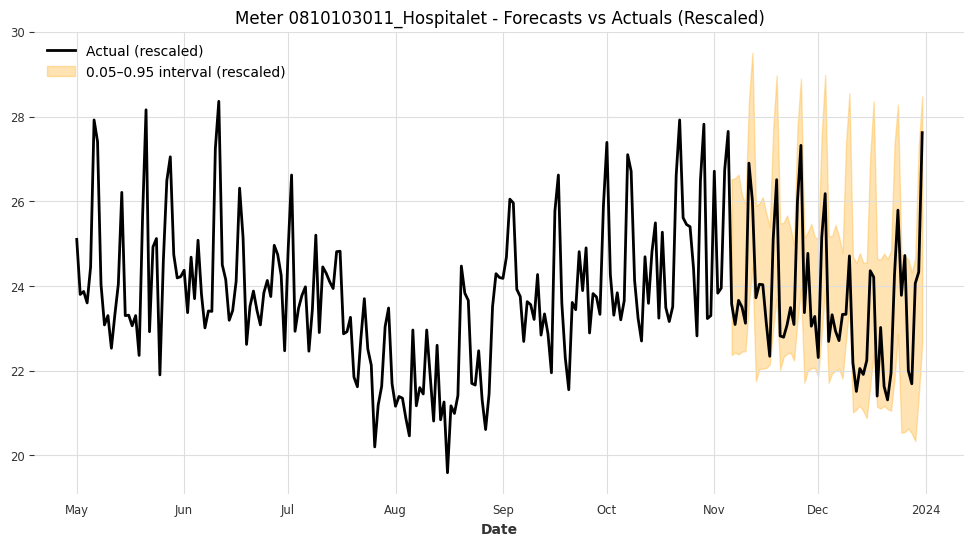

Meter 0810103011_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 4.0370



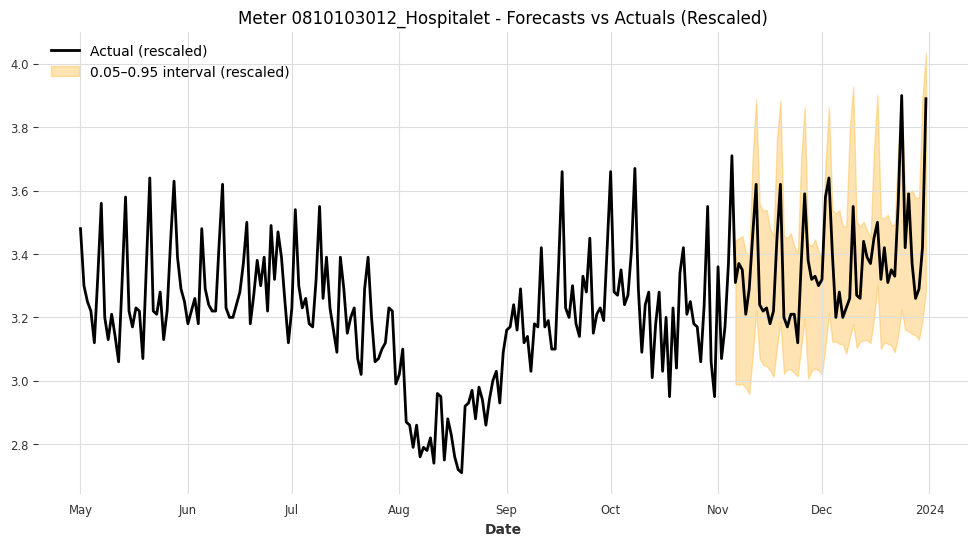

Meter 0810103012_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.4834



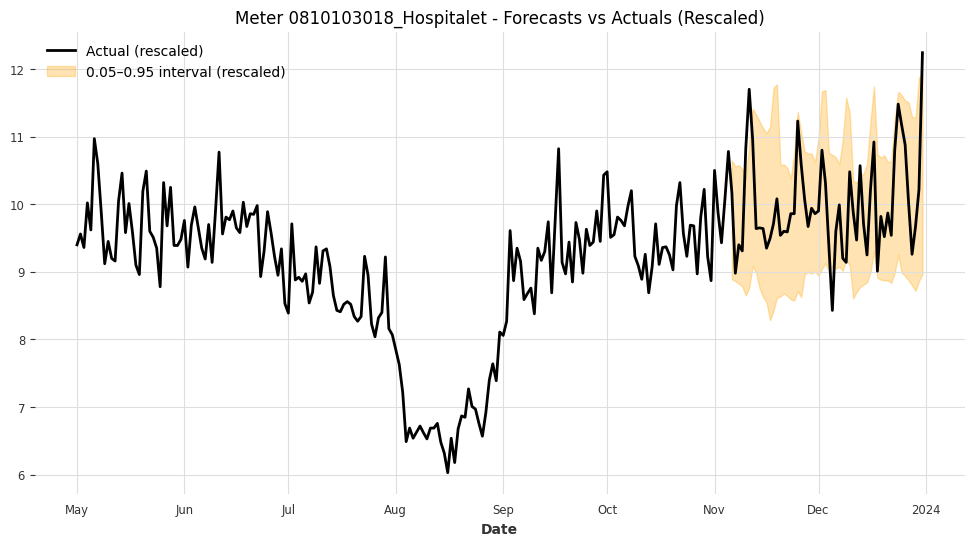

Meter 0810103018_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 2.1433



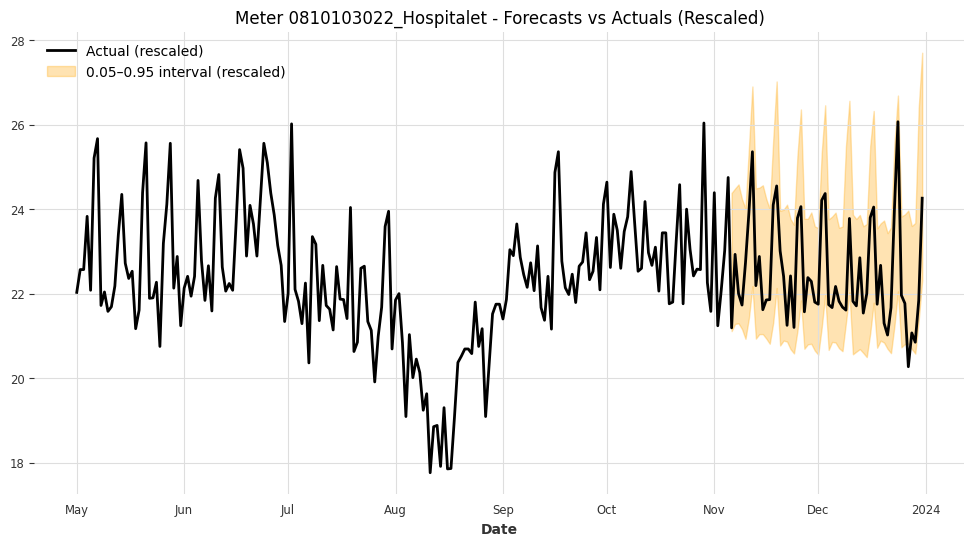

Meter 0810103022_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 3.5047



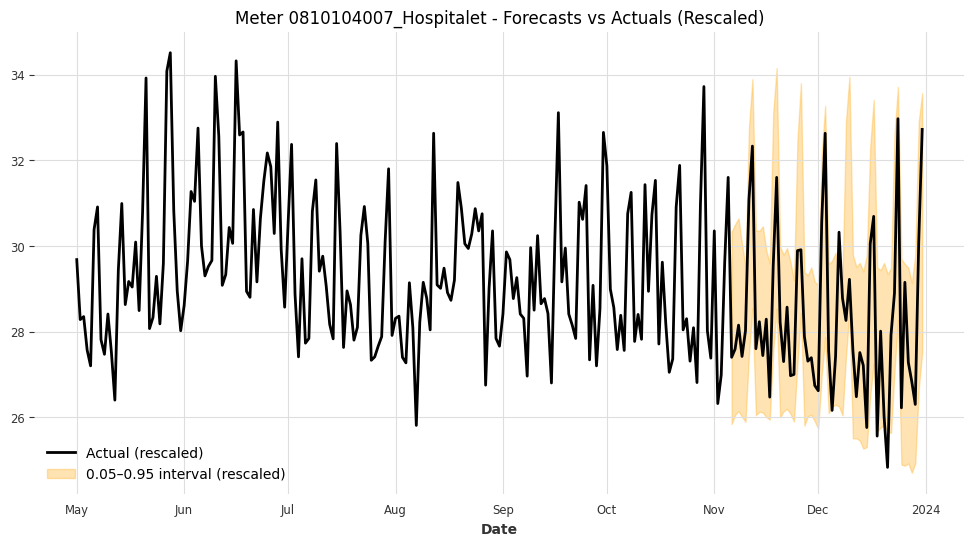

Meter 0810104007_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 4.3889



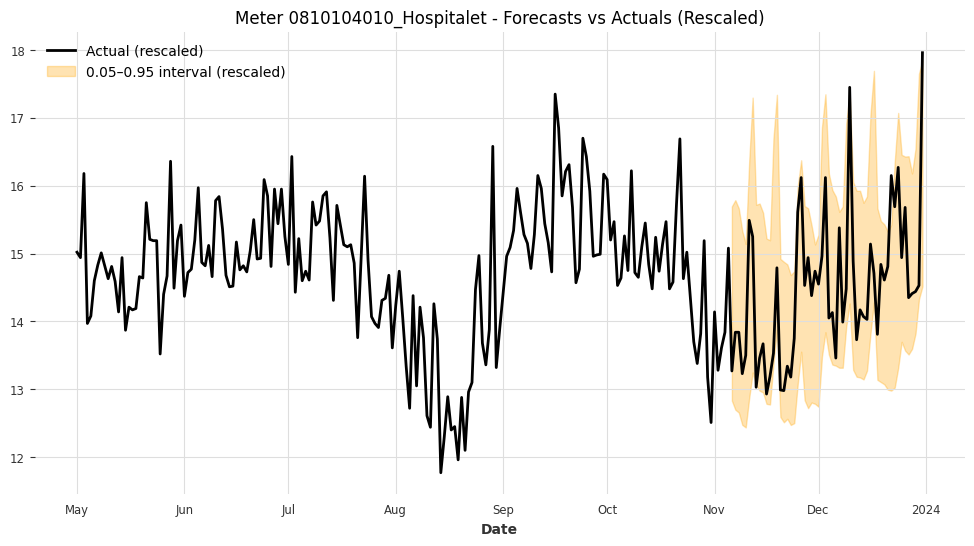

Meter 0810104010_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 2.8082



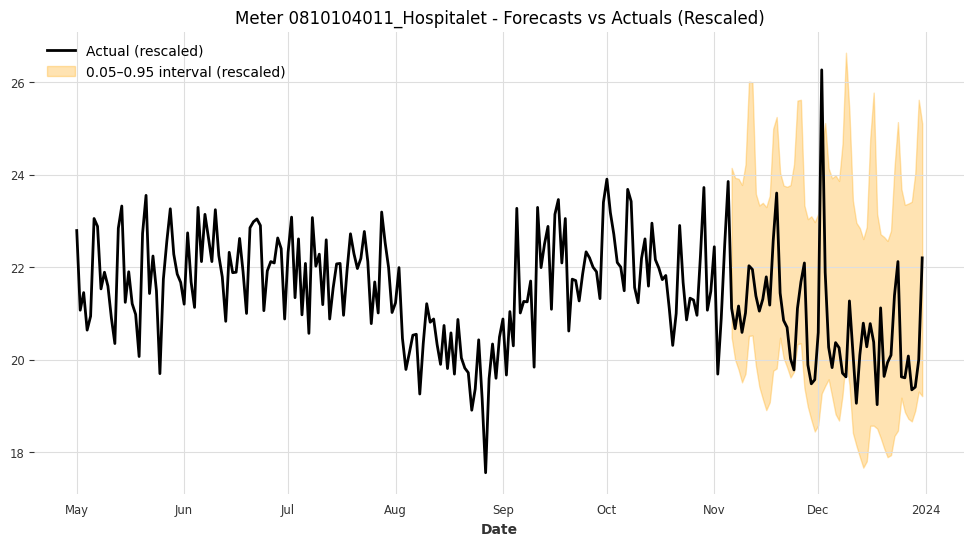

Meter 0810104011_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 4.8654



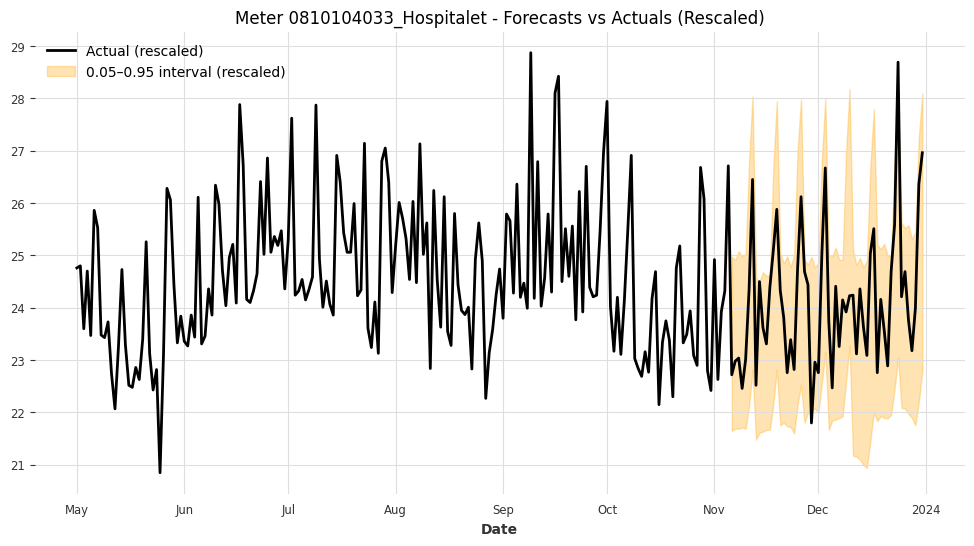

Meter 0810104033_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.7372



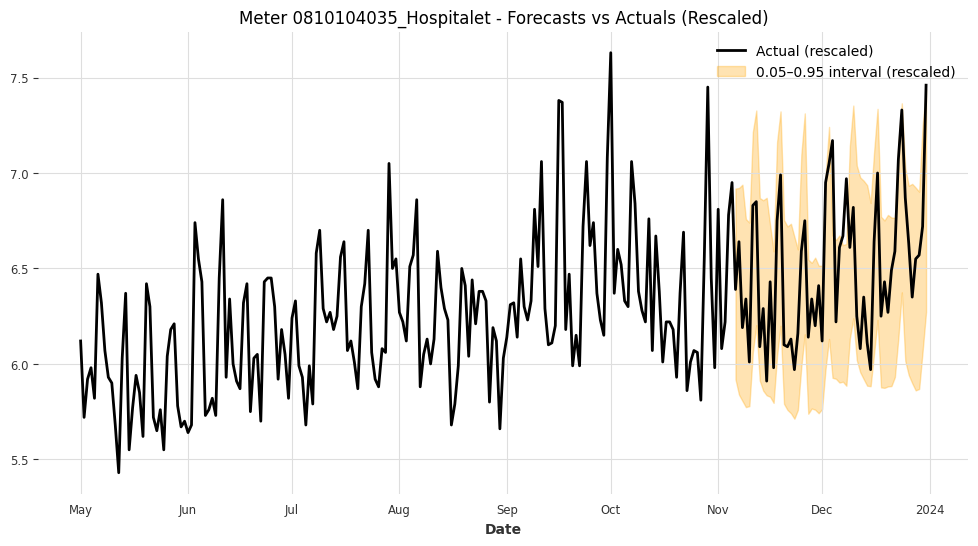

Meter 0810104035_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 0.9698



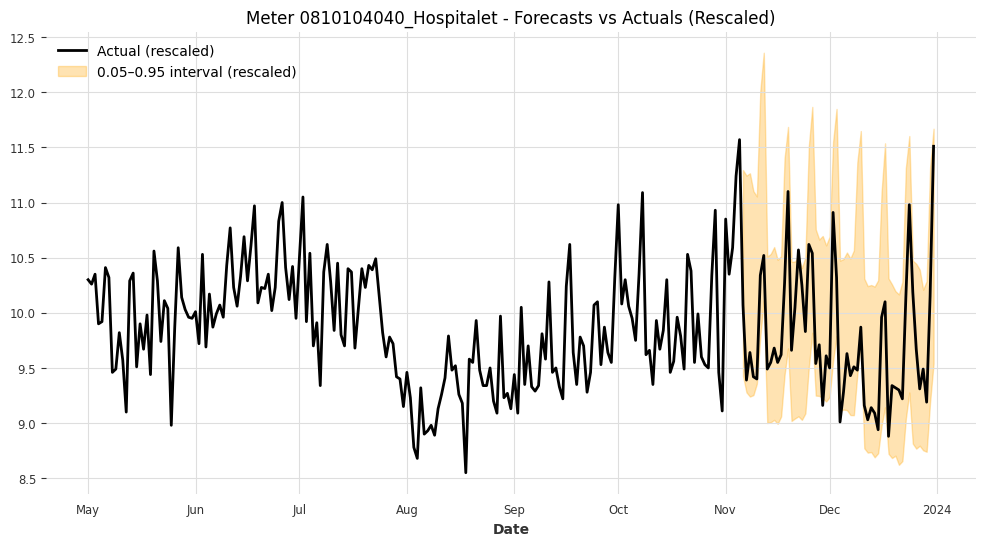

Meter 0810104040_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.7070



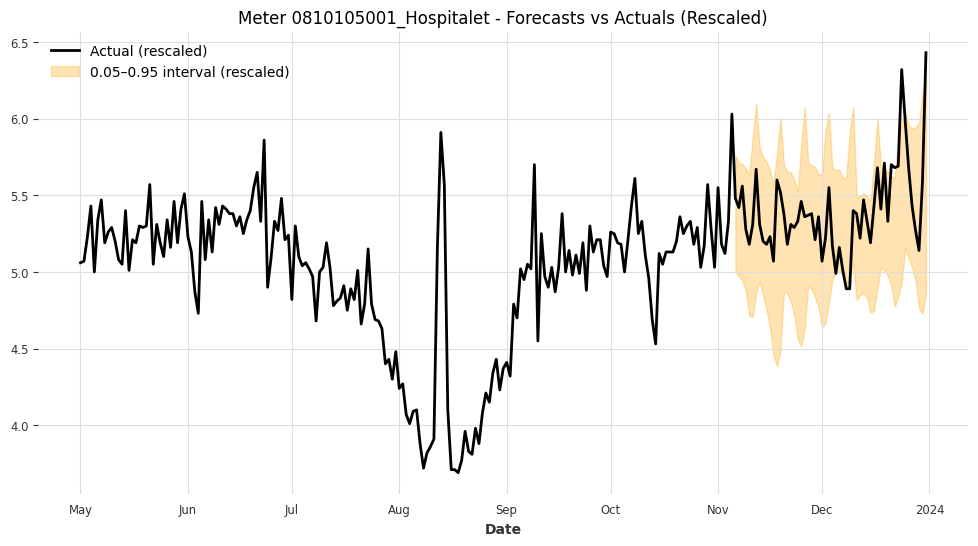

Meter 0810105001_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 0.9323



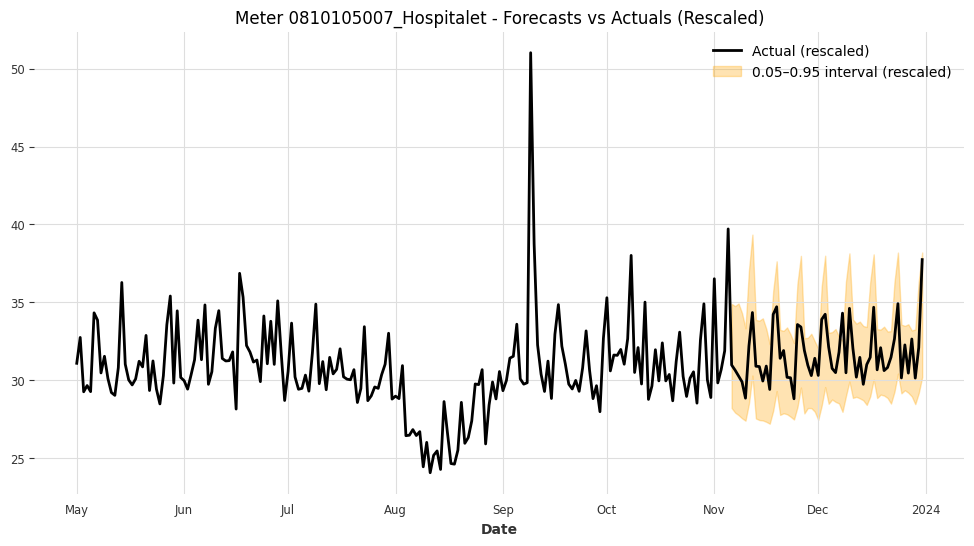

Meter 0810105007_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 5.9160



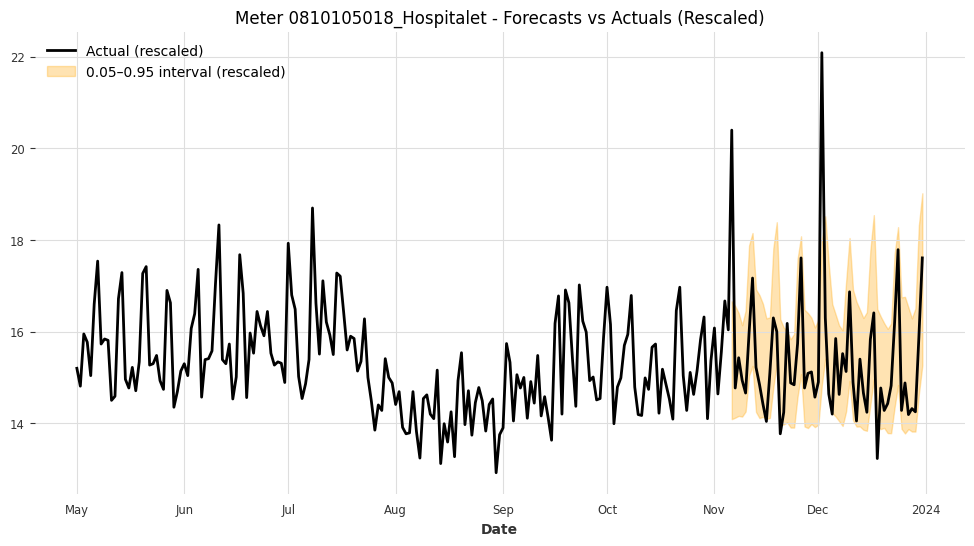

Meter 0810105018_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.6360



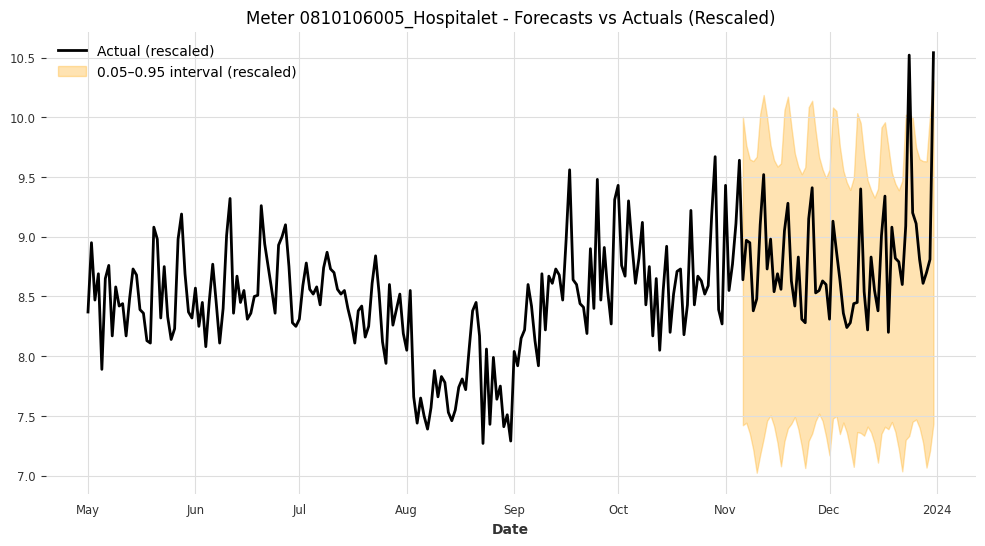

Meter 0810106005_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 2.4218



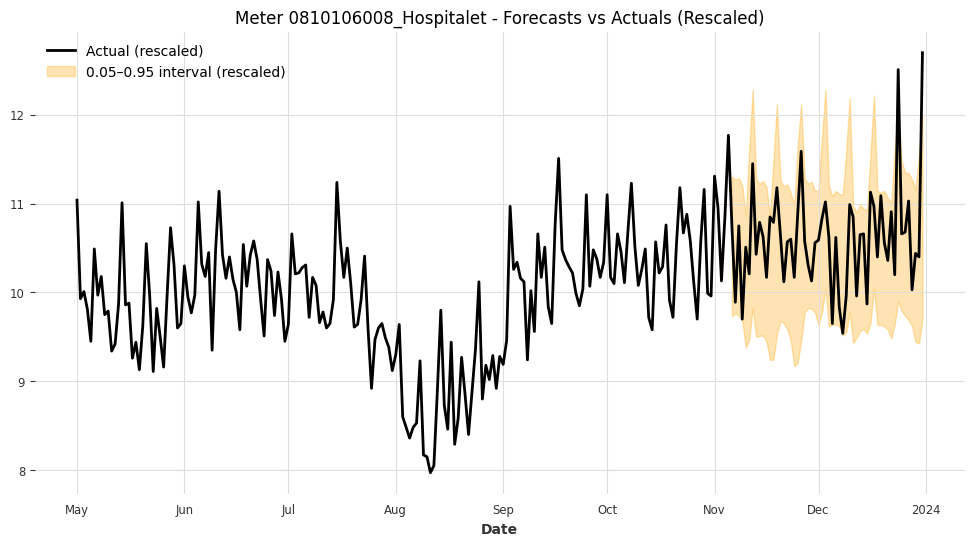

Meter 0810106008_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 1.7518



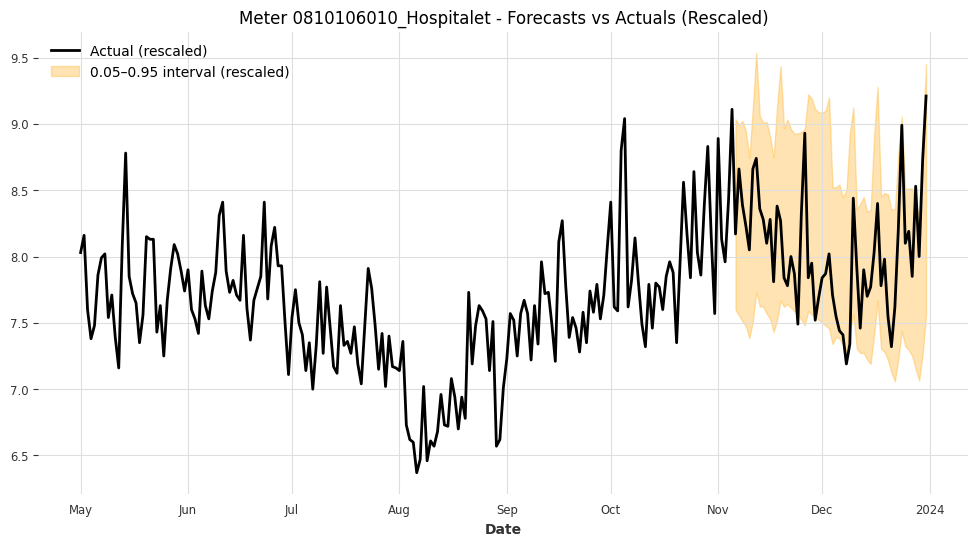

Meter 0810106010_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.4025



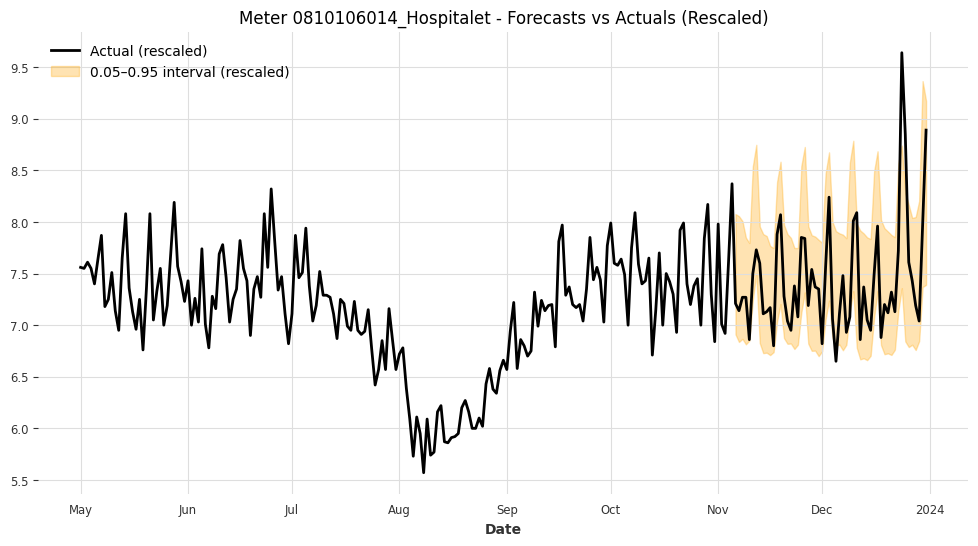

Meter 0810106014_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.2292



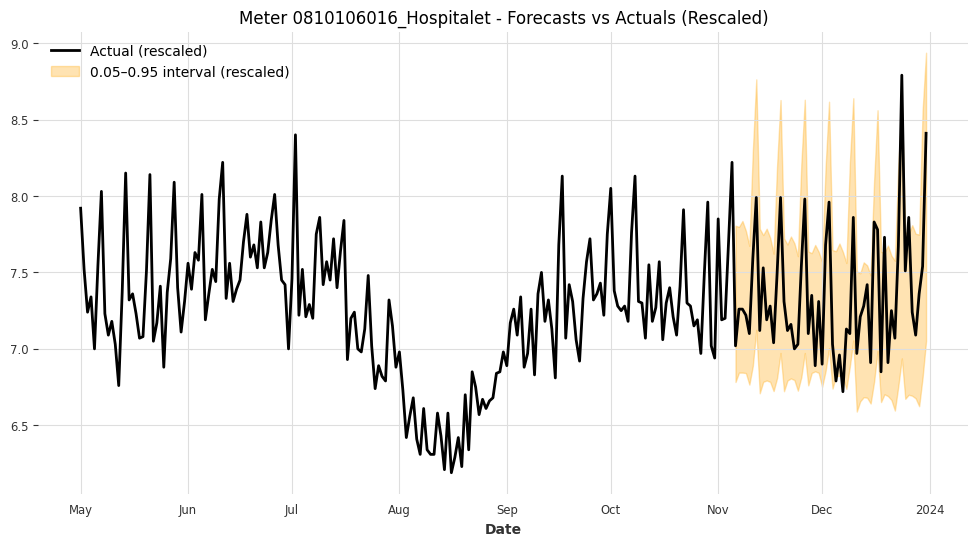

Meter 0810106016_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.1040



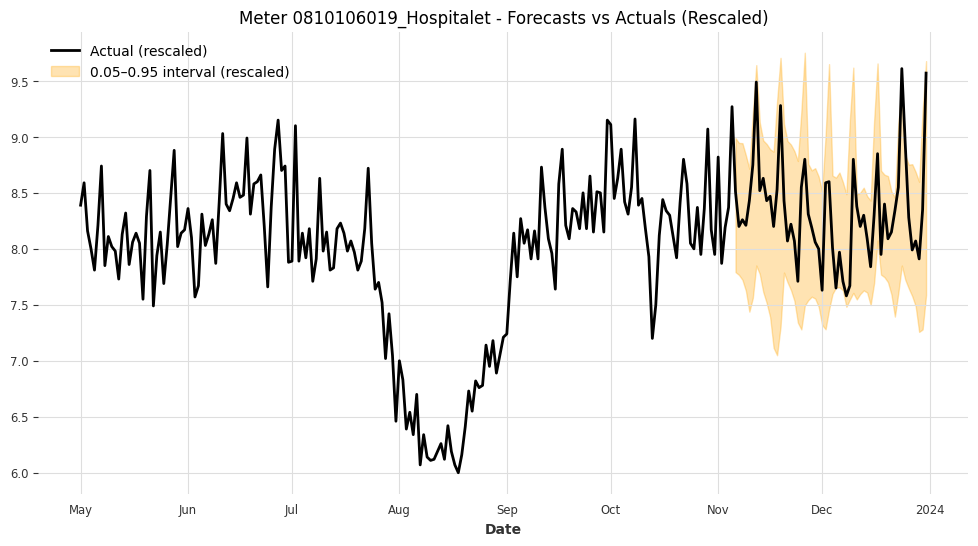

Meter 0810106019_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.3627



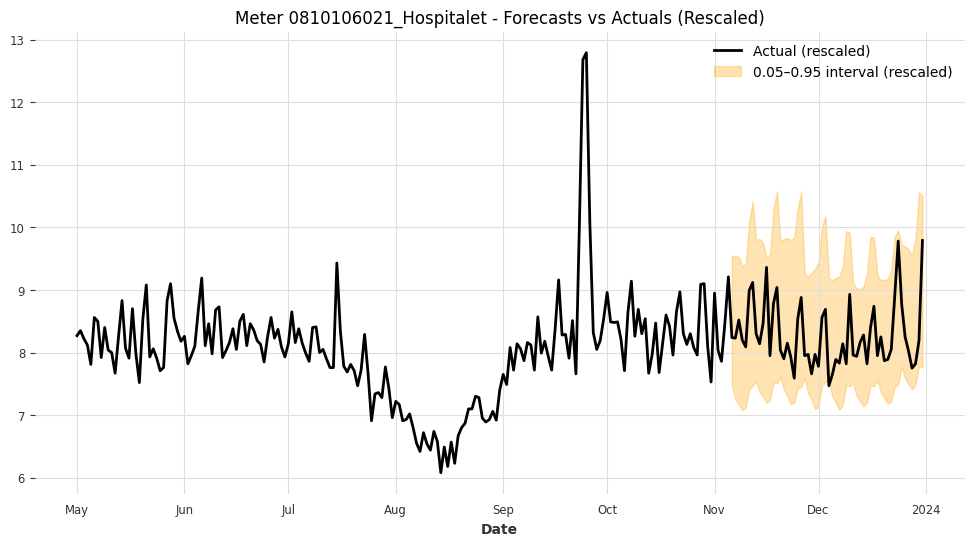

Meter 0810106021_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 2.2738



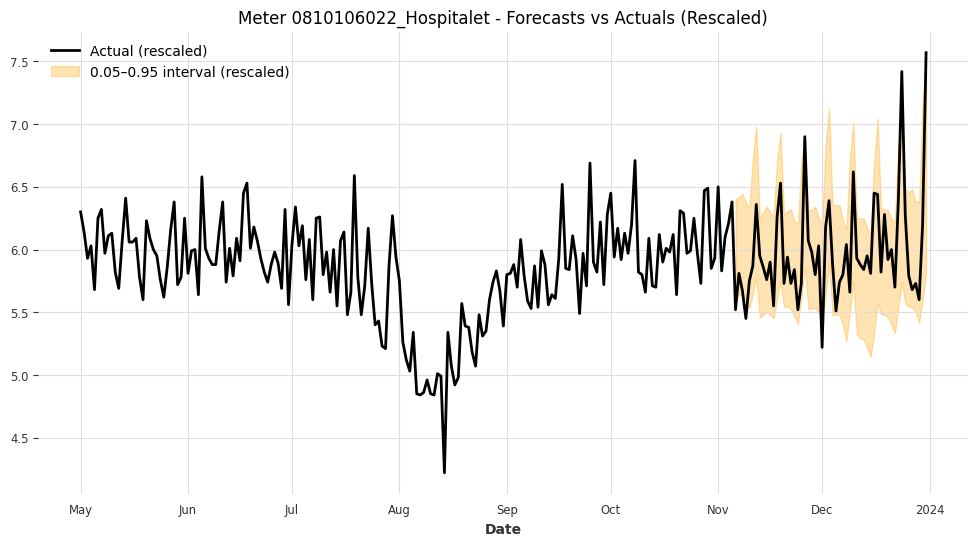

Meter 0810106022_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 0.9686



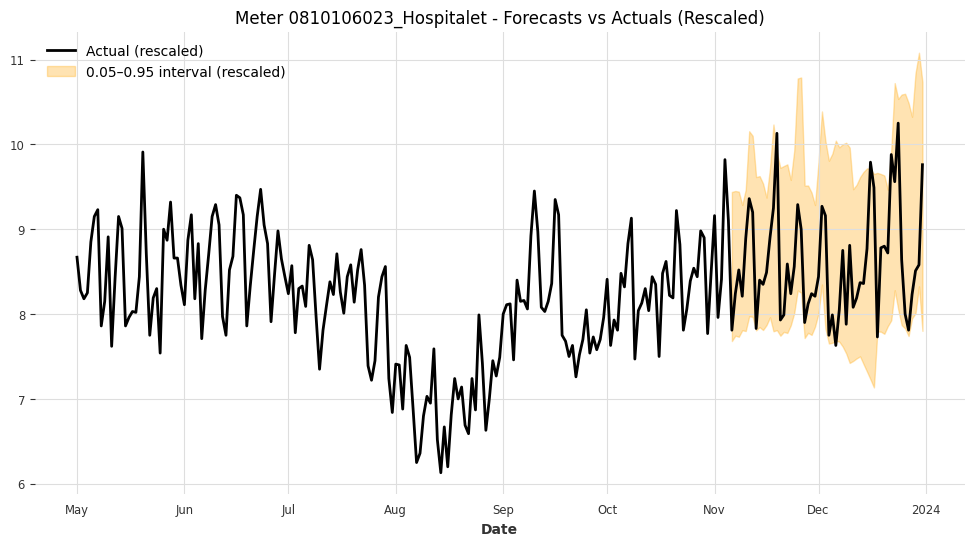

Meter 0810106023_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 2.1164



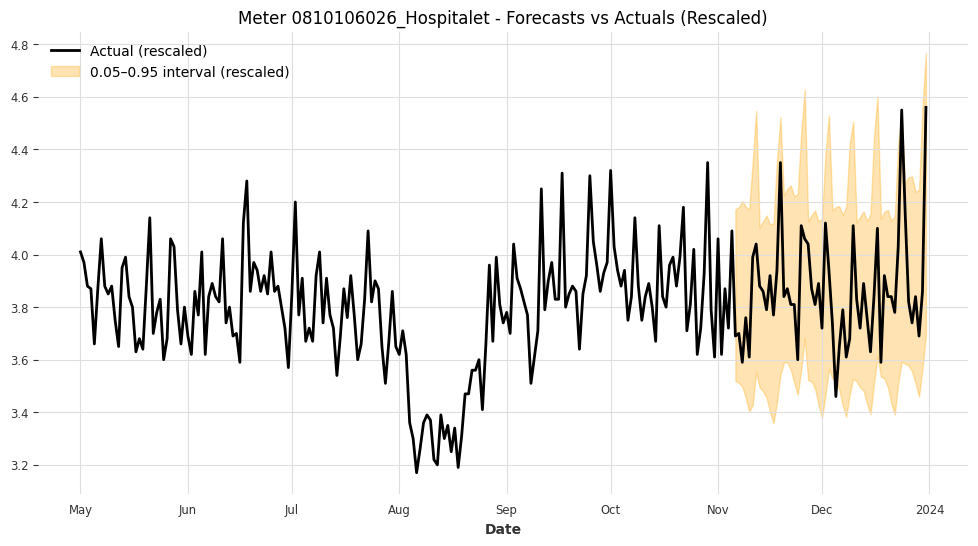

Meter 0810106026_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.7688



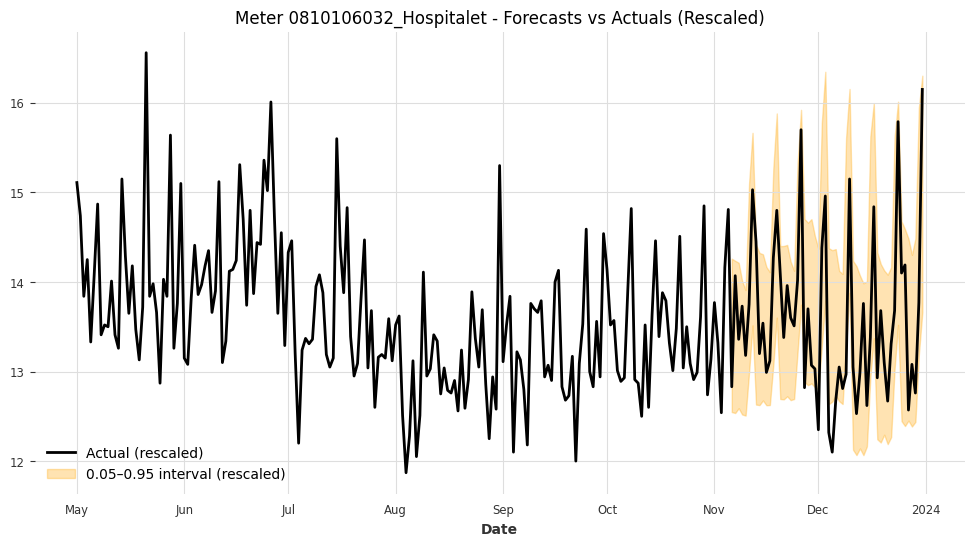

Meter 0810106032_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 1.9528



In [28]:
for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")
